In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [3]:
import os
import tensorflow as tf
import numpy as np
import glob

BASE_PATH = "/kaggle/input/dataset/new_data"

# Define folders for train, validation, and test
TRAIN_IMAGES_DIR = os.path.join(BASE_PATH, "train", "images")
TRAIN_MASKS_DIR = os.path.join(BASE_PATH, "train", "GT_TE")

VAL_IMAGES_DIR = os.path.join(BASE_PATH, "valid", "images")
VAL_MASKS_DIR = os.path.join(BASE_PATH, "valid", "GT_TE")

TEST_IMAGES_DIR = os.path.join(BASE_PATH, "test", "images")
TEST_MASKS_DIR = os.path.join(BASE_PATH, "test", "GT_TE")

# Check if files are loaded correctly
print("Train images:", len(os.listdir(TRAIN_IMAGES_DIR)))
print("Train masks:", len(os.listdir(TRAIN_MASKS_DIR)))
print("Validation images:", len(os.listdir(VAL_IMAGES_DIR)))
print("Validation masks:", len(os.listdir(VAL_MASKS_DIR)))
print("Test images:", len(os.listdir(TEST_IMAGES_DIR)))
print("Test masks:", len(os.listdir(TEST_MASKS_DIR)))


IMG_HEIGHT = 256
IMG_WIDTH = 256


def load_image(image_path, mask_path):
    """Load and preprocess a single image-mask pair"""
    # Load image
    image = tf.io.read_file(image_path)
    image = tf.image.decode_bmp(image, channels=3)  # decode as RGB
    image = tf.image.rgb_to_grayscale(image)        # convert to grayscale
    image = tf.image.resize(image, [IMG_HEIGHT, IMG_WIDTH])
    image = tf.cast(image, tf.float32) / 255.0

    # Load mask
    mask = tf.io.read_file(mask_path)
    mask = tf.image.decode_bmp(mask, channels=3)
    mask = tf.image.rgb_to_grayscale(mask)
    mask = tf.image.resize(mask, [IMG_HEIGHT, IMG_WIDTH])
    mask = tf.cast(mask, tf.float32) / 255.0
    mask = tf.where(mask > 0.5, 1.0, 0.0)  # binarize

    return image, mask


def create_dataset(image_dir, mask_dir, batch_size=8, shuffle=True):
    """Create tf.data dataset for training, validation, or testing"""
    image_paths = sorted(glob.glob(os.path.join(image_dir, "*.bmp")))
    mask_paths = sorted(glob.glob(os.path.join(mask_dir, "*.bmp")))

    print(f"Found {len(image_paths)} images and {len(mask_paths)} masks in {image_dir}")

    dataset = tf.data.Dataset.from_tensor_slices((image_paths, mask_paths))
    dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)

    if shuffle:
        dataset = dataset.shuffle(buffer_size=100)

    return dataset.batch(batch_size).prefetch(tf.data.AUTOTUNE)



BATCH_SIZE = 16
train_dataset = create_dataset(TRAIN_IMAGES_DIR, TRAIN_MASKS_DIR, batch_size=BATCH_SIZE)
val_dataset = create_dataset(VAL_IMAGES_DIR, VAL_MASKS_DIR, batch_size=BATCH_SIZE, shuffle=False)
test_dataset = create_dataset(TEST_IMAGES_DIR, TEST_MASKS_DIR, batch_size=1, shuffle=False)

2025-09-20 13:51:47.753427: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1758376307.974716      36 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1758376308.033647      36 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Train images: 995
Train masks: 995
Validation images: 25
Validation masks: 25
Test images: 25
Test masks: 25
Found 995 images and 995 masks in /kaggle/input/dataset/new_data/train/images


I0000 00:00:1758376321.636644      36 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0


Found 25 images and 25 masks in /kaggle/input/dataset/new_data/valid/images
Found 25 images and 25 masks in /kaggle/input/dataset/new_data/test/images


In [14]:
import tensorflow as tf
from tensorflow.keras import layers, Model

class ChannelAttentionBridge(layers.Layer):
    def __init__(self, c_list, split_att="fc", name="CAB", **kwargs):
        super(ChannelAttentionBridge, self).__init__(name=name, **kwargs)
        self.split_att = split_att
        self.c_list = c_list
        c_list_sum = sum(c_list)

        # Shared Conv1D for local info fusion
        self.conv1d = layers.Conv1D(1, kernel_size=3, padding="same", use_bias=False)

        # Fully connected per stage for global info fusion
        if split_att == "fc":
            self.fc_layers = [
                layers.Dense(c, activation="sigmoid") for c in c_list
            ]
        else:  # alternative: Conv1D
            self.fc_layers = [
                layers.Conv1D(c, kernel_size=1, activation="sigmoid")
                for c in c_list
            ]

    def call(self, features):
        # features = [t1, t2, t3, t4, t5]
        pooled = [tf.reduce_mean(f, axis=[1, 2], keepdims=True) for f in features]  # GAP
        pooled = [tf.squeeze(f, axis=[1, 2]) for f in pooled]  # (B, C)

        concat = tf.concat(pooled, axis=-1)  # (B, sum(C))

        # Local fusion with Conv1D
        concat_exp = tf.expand_dims(concat, axis=1)  # (B, 1, sumC)
        att = self.conv1d(concat_exp)  # (B, 1, 1)
        att = tf.squeeze(att, axis=1)  # (B, sumC)

        # Global fusion per stage
        out_features = []
        for i, (f, fc) in enumerate(zip(features, self.fc_layers)):
            att_i = fc(att)  # (B, Ci)
            att_i = tf.reshape(att_i, [-1, 1, 1, self.c_list[i]])
            att_i = tf.broadcast_to(att_i, tf.shape(f))
            out_features.append(f * att_i + f)  # apply attention + residual

        return out_features


In [15]:
class SpatialAttentionLayer(layers.Layer):
    def __init__(self, kernel_size=7, dilation_rate=3, **kwargs):
        super().__init__(**kwargs)
        self.kernel_size = kernel_size
        self.dilation_rate = dilation_rate
        self.conv = layers.Conv2D(
            1, kernel_size,
            padding="same",
            dilation_rate=dilation_rate,
            activation="sigmoid"
        )

    def call(self, x):
        avg_out = tf.reduce_mean(x, axis=-1, keepdims=True)
        max_out = tf.reduce_max(x, axis=-1, keepdims=True)
        concat = tf.concat([avg_out, max_out], axis=-1)
        attn = self.conv(concat)
        return x + x * attn

In [16]:
# ---------------- SC Attention Bridge (SAB + CAB) ----------------
class SCAttentionBridge(layers.Layer):
    def __init__(self, c_list, split_att="fc", name="SCAB", **kwargs):
        super().__init__(name=name, **kwargs)
        self.satt_layers = [SpatialAttentionLayer(name=f"SAB_{i}") for i in range(len(c_list))]
        self.catt = ChannelAttentionBridge(c_list, split_att=split_att)

    def call(self, features):
        # --- Save residuals ---
        residuals = features.copy()

        # --- Spatial Attention ---
        satt_features = [satt(f) * f for satt, f in zip(self.satt_layers, features)]
        satt_features = [f + r for f, r in zip(satt_features, residuals)]  # Residual connection

        # --- Channel Attention ---
        catt_features = self.catt(satt_features)
        out_features = [f * orig + f for f, orig in zip(catt_features, satt_features)]  # Residual again

        return out_features

In [17]:
import tensorflow as tf
from tensorflow.keras import layers, Model


# ---------------- U-Net with SC Attention Bridge ----------------
def unet_with_sc_attention(input_shape=(256, 256, 1)):
    inputs = layers.Input(input_shape, name="input_layer")

    # ----- Encoder -----
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name="enc_c1a")(inputs)
    c1 = layers.Conv2D(64, 3, activation='relu', padding='same', name="enc_c1b")(c1)
    p1 = layers.MaxPooling2D((2, 2), name="pool1")(c1)

    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name="enc_c2a")(p1)
    c2 = layers.Conv2D(128, 3, activation='relu', padding='same', name="enc_c2b")(c2)
    p2 = layers.MaxPooling2D((2, 2), name="pool2")(c2)

    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name="enc_c3a")(p2)
    c3 = layers.Conv2D(256, 3, activation='relu', padding='same', name="enc_c3b")(c3)
    p3 = layers.MaxPooling2D((2, 2), name="pool3")(c3)

    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name="enc_c4a")(p3)
    c4 = layers.Conv2D(512, 3, activation='relu', padding='same', name="enc_c4b")(c4)
    p4 = layers.MaxPooling2D((2, 2), name="pool4")(c4)

    # ----- Bottleneck -----
    bn = layers.Conv2D(1024, 3, activation='relu', padding='same', name="bottleneck1")(p4)
    bn = layers.Conv2D(1024, 3, activation='relu', padding='same', name="bottleneck2")(bn)

    # ----- SC Attention Bridge -----
    scab = SCAttentionBridge([64, 128, 256, 512, 1024])
    c1, c2, c3, c4, bn = scab([c1, c2, c3, c4, bn])

    # ----- Decoder -----
    def decoder_block(up_input, skip_input, name_prefix):
        up = layers.Conv2DTranspose(skip_input.shape[-1], 2, strides=2, padding='same', name=f"{name_prefix}_up")(up_input)
        concat = layers.concatenate([up, skip_input], axis=-1, name=f"{name_prefix}_concat")
        return concat

    u6 = decoder_block(bn, c4, "dec6")
    c6 = layers.Conv2D(512, 3, activation='relu', padding='same', name='dec_c6a')(u6)
    c6 = layers.Conv2D(512, 3, activation='relu', padding='same', name='dec_c6b')(c6)

    u7 = decoder_block(c6, c3, "dec7")
    c7 = layers.Conv2D(256, 3, activation='relu', padding='same', name='dec_c7a')(u7)
    c7 = layers.Conv2D(256, 3, activation='relu', padding='same', name='dec_c7b')(c7)

    u8 = decoder_block(c7, c2, "dec8")
    c8 = layers.Conv2D(128, 3, activation='relu', padding='same', name='dec_c8a')(u8)
    c8 = layers.Conv2D(128, 3, activation='relu', padding='same', name='dec_c8b')(c8)

    u9 = decoder_block(c8, c1, "dec9")
    c9 = layers.Conv2D(64, 3, activation='relu', padding='same', name='dec_c9a')(u9)
    c9 = layers.Conv2D(64, 3, activation='relu', padding='same', name='dec_c9b')(c9)

    outputs = layers.Conv2D(1, 1, activation='sigmoid', name='output_layer')(c9)

    return Model(inputs, outputs, name="UNet_with_SCAB")

# ---------------- Test ----------------
model = unet_with_sc_attention(input_shape=(256, 256, 1))
model.summary()


Model: "UNet_with_SCAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ SCAB                │ [(None, 256, 256, │     10,415 │ enc_c1b[0][0],    │
│ (SCAttentionBridge) │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 31,041,008 (118.41 MB)

 Trainable params: 31,041,008 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

In [19]:
def dice_coefficient(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

def iou_metric(y_true, y_pred, smooth=1e-6):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    union = tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

def bce_dice_loss(y_true, y_pred):
    bce = tf.keras.losses.BinaryCrossentropy()(y_true, y_pred)
    dice_loss = 1 - dice_coefficient(y_true, y_pred)
    return bce + dice_loss

In [20]:
# -------------------------
# Image loader
# -------------------------
def load_only_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_bmp(img, channels=3)   # decode as RGB
    img = tf.image.resize(img, [256, 256])
    img = tf.image.rgb_to_grayscale(img)         # convert to 1 channel
    img = tf.cast(img, tf.float32) / 255.0
    return img

def load_image(image_path, mask_path):
    img = load_only_image(image_path)
    mask = load_only_image(mask_path)
    return img, mask


In [21]:
import matplotlib.pyplot as plt
import time
from sklearn.model_selection import KFold
import numpy as np
import glob
import tensorflow as tf
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

In [22]:
from tensorflow.keras.callbacks import Callback

# -------------------------
# Attention map visualizer callback
# -------------------------
class AttentionMapLogger(Callback):
    def __init__(self, sample_image, every_n_epochs=5, save_dir="attention_maps"):
        super().__init__()
        self.sample_image = tf.expand_dims(sample_image, axis=0)  # add batch dim
        self.every_n_epochs = every_n_epochs
        self.save_dir = save_dir
        os.makedirs(save_dir, exist_ok=True)

    def save_attention_maps(self, feature_maps, stage_name, epoch):
        # feature_maps: tensor of shape (1, H, W, C)
        fmap = feature_maps[0]  # remove batch
        fmap_mean = tf.reduce_mean(fmap, axis=-1)  # collapse channels -> (H,W)
        fmap_min = tf.reduce_min(fmap_mean)
        fmap_max = tf.reduce_max(fmap_mean)
        fmap_norm = (fmap_mean - fmap_min) / (fmap_max - fmap_min + 1e-6)

        plt.figure(figsize=(5,5))
        plt.imshow(fmap_norm, cmap='jet')
        plt.axis('off')
        plt.title(f"{stage_name} Epoch {epoch}")
        plt.savefig(os.path.join(self.save_dir, f"{stage_name}_epoch{epoch}.png"))
        plt.close()
    def on_epoch_end(self, epoch, logs=None):
        if (epoch + 1) % self.every_n_epochs != 0:
            return

        # Run the model on the sample image and fetch attention maps
        # Assumes your model returns a list of attention feature maps as second output
        # Or that you have a model subclass which exposes encoder/decoder feature maps
        attention_features = self.model.get_attention_features(self.sample_image)  # custom function

        for i, fmap in enumerate(attention_features):
            stage_name = f"stage_{i+1}"
            self.save_attention_maps(fmap, stage_name, epoch + 1)






--- Fold 1 ---
Epoch 1/300


I0000 00:00:1758376393.365901      95 service.cc:148] XLA service 0x7f1348003c30 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1758376393.366967      95 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1758376394.843304      95 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1758376419.184017      95 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


 99/100 ━━━━━━━━━━━━━━━━━━━━ 0s 209ms/step - accuracy: 0.8742 - dice_coefficient: 0.1779 - iou_metric: 0.0978 - loss: 1.2762

E0000 00:00:1758376442.931794      93 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758376443.187762      93 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 383ms/step - accuracy: 0.8742 - dice_coefficient: 0.1781 - iou_metric: 0.0980 - loss: 1.2751

E0000 00:00:1758376469.422876      93 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758376469.656841      93 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758376470.277093      93 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.
E0000 00:00:1758376470.534058      93 gpu_timer.cc:82] Delay kernel timed out: measured time has sub-optimal accuracy. There may be a missing warmup execution, please investigate in Nsight Systems.


100/100 ━━━━━━━━━━━━━━━━━━━━ 98s 577ms/step - accuracy: 0.8741 - dice_coefficient: 0.1784 - iou_metric: 0.0981 - loss: 1.2739 - val_accuracy: 0.7701 - val_dice_coefficient: 0.4242 - val_iou_metric: 0.2701 - val_loss: 0.8176
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 239ms/step - accuracy: 0.7890 - dice_coefficient: 0.5166 - iou_metric: 0.3502 - loss: 0.7343 - val_accuracy: 0.8248 - val_dice_coefficient: 0.5897 - val_iou_metric: 0.4203 - val_loss: 0.6173
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8249 - dice_coefficient: 0.6178 - iou_metric: 0.4493 - loss: 0.5899 - val_accuracy: 0.8515 - val_dice_coefficient: 0.6405 - val_iou_metric: 0.4738 - val_loss: 0.5373
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accuracy: 0.8332 - dice_coefficient: 0.6756 - iou_metric: 0.5110 - loss: 0.5125 - val_accuracy: 0.8405 - val_dice_coefficient: 0.6631 - val_iou_metric: 0.4979 - val_loss: 0.4999
Epoch 5/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 212ms/step - accuracy: 0

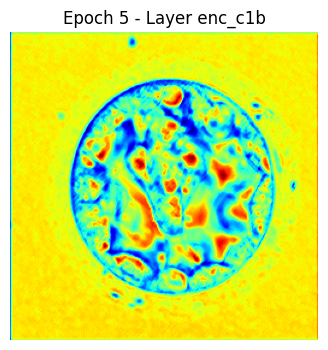

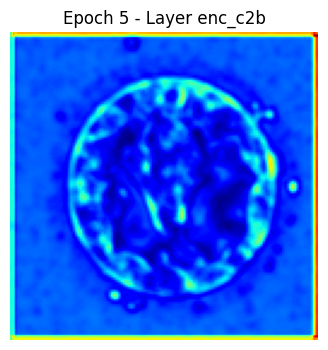

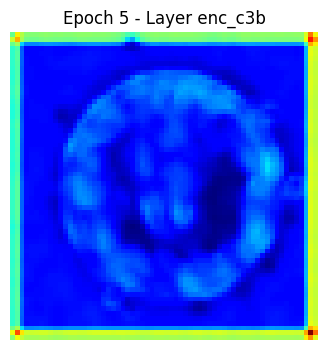

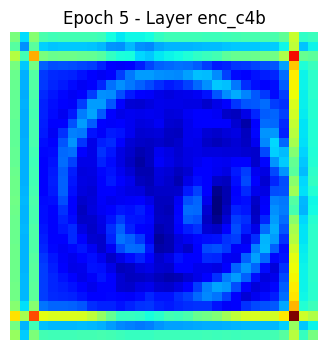

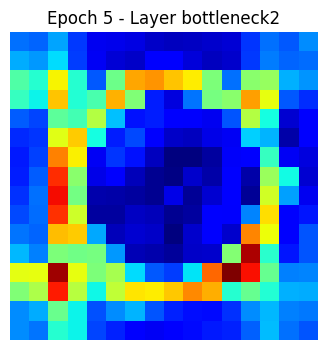

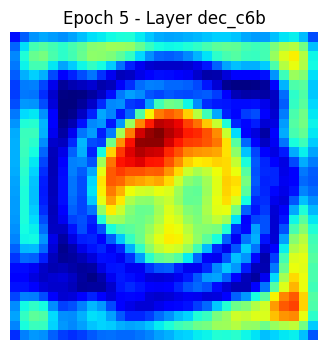

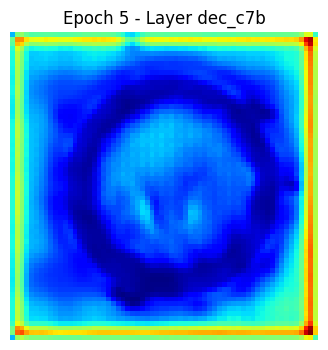

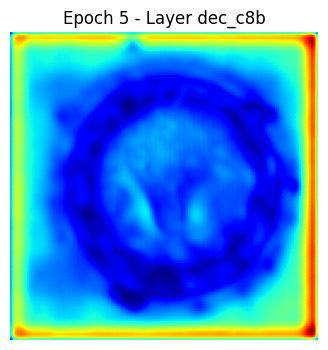

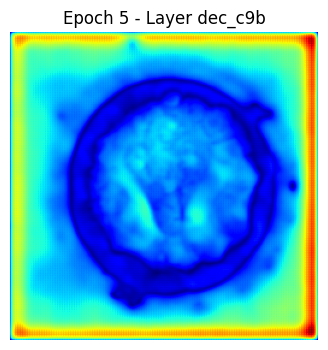

100/100 ━━━━━━━━━━━━━━━━━━━━ 26s 260ms/step - accuracy: 0.8371 - dice_coefficient: 0.6959 - iou_metric: 0.5348 - loss: 0.4793 - val_accuracy: 0.8566 - val_dice_coefficient: 0.6905 - val_iou_metric: 0.5295 - val_loss: 0.4602
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8450 - dice_coefficient: 0.7348 - iou_metric: 0.5816 - loss: 0.4180 - val_accuracy: 0.8568 - val_dice_coefficient: 0.7317 - val_iou_metric: 0.5796 - val_loss: 0.4131
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8475 - dice_coefficient: 0.7573 - iou_metric: 0.6103 - loss: 0.3842 - val_accuracy: 0.8594 - val_dice_coefficient: 0.7310 - val_iou_metric: 0.5786 - val_loss: 0.4036
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8498 - dice_coefficient: 0.7687 - iou_metric: 0.6252 - loss: 0.3673 - val_accuracy: 0.8637 - val_dice_coefficient: 0.7255 - val_iou_metric: 0.5717 - val_loss: 0.4066
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 242ms/step - accuracy: 

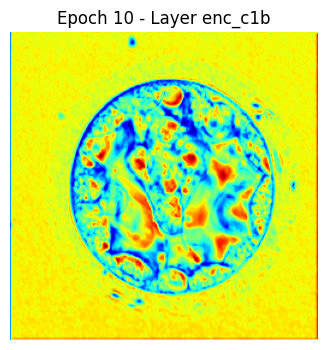

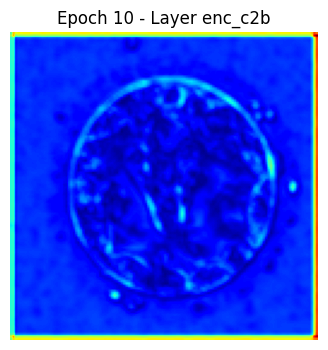

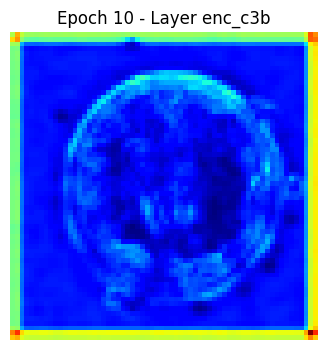

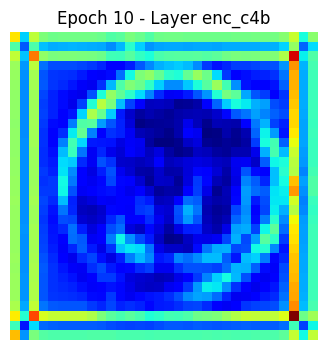

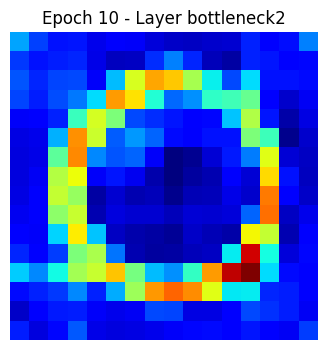

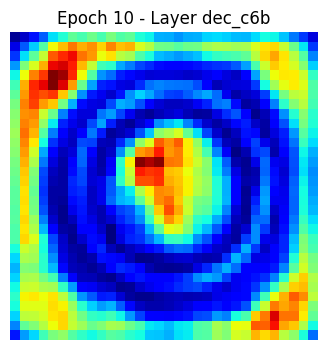

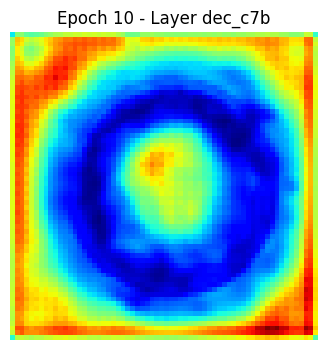

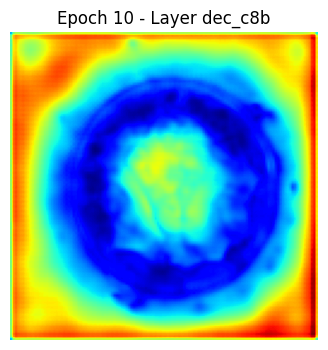

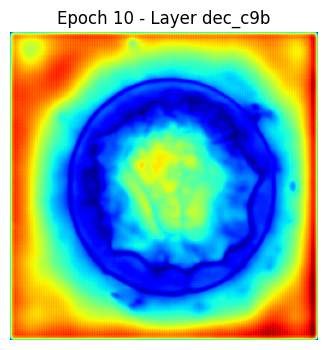

100/100 ━━━━━━━━━━━━━━━━━━━━ 25s 250ms/step - accuracy: 0.8530 - dice_coefficient: 0.7926 - iou_metric: 0.6572 - loss: 0.3305 - val_accuracy: 0.8625 - val_dice_coefficient: 0.7680 - val_iou_metric: 0.6266 - val_loss: 0.3713
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8553 - dice_coefficient: 0.8065 - iou_metric: 0.6766 - loss: 0.3080 - val_accuracy: 0.8611 - val_dice_coefficient: 0.7529 - val_iou_metric: 0.6065 - val_loss: 0.3659
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 242ms/step - accuracy: 0.8544 - dice_coefficient: 0.8023 - iou_metric: 0.6707 - loss: 0.3121 - val_accuracy: 0.8570 - val_dice_coefficient: 0.7741 - val_iou_metric: 0.6345 - val_loss: 0.3568
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8546 - dice_coefficient: 0.8204 - iou_metric: 0.6961 - loss: 0.2876 - val_accuracy: 0.8601 - val_dice_coefficient: 0.7701 - val_iou_metric: 0.6291 - val_loss: 0.3468
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accura

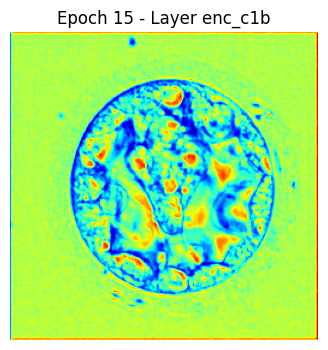

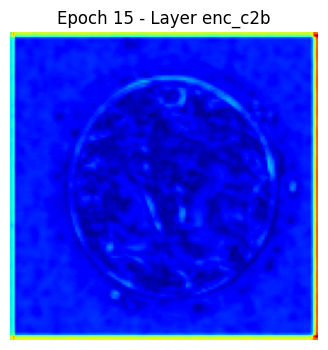

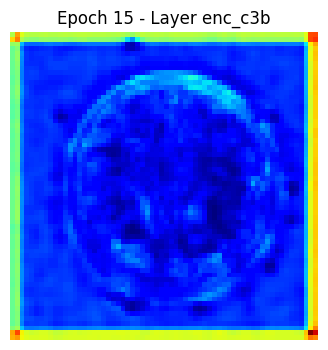

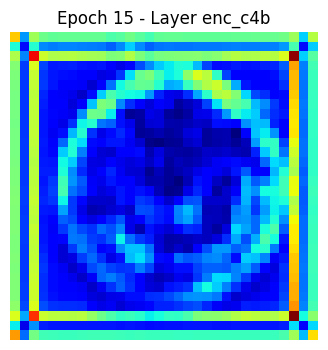

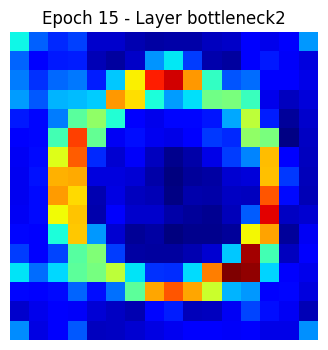

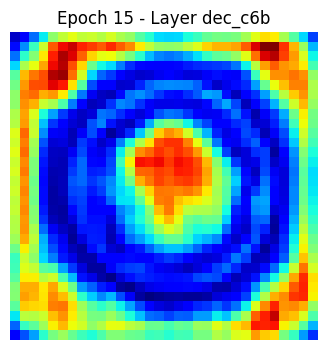

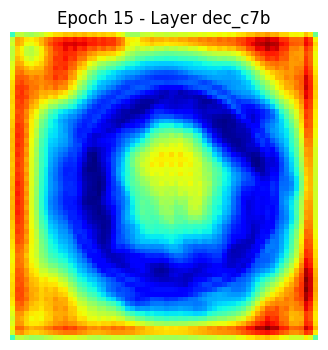

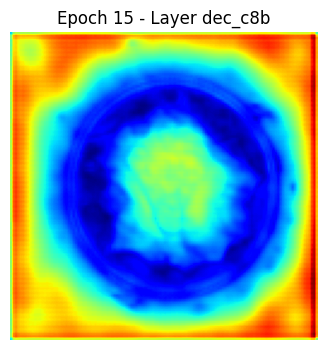

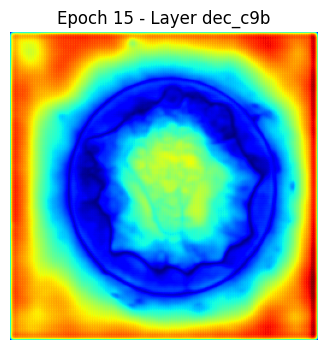

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8574 - dice_coefficient: 0.8379 - iou_metric: 0.7222 - loss: 0.2623 - val_accuracy: 0.8655 - val_dice_coefficient: 0.7868 - val_iou_metric: 0.6520 - val_loss: 0.3419
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8591 - dice_coefficient: 0.8396 - iou_metric: 0.7245 - loss: 0.2608 - val_accuracy: 0.8636 - val_dice_coefficient: 0.7944 - val_iou_metric: 0.6625 - val_loss: 0.3323
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accuracy: 0.8593 - dice_coefficient: 0.8453 - iou_metric: 0.7327 - loss: 0.2486 - val_accuracy: 0.8650 - val_dice_coefficient: 0.7948 - val_iou_metric: 0.6631 - val_loss: 0.3273
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 242ms/step - accuracy: 0.8598 - dice_coefficient: 0.8502 - iou_metric: 0.7403 - loss: 0.2428 - val_accuracy: 0.8626 - val_dice_coefficient: 0.8086 - val_iou_metric: 0.6823 - val_loss: 0.3141
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

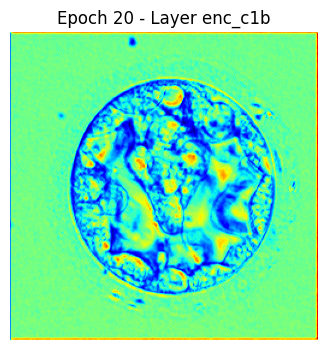

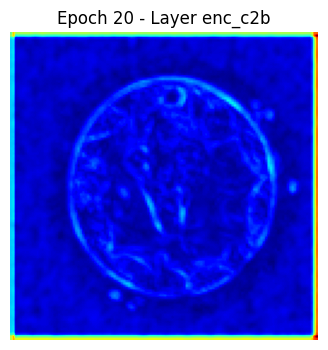

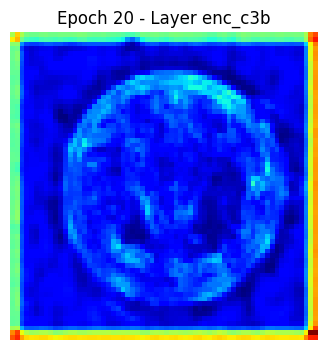

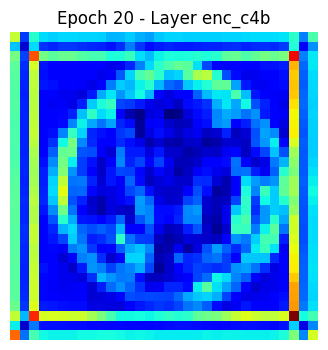

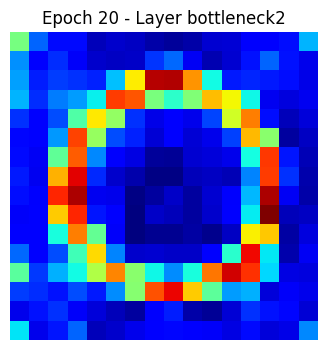

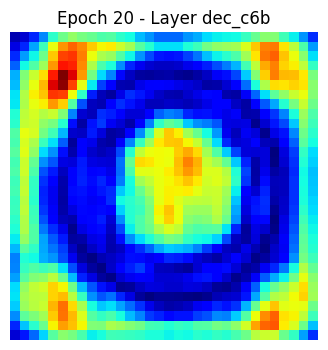

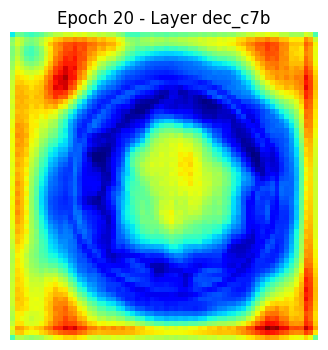

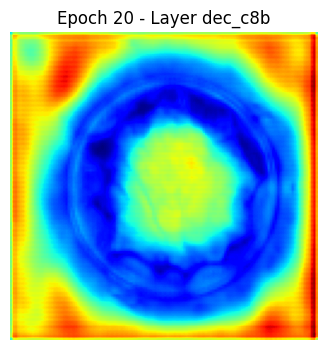

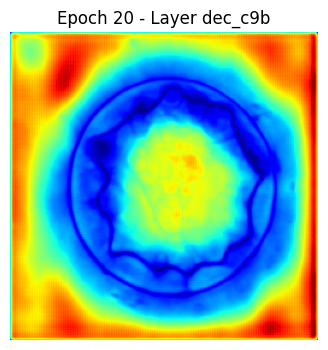

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8606 - dice_coefficient: 0.8592 - iou_metric: 0.7541 - loss: 0.2286 - val_accuracy: 0.8644 - val_dice_coefficient: 0.8009 - val_iou_metric: 0.6714 - val_loss: 0.3187
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8632 - dice_coefficient: 0.8679 - iou_metric: 0.7673 - loss: 0.2152 - val_accuracy: 0.8643 - val_dice_coefficient: 0.7943 - val_iou_metric: 0.6623 - val_loss: 0.3204
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8633 - dice_coefficient: 0.8758 - iou_metric: 0.7799 - loss: 0.2000 - val_accuracy: 0.8644 - val_dice_coefficient: 0.7863 - val_iou_metric: 0.6511 - val_loss: 0.3338
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8646 - dice_coefficient: 0.8745 - iou_metric: 0.7779 - loss: 0.1995 - val_accuracy: 0.8622 - val_dice_coefficient: 0.7955 - val_iou_metric: 0.6638 - val_loss: 0.3308
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

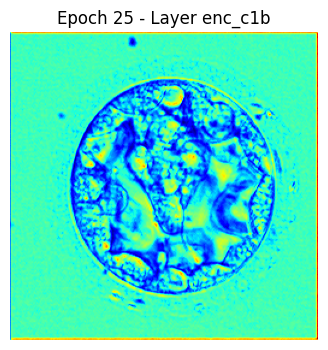

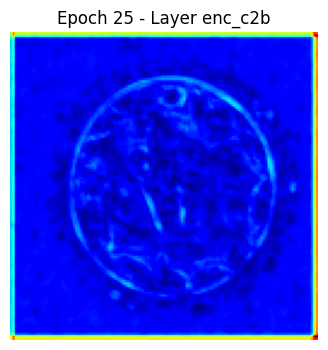

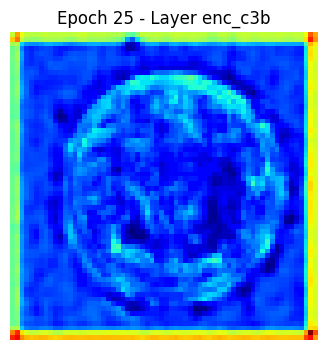

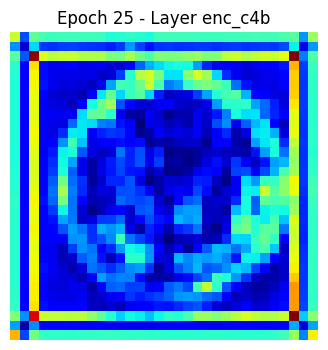

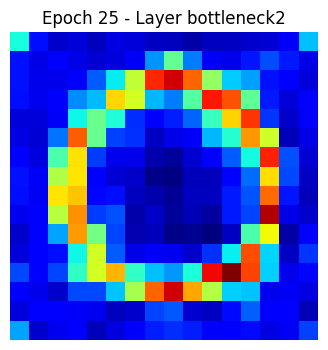

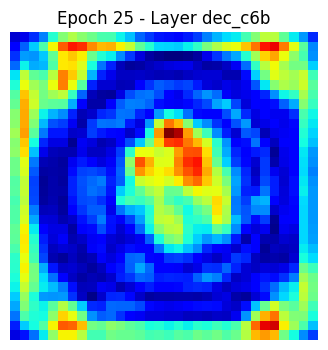

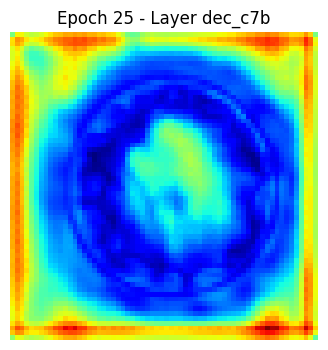

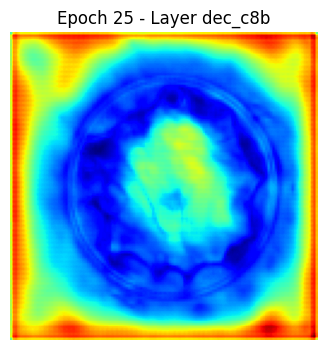

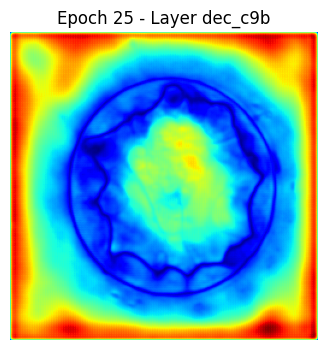

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8654 - dice_coefficient: 0.8814 - iou_metric: 0.7887 - loss: 0.1875 - val_accuracy: 0.8652 - val_dice_coefficient: 0.7953 - val_iou_metric: 0.6634 - val_loss: 0.3243
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8657 - dice_coefficient: 0.8908 - iou_metric: 0.8036 - loss: 0.1740 - val_accuracy: 0.8636 - val_dice_coefficient: 0.7734 - val_iou_metric: 0.6333 - val_loss: 0.3664
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8669 - dice_coefficient: 0.8860 - iou_metric: 0.7962 - loss: 0.1793 - val_accuracy: 0.8662 - val_dice_coefficient: 0.7795 - val_iou_metric: 0.6418 - val_loss: 0.3441
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8673 - dice_coefficient: 0.8992 - iou_metric: 0.8175 - loss: 0.1609 - val_accuracy: 0.8614 - val_dice_coefficient: 0.7923 - val_iou_metric: 0.6587 - val_loss: 0.3412


Model: "UNet_with_SCAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ SCAB                │ [(None, 256, 256, │     10,415 │ enc_c1b[0][0],    │
│ (SCAttentionBridge) │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,123,026 (355.24 MB)

 Trainable params: 31,041,008 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,082,018 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 1: 737.77s

--- Fold 2 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 56s 339ms/step - accuracy: 0.8718 - dice_coefficient: 0.1940 - iou_metric: 0.1093 - loss: 1.2497 - val_accuracy: 0.8436 - val_dice_coefficient: 0.4212 - val_iou_metric: 0.2673 - val_loss: 0.7852
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8167 - dice_coefficient: 0.5302 - iou_metric: 0.3643 - loss: 0.6867 - val_accuracy: 0.8414 - val_dice_coefficient: 0.6367 - val_iou_metric: 0.4685 - val_loss: 0.5354
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8360 - dice_coefficient: 0.6692 - iou_metric: 0.5037 - loss: 0.5159 - val_accuracy: 0.8503 - val_dice_coefficient: 0.6403 - val_iou_metric: 0.4726 - val_loss: 0.5117
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8425 - dice_coefficient: 0.7055 - iou_metric: 0.5460 - loss: 0.4622 - val_accuracy: 0.8528 

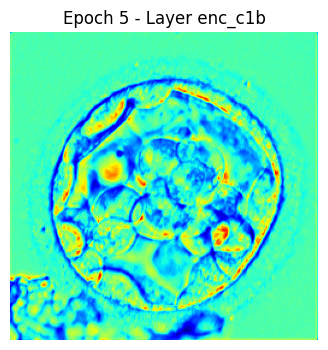

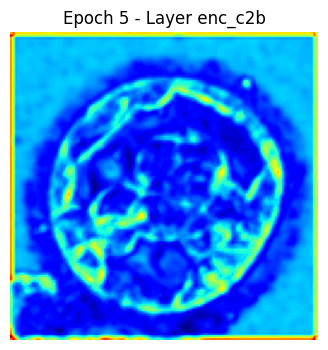

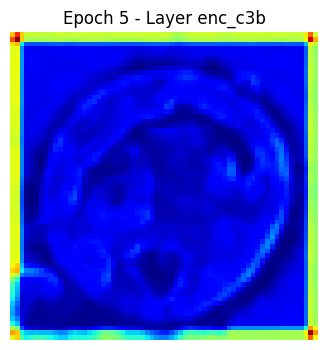

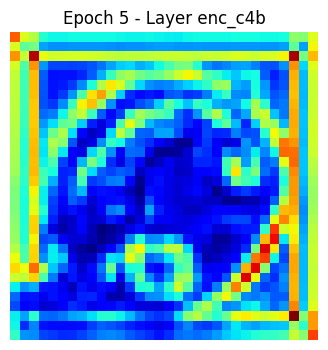

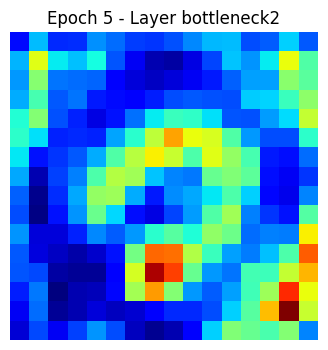

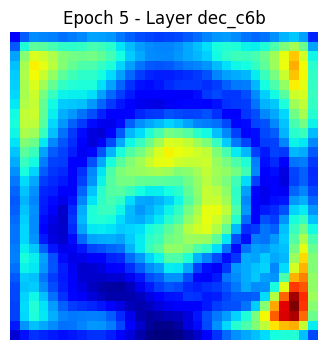

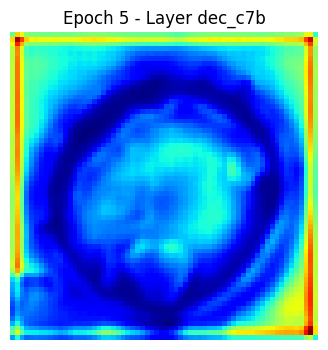

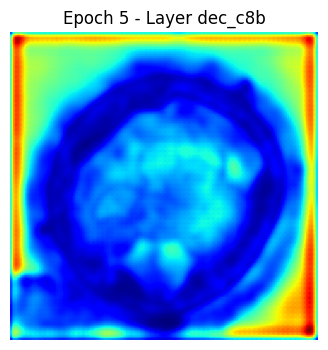

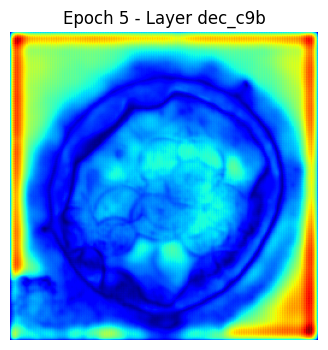

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8456 - dice_coefficient: 0.7323 - iou_metric: 0.5784 - loss: 0.4264 - val_accuracy: 0.8591 - val_dice_coefficient: 0.7211 - val_iou_metric: 0.5671 - val_loss: 0.4154
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8492 - dice_coefficient: 0.7567 - iou_metric: 0.6094 - loss: 0.3849 - val_accuracy: 0.8548 - val_dice_coefficient: 0.7319 - val_iou_metric: 0.5797 - val_loss: 0.3938
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8514 - dice_coefficient: 0.7703 - iou_metric: 0.6272 - loss: 0.3632 - val_accuracy: 0.8551 - val_dice_coefficient: 0.7752 - val_iou_metric: 0.6364 - val_loss: 0.3550
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8523 - dice_coefficient: 0.7826 - iou_metric: 0.6439 - loss: 0.3438 - val_accuracy: 0.8574 - val_dice_coefficient: 0.7814 - val_iou_metric: 0.6447 - val_loss: 0.3466
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 

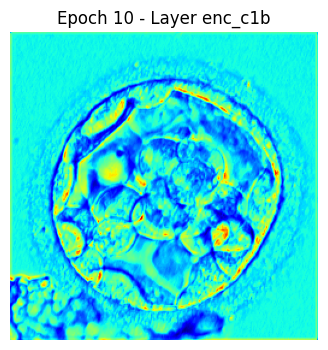

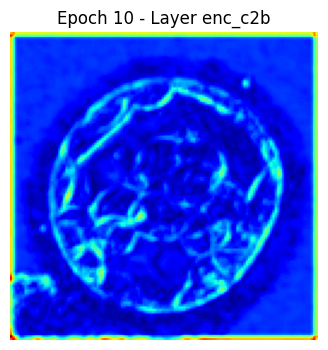

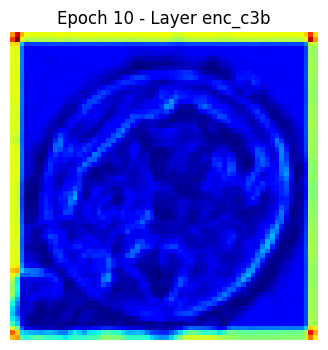

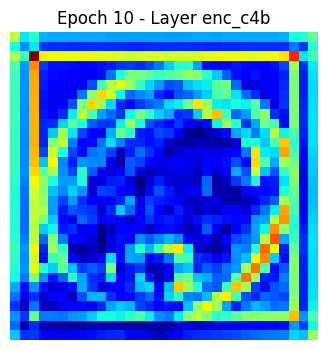

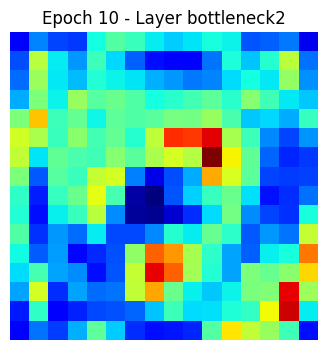

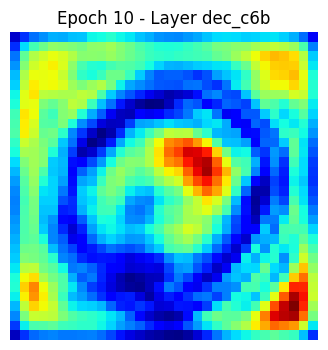

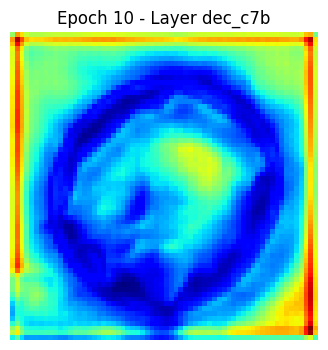

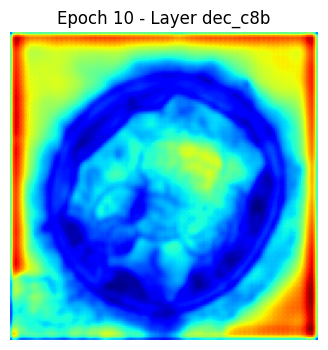

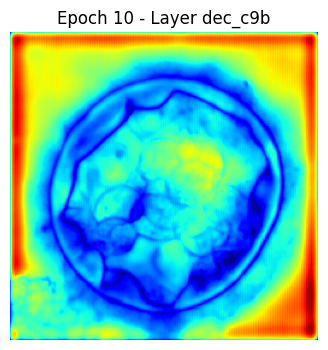

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 237ms/step - accuracy: 0.8553 - dice_coefficient: 0.8038 - iou_metric: 0.6729 - loss: 0.3101 - val_accuracy: 0.8600 - val_dice_coefficient: 0.7892 - val_iou_metric: 0.6559 - val_loss: 0.3273
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8564 - dice_coefficient: 0.8147 - iou_metric: 0.6880 - loss: 0.2949 - val_accuracy: 0.8631 - val_dice_coefficient: 0.7723 - val_iou_metric: 0.6334 - val_loss: 0.3451
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8567 - dice_coefficient: 0.8124 - iou_metric: 0.6852 - loss: 0.2986 - val_accuracy: 0.8629 - val_dice_coefficient: 0.7862 - val_iou_metric: 0.6518 - val_loss: 0.3296
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8581 - dice_coefficient: 0.8267 - iou_metric: 0.7056 - loss: 0.2759 - val_accuracy: 0.8677 - val_dice_coefficient: 0.7934 - val_iou_metric: 0.6624 - val_loss: 0.3295
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accura

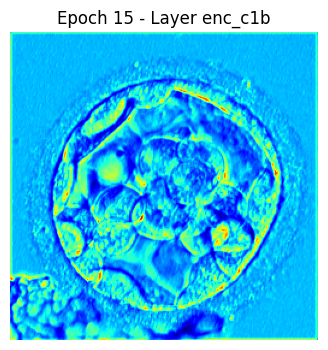

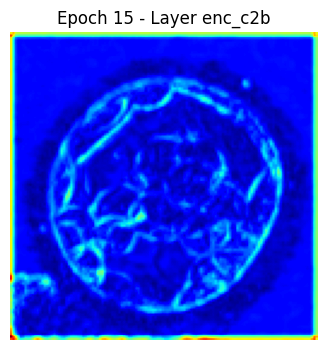

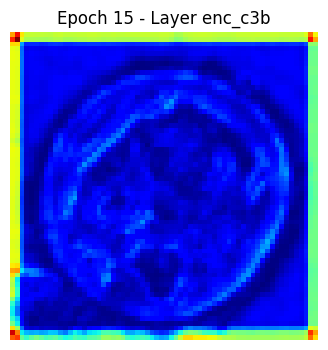

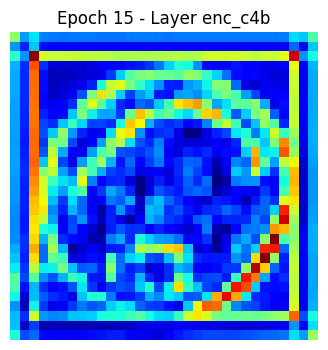

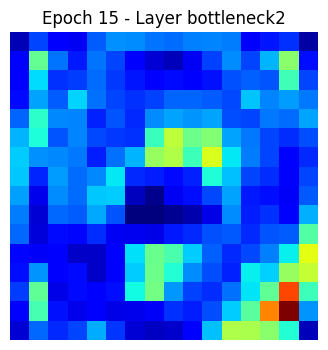

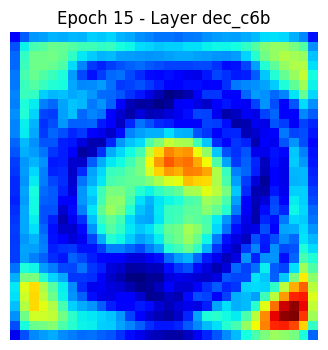

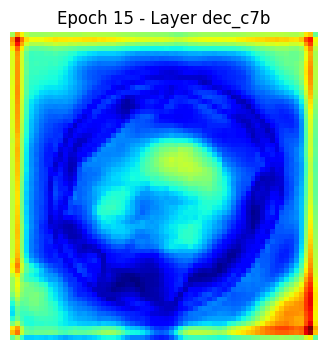

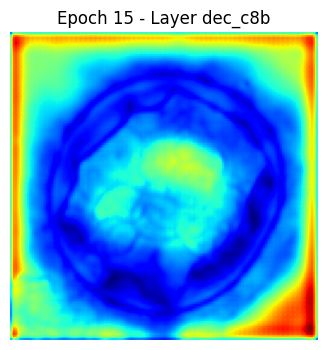

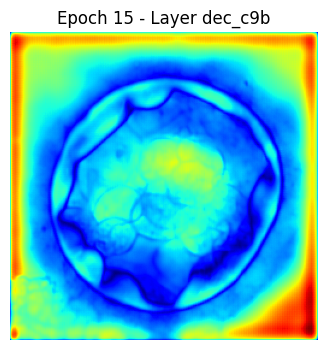

100/100 ━━━━━━━━━━━━━━━━━━━━ 25s 249ms/step - accuracy: 0.8608 - dice_coefficient: 0.8390 - iou_metric: 0.7237 - loss: 0.2564 - val_accuracy: 0.8595 - val_dice_coefficient: 0.8104 - val_iou_metric: 0.6857 - val_loss: 0.3021
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8601 - dice_coefficient: 0.8506 - iou_metric: 0.7410 - loss: 0.2406 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8043 - val_iou_metric: 0.6775 - val_loss: 0.3175
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8627 - dice_coefficient: 0.8551 - iou_metric: 0.7475 - loss: 0.2335 - val_accuracy: 0.8626 - val_dice_coefficient: 0.8062 - val_iou_metric: 0.6801 - val_loss: 0.3227
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8617 - dice_coefficient: 0.8547 - iou_metric: 0.7471 - loss: 0.2318 - val_accuracy: 0.8605 - val_dice_coefficient: 0.7928 - val_iou_metric: 0.6608 - val_loss: 0.3193
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

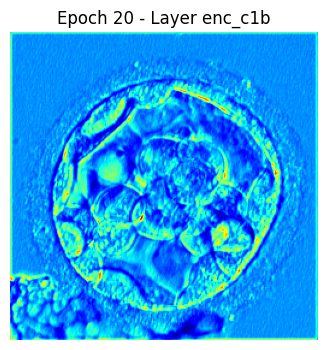

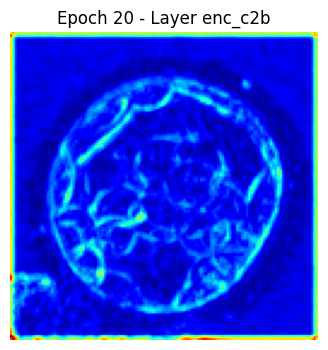

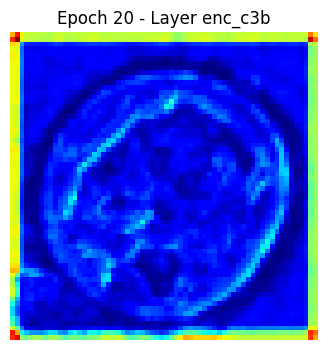

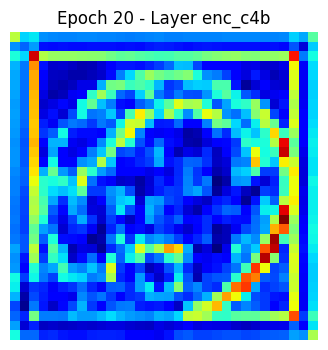

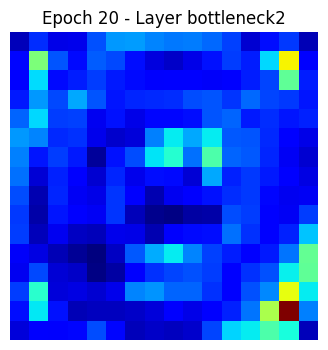

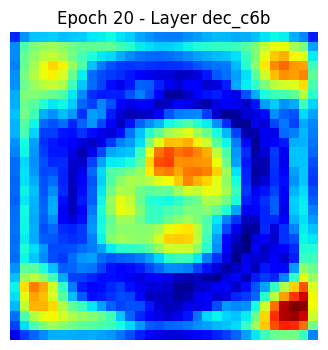

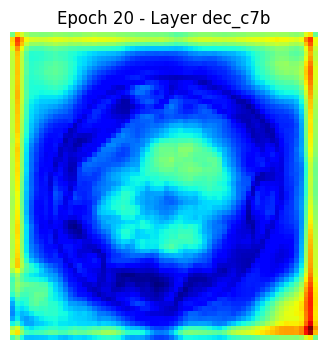

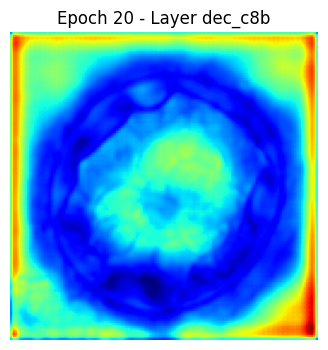

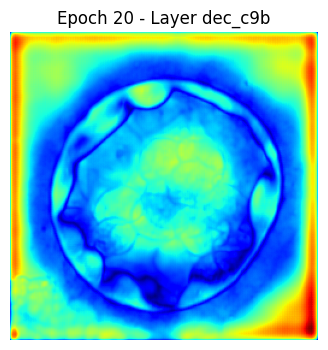

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8647 - dice_coefficient: 0.8740 - iou_metric: 0.7768 - loss: 0.2037 - val_accuracy: 0.8607 - val_dice_coefficient: 0.7864 - val_iou_metric: 0.6518 - val_loss: 0.3301
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8650 - dice_coefficient: 0.8746 - iou_metric: 0.7779 - loss: 0.2008 - val_accuracy: 0.8674 - val_dice_coefficient: 0.7933 - val_iou_metric: 0.6628 - val_loss: 0.3520
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8658 - dice_coefficient: 0.8790 - iou_metric: 0.7849 - loss: 0.1937 - val_accuracy: 0.8597 - val_dice_coefficient: 0.8082 - val_iou_metric: 0.6825 - val_loss: 0.3136
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8666 - dice_coefficient: 0.8838 - iou_metric: 0.7926 - loss: 0.1866 - val_accuracy: 0.8627 - val_dice_coefficient: 0.8089 - val_iou_metric: 0.6838 - val_loss: 0.3168
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accura

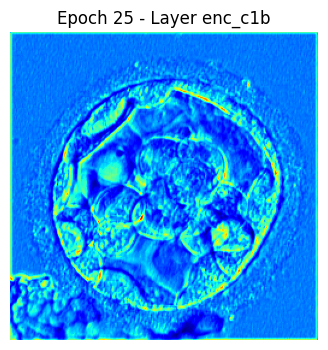

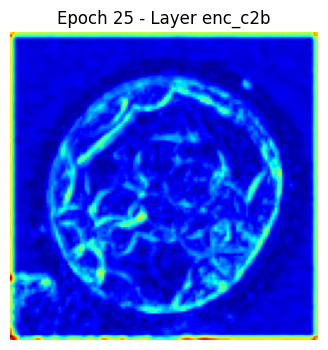

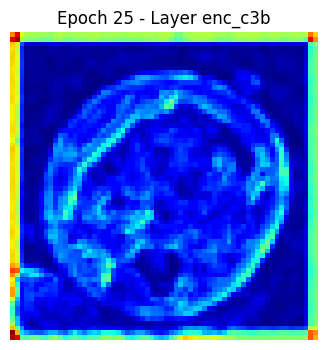

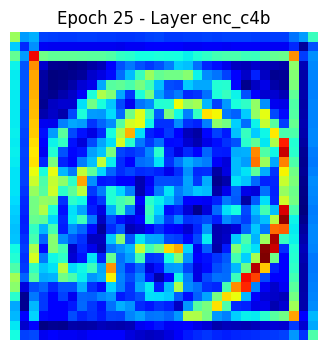

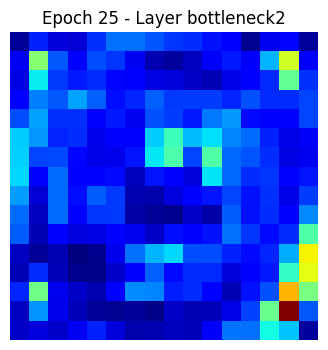

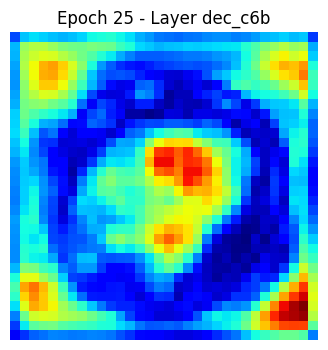

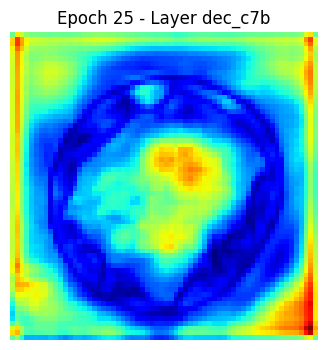

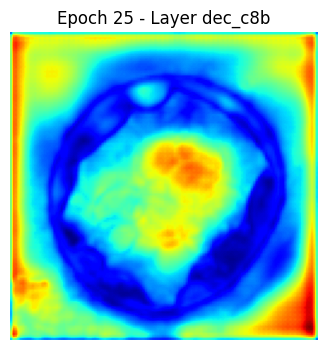

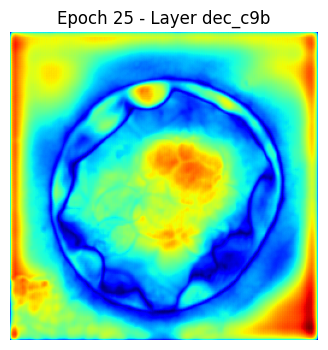

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8678 - dice_coefficient: 0.8961 - iou_metric: 0.8123 - loss: 0.1652 - val_accuracy: 0.8639 - val_dice_coefficient: 0.8112 - val_iou_metric: 0.6868 - val_loss: 0.3235
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8683 - dice_coefficient: 0.8984 - iou_metric: 0.8161 - loss: 0.1627 - val_accuracy: 0.8641 - val_dice_coefficient: 0.8130 - val_iou_metric: 0.6897 - val_loss: 0.3161
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8687 - dice_coefficient: 0.9031 - iou_metric: 0.8239 - loss: 0.1550 - val_accuracy: 0.8638 - val_dice_coefficient: 0.8213 - val_iou_metric: 0.7014 - val_loss: 0.3123
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8696 - dice_coefficient: 0.9098 - iou_metric: 0.8349 - loss: 0.1451 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8119 - val_iou_metric: 0.6883 - val_loss: 0.3245
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accura

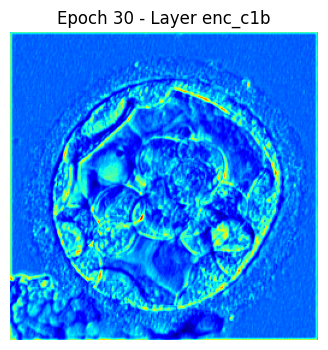

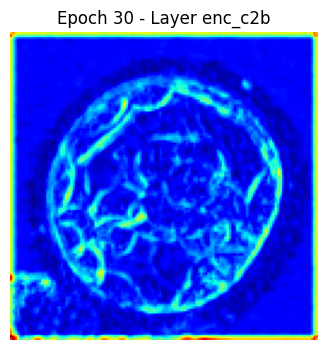

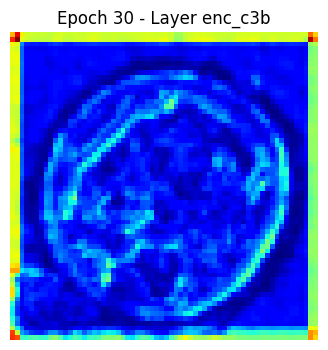

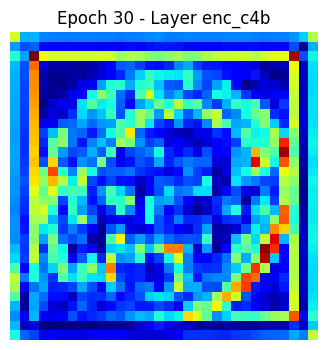

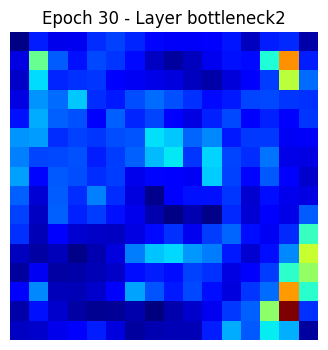

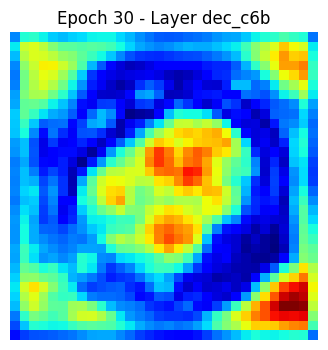

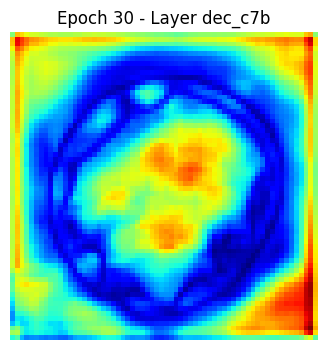

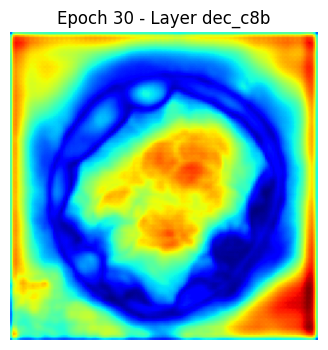

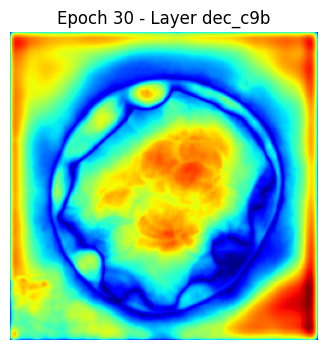

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8704 - dice_coefficient: 0.9160 - iou_metric: 0.8453 - loss: 0.1342 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8043 - val_iou_metric: 0.6772 - val_loss: 0.3514
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8698 - dice_coefficient: 0.9143 - iou_metric: 0.8424 - loss: 0.1366 - val_accuracy: 0.8612 - val_dice_coefficient: 0.8245 - val_iou_metric: 0.7061 - val_loss: 0.3272
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8697 - dice_coefficient: 0.9175 - iou_metric: 0.8479 - loss: 0.1308 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8116 - val_iou_metric: 0.6874 - val_loss: 0.3407
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8715 - dice_coefficient: 0.9216 - iou_metric: 0.8549 - loss: 0.1241 - val_accuracy: 0.8649 - val_dice_coefficient: 0.8119 - val_iou_metric: 0.6878 - val_loss: 0.3305
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

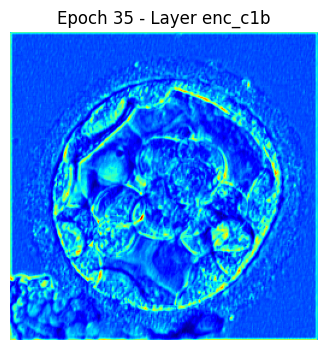

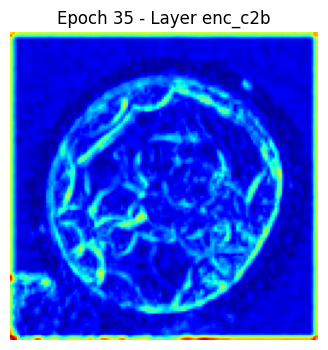

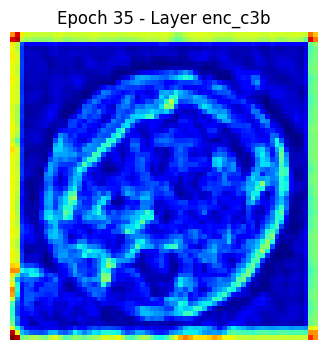

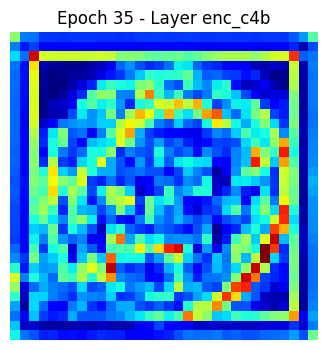

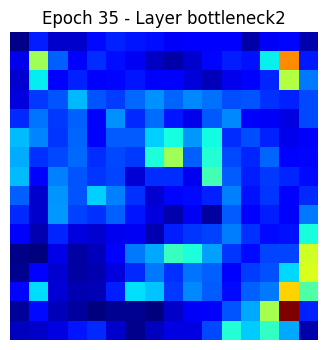

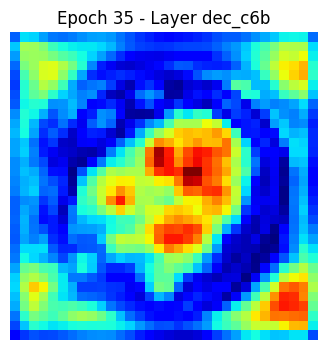

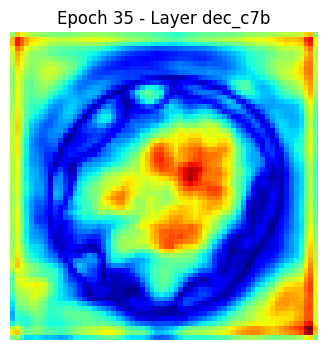

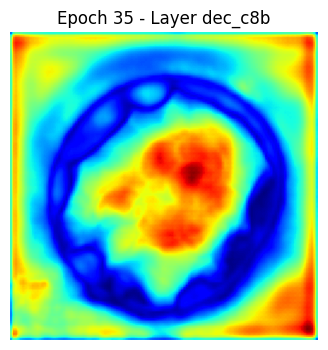

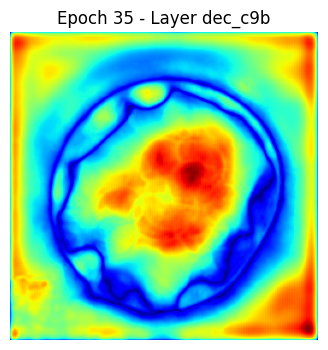

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8712 - dice_coefficient: 0.9245 - iou_metric: 0.8599 - loss: 0.1188 - val_accuracy: 0.8675 - val_dice_coefficient: 0.8161 - val_iou_metric: 0.6944 - val_loss: 0.3466
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accuracy: 0.8724 - dice_coefficient: 0.9279 - iou_metric: 0.8658 - loss: 0.1133 - val_accuracy: 0.8639 - val_dice_coefficient: 0.8279 - val_iou_metric: 0.7111 - val_loss: 0.3394
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8727 - dice_coefficient: 0.9323 - iou_metric: 0.8734 - loss: 0.1066 - val_accuracy: 0.8632 - val_dice_coefficient: 0.8295 - val_iou_metric: 0.7132 - val_loss: 0.3242
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 239ms/step - accuracy: 0.8716 - dice_coefficient: 0.9354 - iou_metric: 0.8788 - loss: 0.1015 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8336 - val_iou_metric: 0.7198 - val_loss: 0.3440
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accura

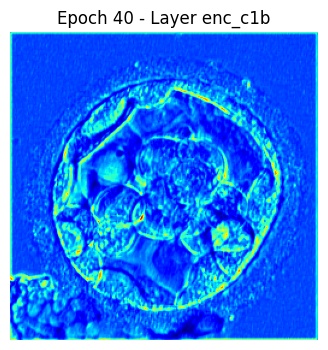

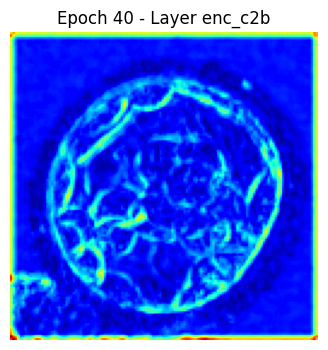

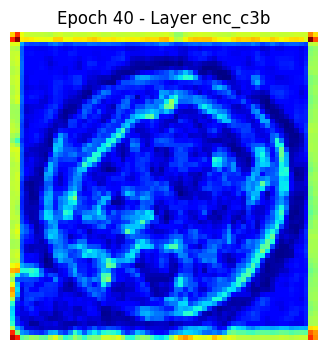

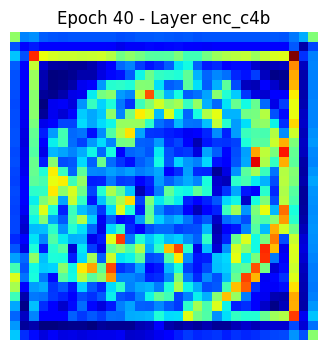

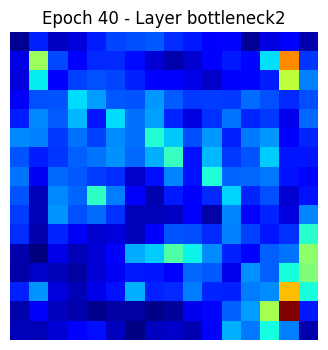

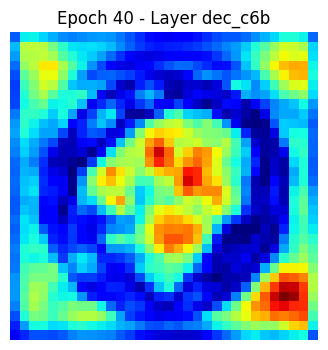

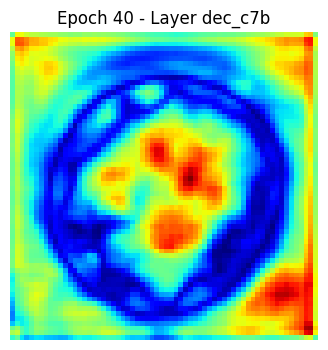

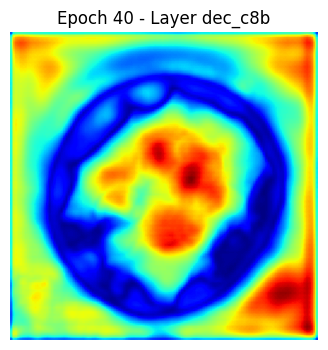

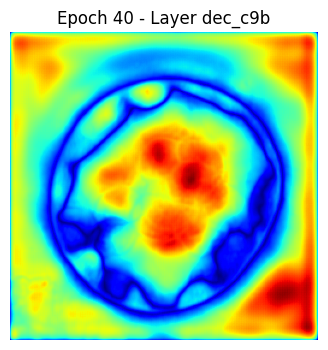

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8730 - dice_coefficient: 0.9412 - iou_metric: 0.8891 - loss: 0.0925 - val_accuracy: 0.8659 - val_dice_coefficient: 0.8296 - val_iou_metric: 0.7139 - val_loss: 0.3356
Epoch 41/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8726 - dice_coefficient: 0.9437 - iou_metric: 0.8935 - loss: 0.0884 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8332 - val_iou_metric: 0.7191 - val_loss: 0.3418
Epoch 42/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8735 - dice_coefficient: 0.9463 - iou_metric: 0.8982 - loss: 0.0843 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8342 - val_iou_metric: 0.7208 - val_loss: 0.3571
Epoch 43/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8733 - dice_coefficient: 0.9491 - iou_metric: 0.9032 - loss: 0.0800 - val_accuracy: 0.8651 - val_dice_coefficient: 0.8400 - val_iou_metric: 0.7295 - val_loss: 0.3559
Epoch 44/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

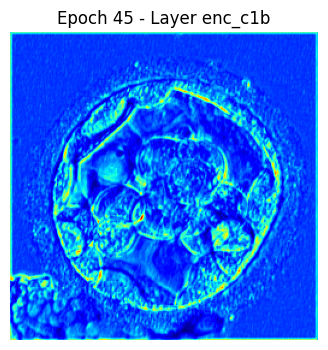

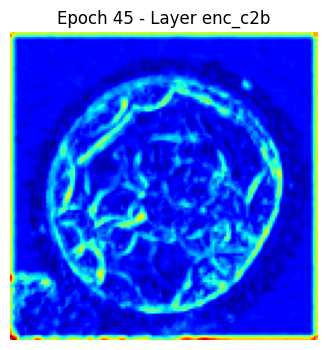

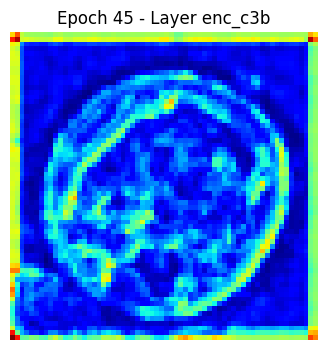

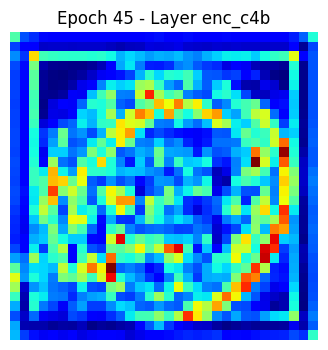

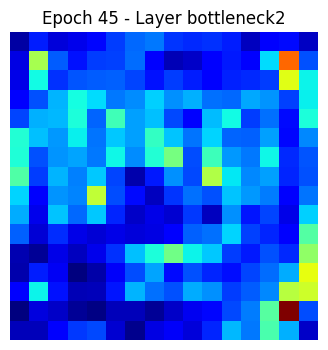

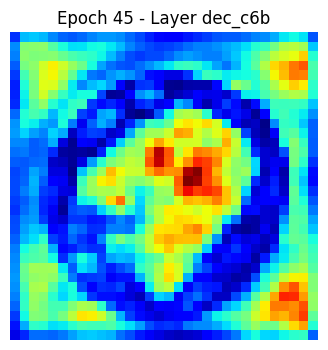

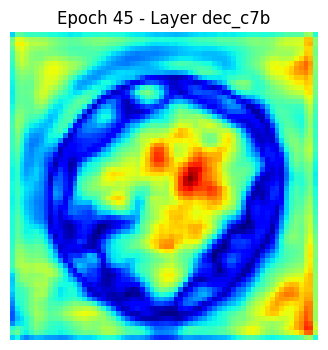

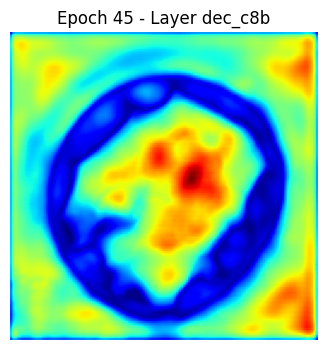

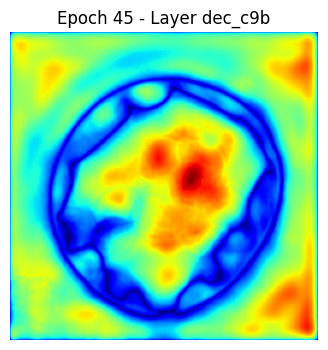

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8739 - dice_coefficient: 0.9530 - iou_metric: 0.9103 - loss: 0.0737 - val_accuracy: 0.8684 - val_dice_coefficient: 0.8276 - val_iou_metric: 0.7115 - val_loss: 0.3885
Epoch 46/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8749 - dice_coefficient: 0.9513 - iou_metric: 0.9072 - loss: 0.0760 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8365 - val_iou_metric: 0.7243 - val_loss: 0.3662
Epoch 47/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8741 - dice_coefficient: 0.9566 - iou_metric: 0.9169 - loss: 0.0680 - val_accuracy: 0.8671 - val_dice_coefficient: 0.8393 - val_iou_metric: 0.7286 - val_loss: 0.3712
Epoch 48/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8744 - dice_coefficient: 0.9592 - iou_metric: 0.9217 - loss: 0.0635 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8401 - val_iou_metric: 0.7299 - val_loss: 0.3825
Epoch 49/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

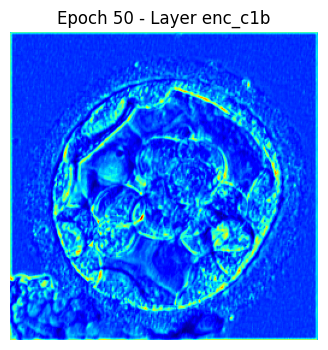

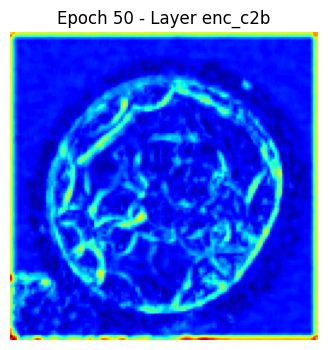

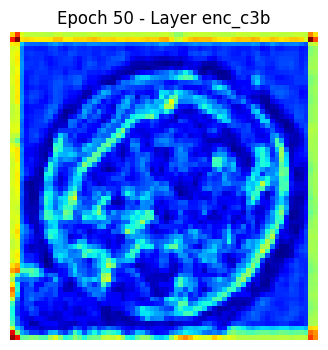

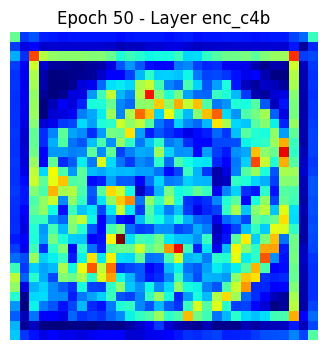

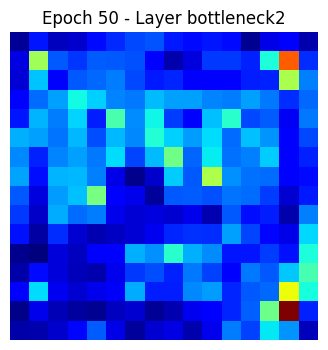

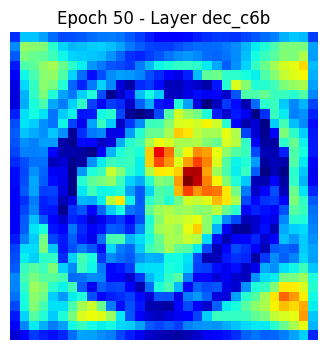

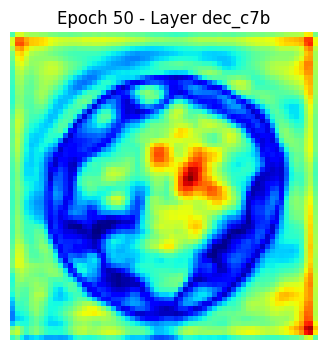

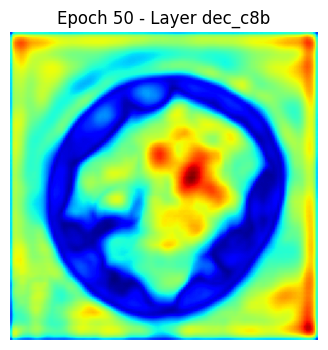

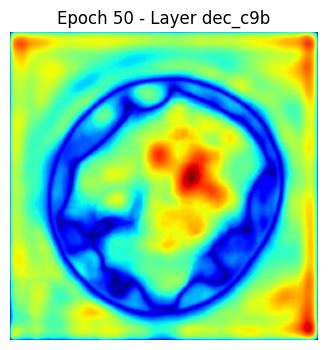

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8749 - dice_coefficient: 0.9617 - iou_metric: 0.9263 - loss: 0.0600 - val_accuracy: 0.8679 - val_dice_coefficient: 0.8378 - val_iou_metric: 0.7265 - val_loss: 0.3946
Epoch 51/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8753 - dice_coefficient: 0.9626 - iou_metric: 0.9279 - loss: 0.0585 - val_accuracy: 0.8650 - val_dice_coefficient: 0.8420 - val_iou_metric: 0.7326 - val_loss: 0.3798
Epoch 52/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8750 - dice_coefficient: 0.9638 - iou_metric: 0.9301 - loss: 0.0566 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8414 - val_iou_metric: 0.7318 - val_loss: 0.3995
Epoch 53/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8745 - dice_coefficient: 0.9650 - iou_metric: 0.9324 - loss: 0.0547 - val_accuracy: 0.8652 - val_dice_coefficient: 0.8425 - val_iou_metric: 0.7333 - val_loss: 0.3874
Epoch 54/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

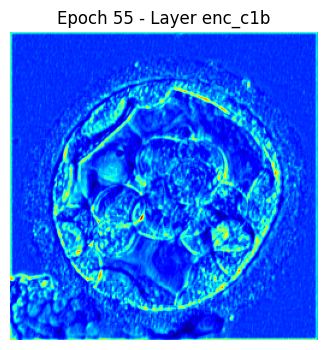

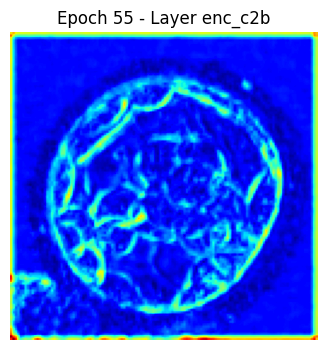

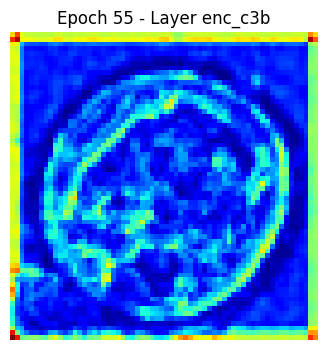

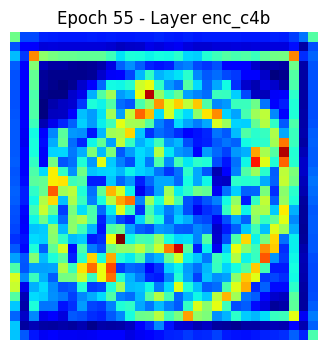

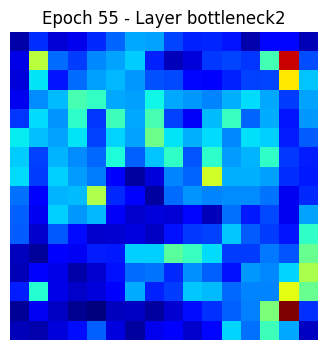

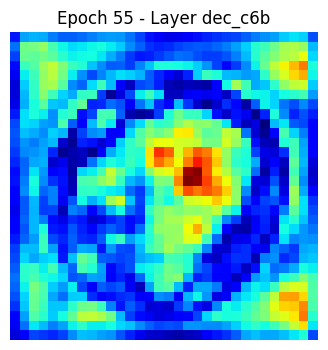

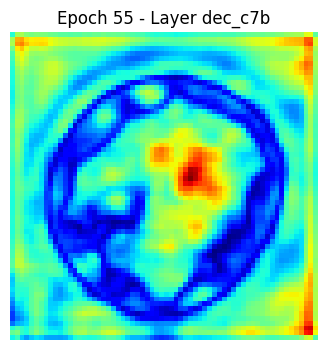

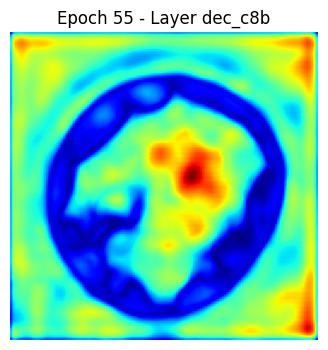

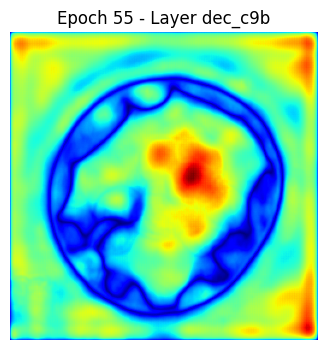

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8752 - dice_coefficient: 0.9650 - iou_metric: 0.9325 - loss: 0.0546 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8405 - val_iou_metric: 0.7305 - val_loss: 0.4133
Epoch 56/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8752 - dice_coefficient: 0.9665 - iou_metric: 0.9352 - loss: 0.0524 - val_accuracy: 0.8666 - val_dice_coefficient: 0.8438 - val_iou_metric: 0.7355 - val_loss: 0.4075
Epoch 57/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8759 - dice_coefficient: 0.9671 - iou_metric: 0.9363 - loss: 0.0514 - val_accuracy: 0.8656 - val_dice_coefficient: 0.8438 - val_iou_metric: 0.7356 - val_loss: 0.3976
Epoch 58/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8754 - dice_coefficient: 0.9675 - iou_metric: 0.9371 - loss: 0.0506 - val_accuracy: 0.8678 - val_dice_coefficient: 0.8390 - val_iou_metric: 0.7285 - val_loss: 0.4099
Epoch 59/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accura

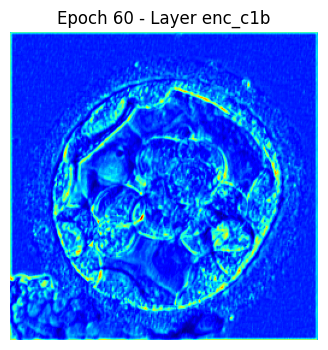

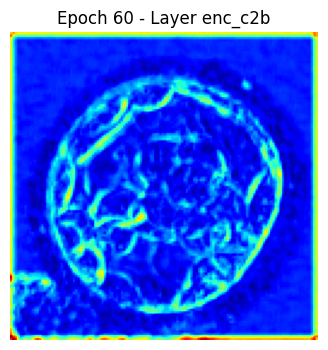

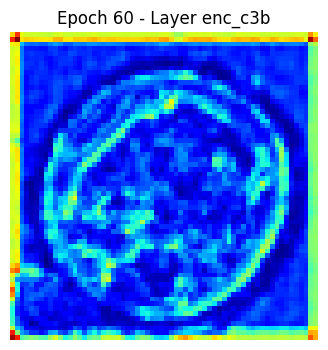

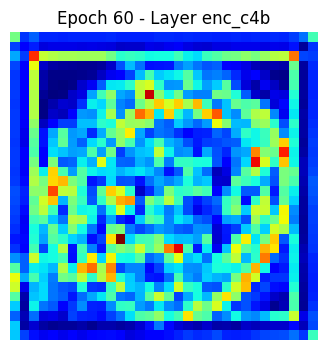

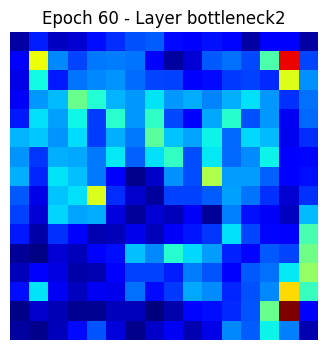

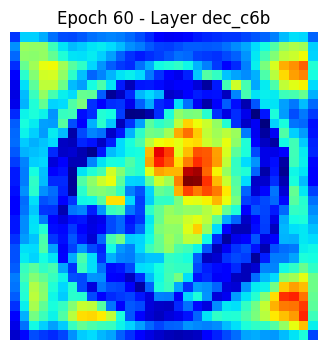

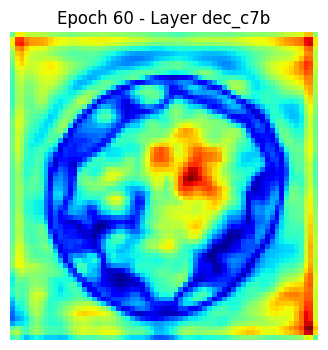

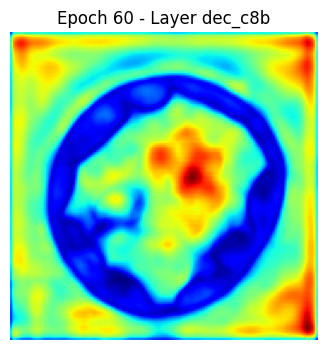

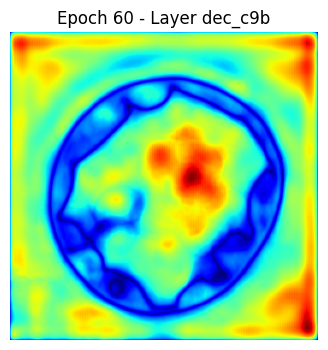

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8746 - dice_coefficient: 0.9683 - iou_metric: 0.9385 - loss: 0.0495 - val_accuracy: 0.8679 - val_dice_coefficient: 0.8421 - val_iou_metric: 0.7332 - val_loss: 0.4205
Epoch 61/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8753 - dice_coefficient: 0.9695 - iou_metric: 0.9409 - loss: 0.0475 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8427 - val_iou_metric: 0.7340 - val_loss: 0.4231
Epoch 62/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8756 - dice_coefficient: 0.9698 - iou_metric: 0.9414 - loss: 0.0470 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8420 - val_iou_metric: 0.7328 - val_loss: 0.4221
Epoch 63/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8751 - dice_coefficient: 0.9700 - iou_metric: 0.9418 - loss: 0.0468 - val_accuracy: 0.8673 - val_dice_coefficient: 0.8414 - val_iou_metric: 0.7321 - val_loss: 0.4241
Epoch 64/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accura

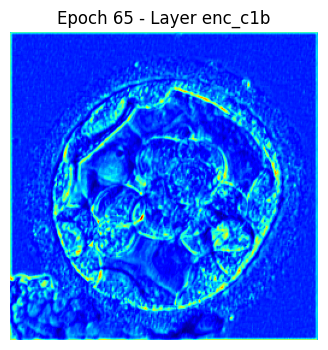

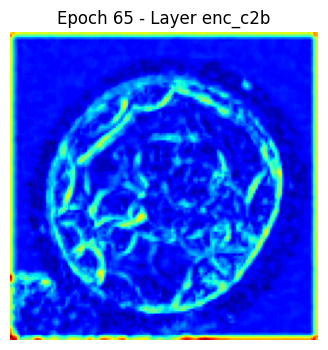

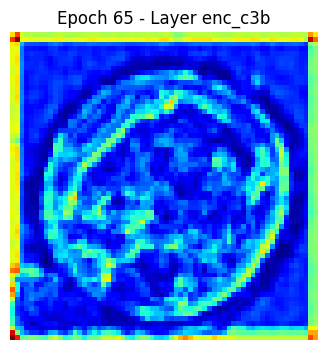

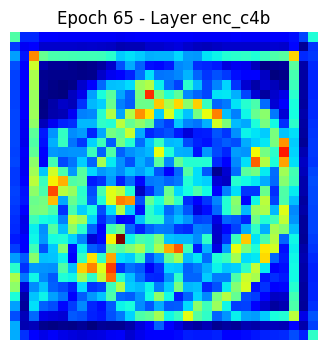

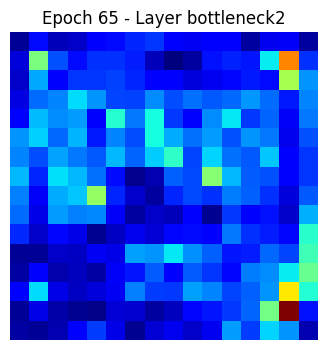

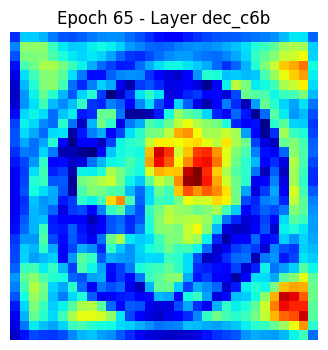

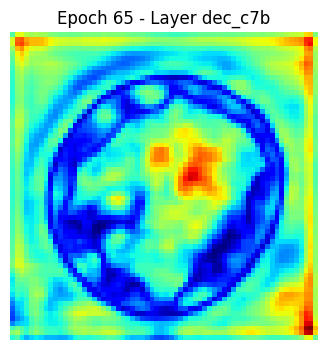

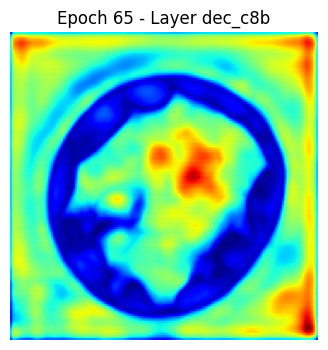

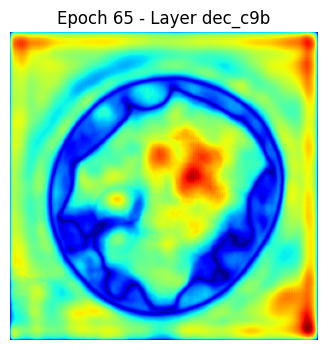

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8755 - dice_coefficient: 0.9708 - iou_metric: 0.9432 - loss: 0.0455 - val_accuracy: 0.8673 - val_dice_coefficient: 0.8422 - val_iou_metric: 0.7334 - val_loss: 0.4244
Epoch 66/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8756 - dice_coefficient: 0.9708 - iou_metric: 0.9433 - loss: 0.0453 - val_accuracy: 0.8643 - val_dice_coefficient: 0.8440 - val_iou_metric: 0.7357 - val_loss: 0.4050
Epoch 67/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accuracy: 0.8750 - dice_coefficient: 0.9707 - iou_metric: 0.9431 - loss: 0.0456 - val_accuracy: 0.8659 - val_dice_coefficient: 0.8454 - val_iou_metric: 0.7379 - val_loss: 0.4078
Epoch 68/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8749 - dice_coefficient: 0.9716 - iou_metric: 0.9447 - loss: 0.0443 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8409 - val_iou_metric: 0.7312 - val_loss: 0.4307
Epoch 69/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

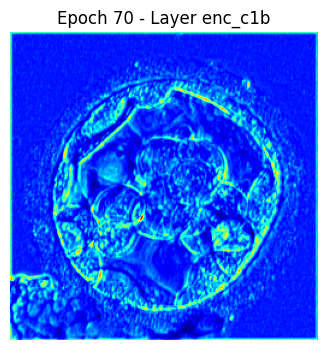

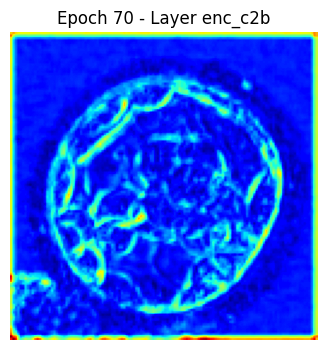

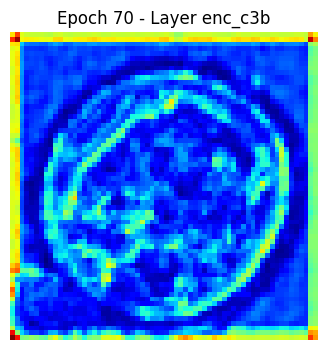

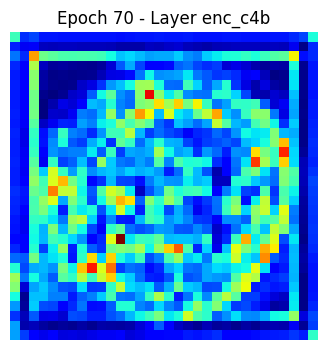

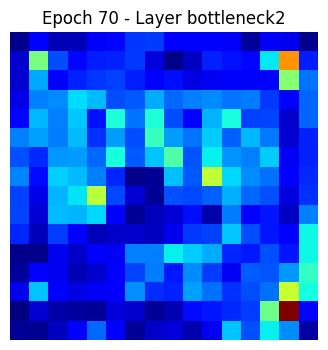

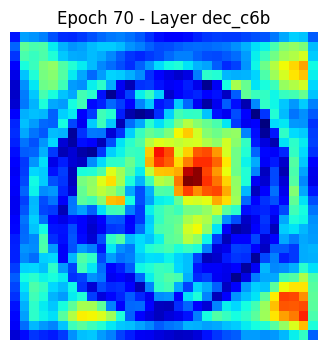

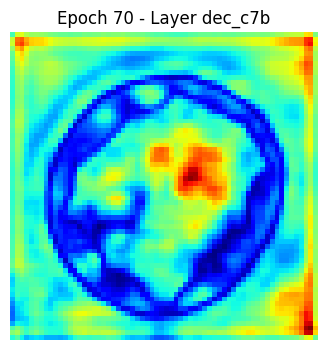

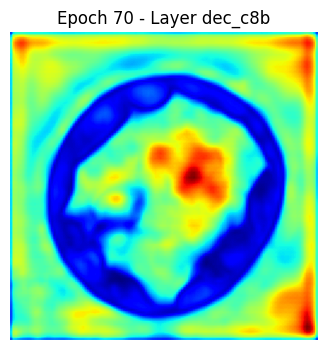

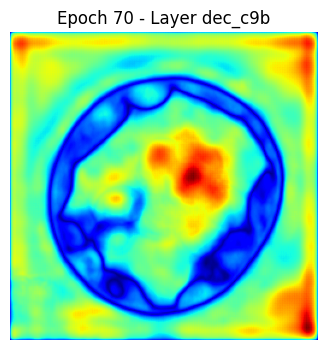

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8758 - dice_coefficient: 0.9716 - iou_metric: 0.9448 - loss: 0.0443 - val_accuracy: 0.8662 - val_dice_coefficient: 0.8442 - val_iou_metric: 0.7361 - val_loss: 0.4240
Epoch 71/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8760 - dice_coefficient: 0.9722 - iou_metric: 0.9460 - loss: 0.0431 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8450 - val_iou_metric: 0.7373 - val_loss: 0.4284
Epoch 72/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8757 - dice_coefficient: 0.9727 - iou_metric: 0.9469 - loss: 0.0425 - val_accuracy: 0.8655 - val_dice_coefficient: 0.8447 - val_iou_metric: 0.7368 - val_loss: 0.4198
Epoch 73/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8751 - dice_coefficient: 0.9727 - iou_metric: 0.9469 - loss: 0.0425 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8443 - val_iou_metric: 0.7365 - val_loss: 0.4220
Epoch 74/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

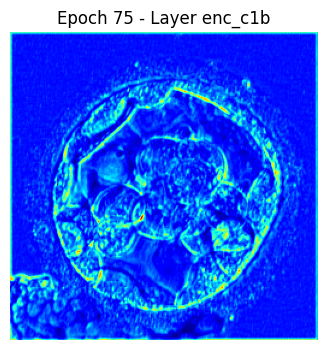

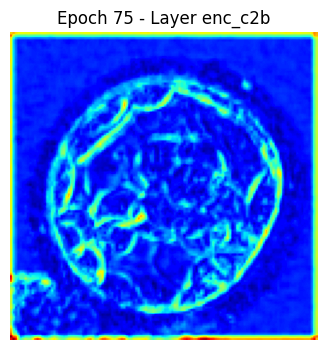

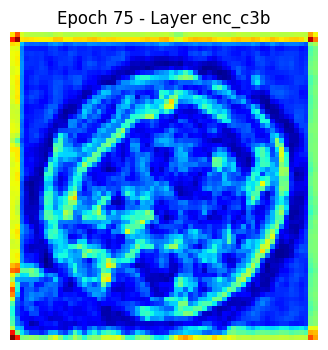

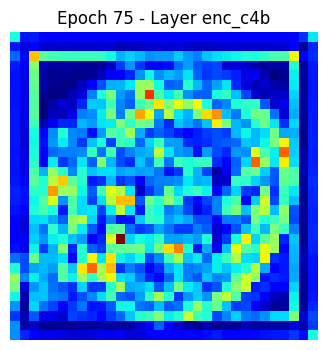

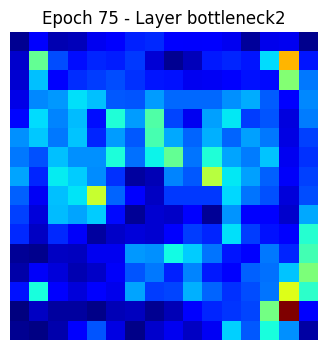

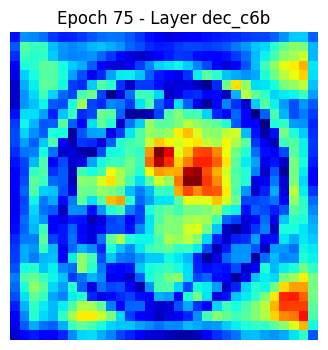

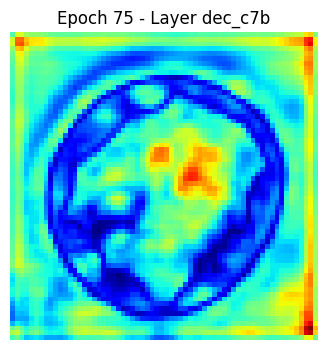

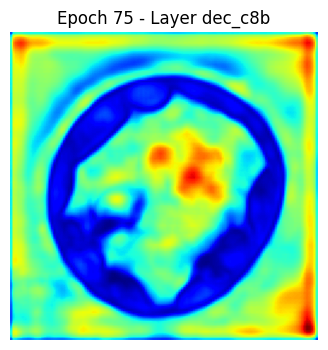

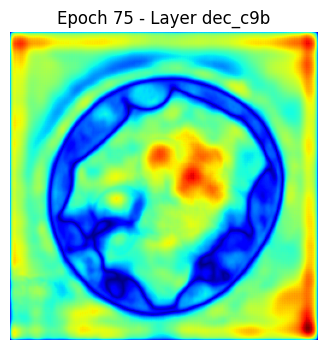

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8758 - dice_coefficient: 0.9732 - iou_metric: 0.9478 - loss: 0.0417 - val_accuracy: 0.8664 - val_dice_coefficient: 0.8438 - val_iou_metric: 0.7357 - val_loss: 0.4292
Epoch 76/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8755 - dice_coefficient: 0.9735 - iou_metric: 0.9484 - loss: 0.0411 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8449 - val_iou_metric: 0.7374 - val_loss: 0.4386
Epoch 77/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8761 - dice_coefficient: 0.9736 - iou_metric: 0.9486 - loss: 0.0410 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8460 - val_iou_metric: 0.7391 - val_loss: 0.4346
Epoch 78/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8752 - dice_coefficient: 0.9739 - iou_metric: 0.9492 - loss: 0.0407 - val_accuracy: 0.8673 - val_dice_coefficient: 0.8442 - val_iou_metric: 0.7363 - val_loss: 0.4398
Epoch 79/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

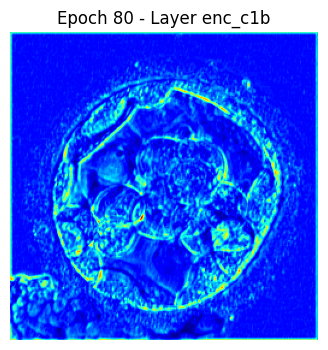

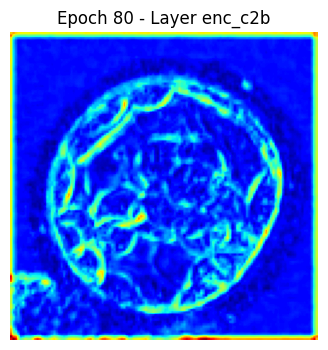

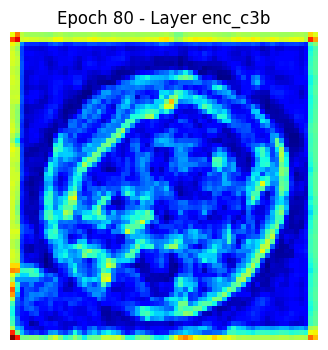

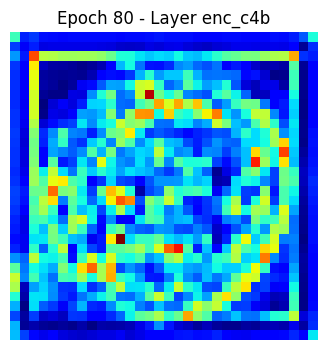

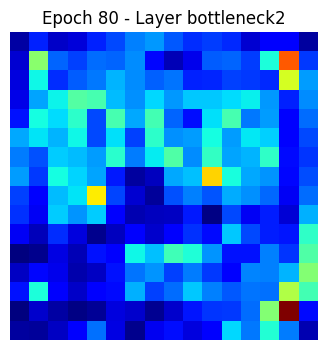

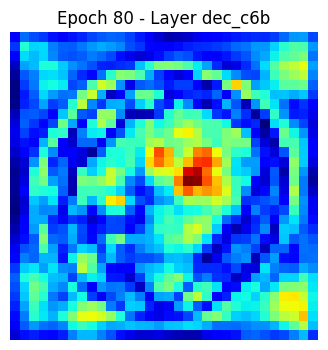

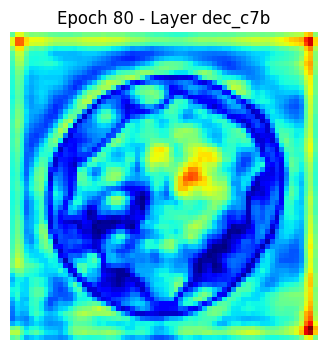

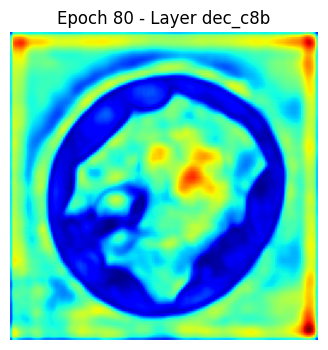

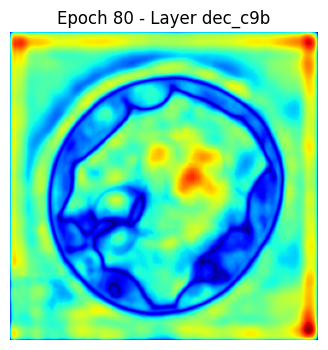

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8760 - dice_coefficient: 0.9734 - iou_metric: 0.9482 - loss: 0.0413 - val_accuracy: 0.8638 - val_dice_coefficient: 0.8443 - val_iou_metric: 0.7362 - val_loss: 0.4269
Epoch 81/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8762 - dice_coefficient: 0.9701 - iou_metric: 0.9419 - loss: 0.0466 - val_accuracy: 0.8673 - val_dice_coefficient: 0.8445 - val_iou_metric: 0.7367 - val_loss: 0.4145
Epoch 82/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8766 - dice_coefficient: 0.9727 - iou_metric: 0.9469 - loss: 0.0423 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8456 - val_iou_metric: 0.7385 - val_loss: 0.4350
Epoch 83/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8756 - dice_coefficient: 0.9745 - iou_metric: 0.9504 - loss: 0.0397 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8454 - val_iou_metric: 0.7382 - val_loss: 0.4292
Epoch 84/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

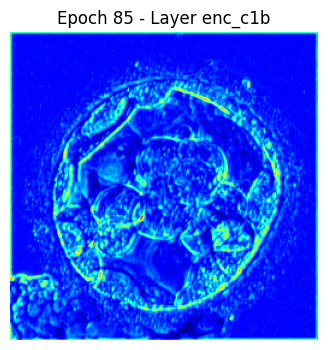

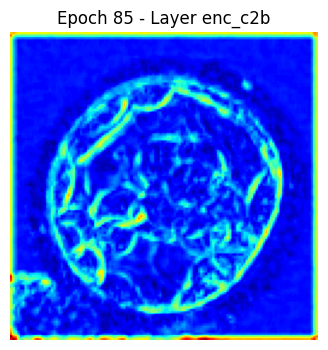

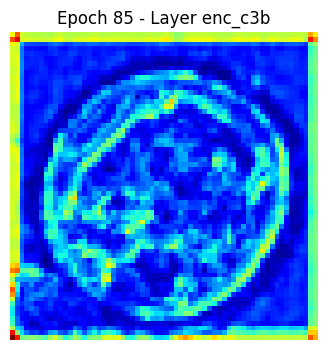

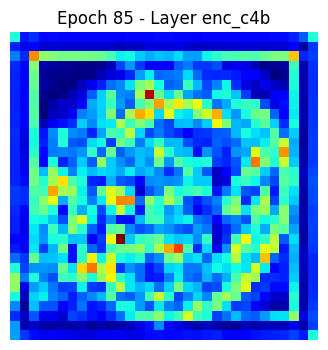

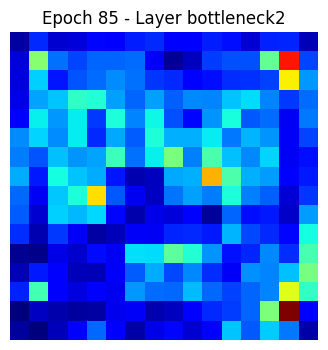

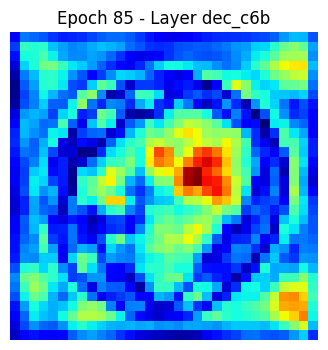

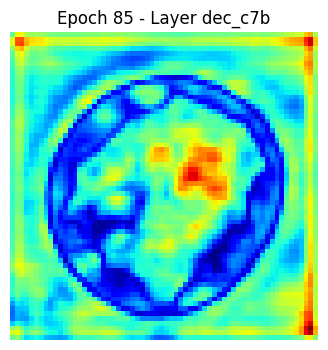

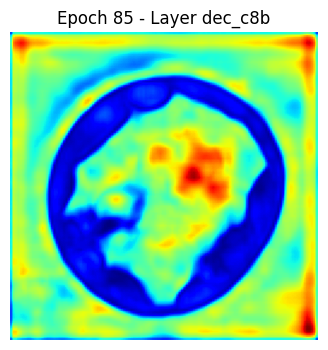

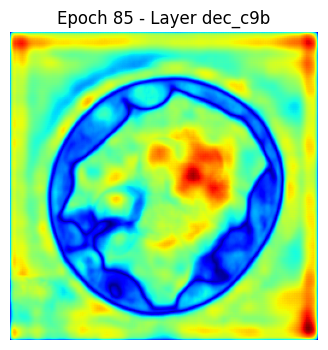

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8758 - dice_coefficient: 0.9754 - iou_metric: 0.9520 - loss: 0.0382 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8459 - val_iou_metric: 0.7390 - val_loss: 0.4392
Epoch 86/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8764 - dice_coefficient: 0.9751 - iou_metric: 0.9514 - loss: 0.0387 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8464 - val_iou_metric: 0.7396 - val_loss: 0.4339
Epoch 87/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8762 - dice_coefficient: 0.9751 - iou_metric: 0.9514 - loss: 0.0388 - val_accuracy: 0.8666 - val_dice_coefficient: 0.8465 - val_iou_metric: 0.7399 - val_loss: 0.4439
Epoch 88/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8756 - dice_coefficient: 0.9757 - iou_metric: 0.9526 - loss: 0.0379 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8473 - val_iou_metric: 0.7411 - val_loss: 0.4414
Epoch 89/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

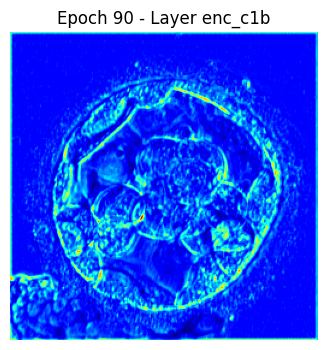

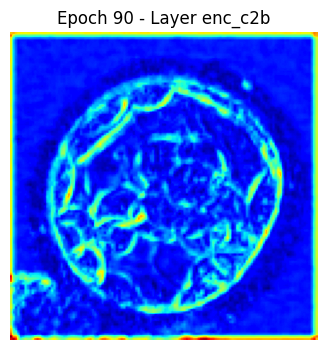

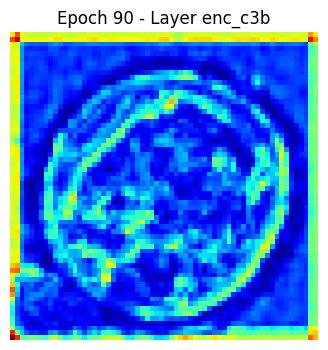

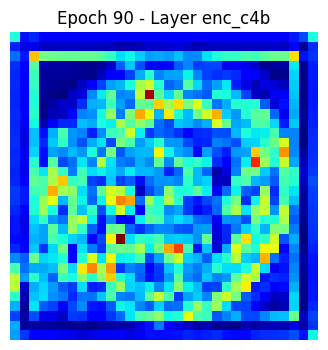

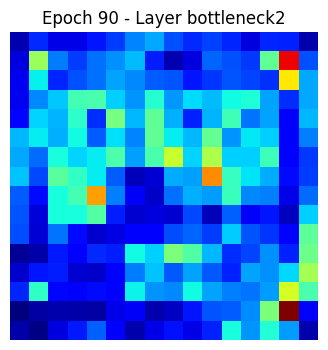

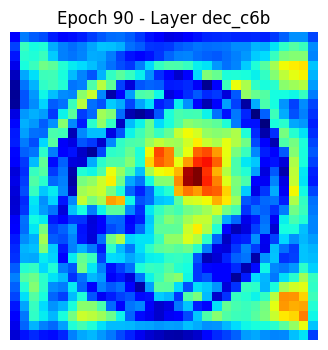

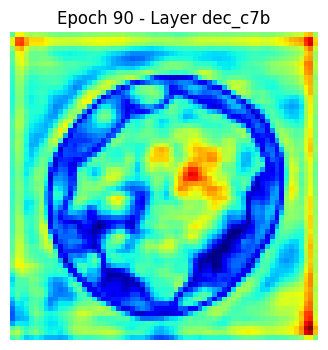

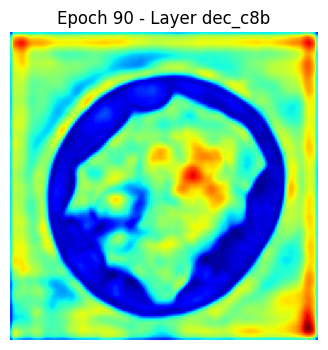

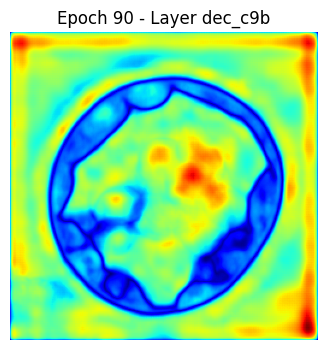

100/100 ━━━━━━━━━━━━━━━━━━━━ 25s 248ms/step - accuracy: 0.8766 - dice_coefficient: 0.9758 - iou_metric: 0.9527 - loss: 0.0376 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8477 - val_iou_metric: 0.7417 - val_loss: 0.4473
Epoch 91/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8766 - dice_coefficient: 0.9759 - iou_metric: 0.9529 - loss: 0.0375 - val_accuracy: 0.8676 - val_dice_coefficient: 0.8447 - val_iou_metric: 0.7373 - val_loss: 0.4447
Epoch 92/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8755 - dice_coefficient: 0.9754 - iou_metric: 0.9520 - loss: 0.0383 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8478 - val_iou_metric: 0.7417 - val_loss: 0.4333
Epoch 93/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8754 - dice_coefficient: 0.9757 - iou_metric: 0.9526 - loss: 0.0378 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8474 - val_iou_metric: 0.7411 - val_loss: 0.4493
Epoch 94/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

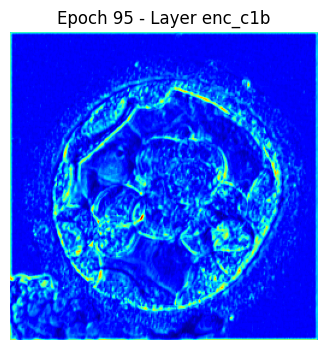

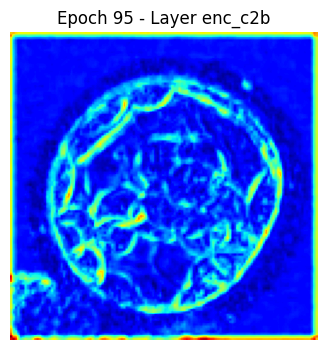

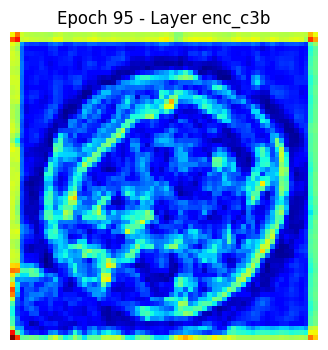

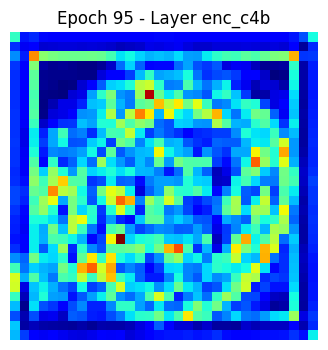

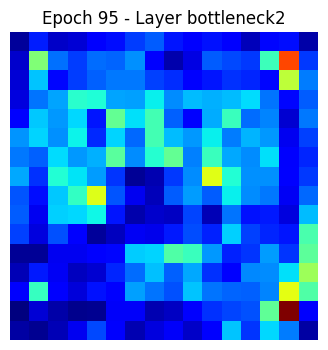

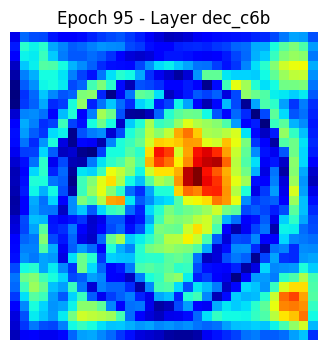

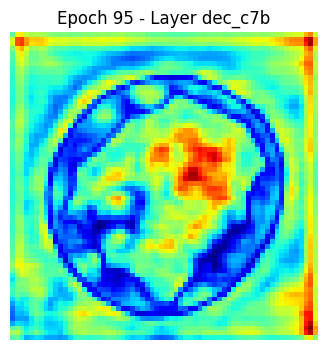

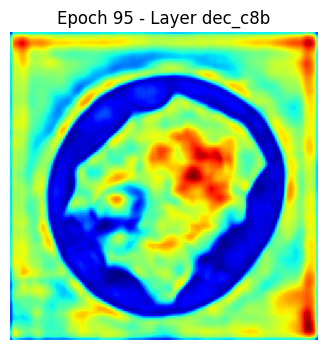

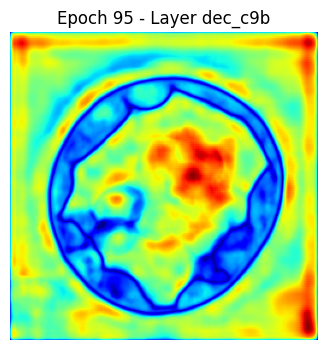

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8756 - dice_coefficient: 0.9761 - iou_metric: 0.9534 - loss: 0.0371 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8477 - val_iou_metric: 0.7417 - val_loss: 0.4363
Epoch 96/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8754 - dice_coefficient: 0.9764 - iou_metric: 0.9539 - loss: 0.0367 - val_accuracy: 0.8655 - val_dice_coefficient: 0.8474 - val_iou_metric: 0.7411 - val_loss: 0.4431
Epoch 97/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8752 - dice_coefficient: 0.9764 - iou_metric: 0.9539 - loss: 0.0367 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8479 - val_iou_metric: 0.7420 - val_loss: 0.4408
Epoch 98/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8753 - dice_coefficient: 0.9770 - iou_metric: 0.9551 - loss: 0.0359 - val_accuracy: 0.8664 - val_dice_coefficient: 0.8470 - val_iou_metric: 0.7405 - val_loss: 0.4592
Epoch 99/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

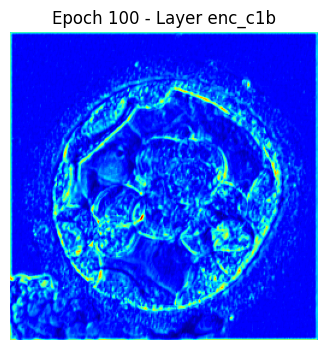

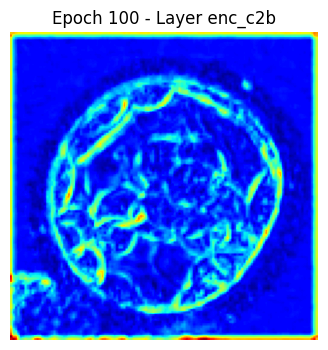

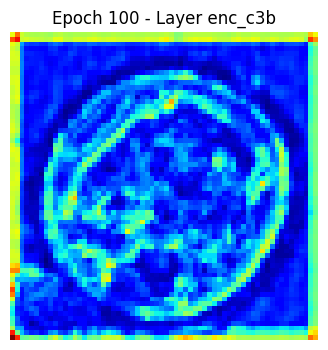

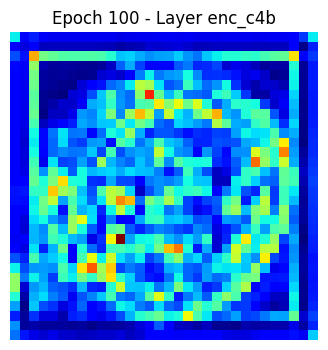

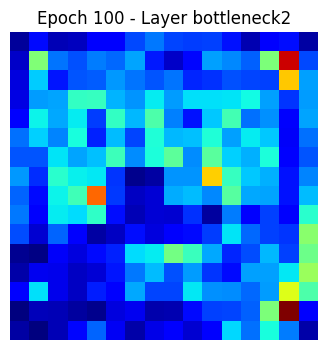

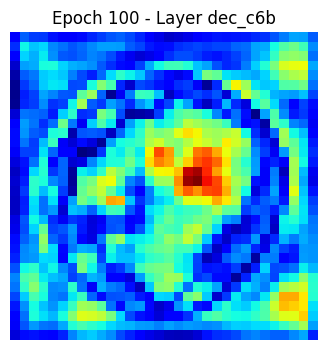

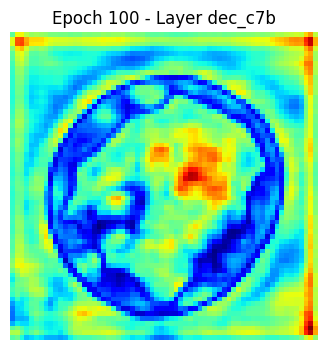

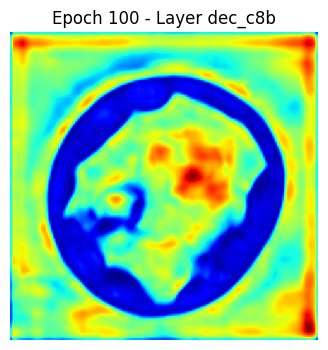

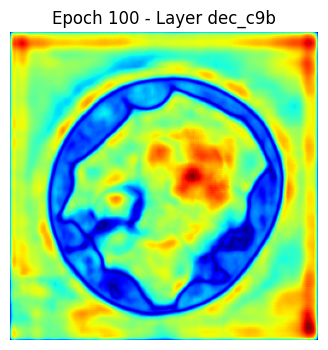

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8771 - dice_coefficient: 0.9758 - iou_metric: 0.9528 - loss: 0.0374 - val_accuracy: 0.8677 - val_dice_coefficient: 0.8443 - val_iou_metric: 0.7367 - val_loss: 0.4421
Epoch 101/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8761 - dice_coefficient: 0.9753 - iou_metric: 0.9518 - loss: 0.0383 - val_accuracy: 0.8664 - val_dice_coefficient: 0.8472 - val_iou_metric: 0.7411 - val_loss: 0.4593
Epoch 102/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8758 - dice_coefficient: 0.9766 - iou_metric: 0.9542 - loss: 0.0366 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8481 - val_iou_metric: 0.7423 - val_loss: 0.4447
Epoch 103/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 239ms/step - accuracy: 0.8757 - dice_coefficient: 0.9771 - iou_metric: 0.9553 - loss: 0.0356 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8492 - val_iou_metric: 0.7440 - val_loss: 0.4572
Epoch 104/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - ac

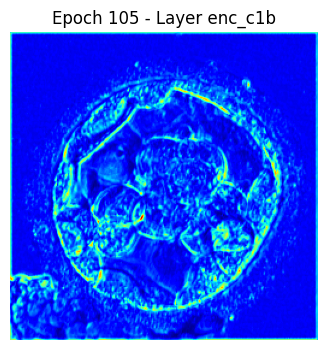

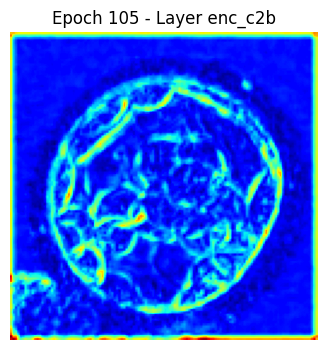

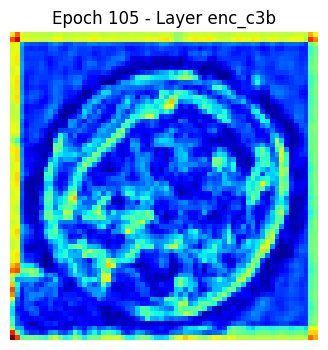

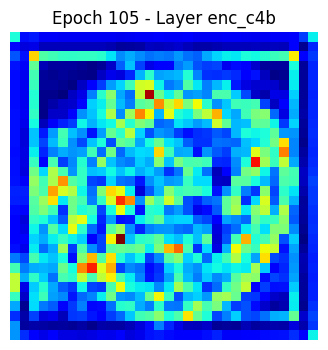

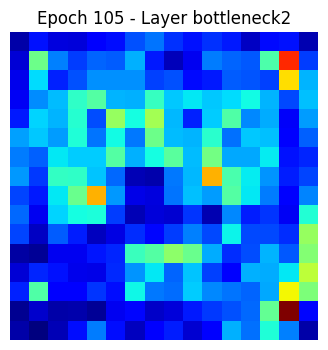

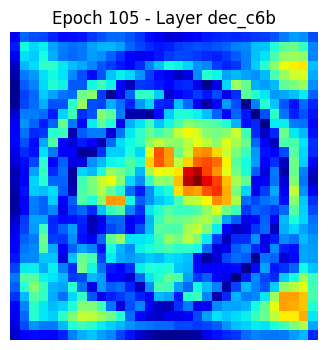

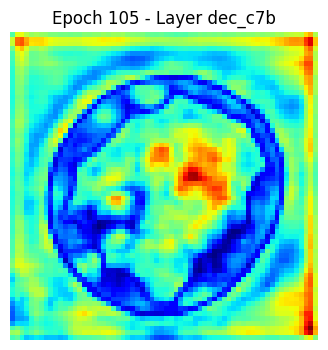

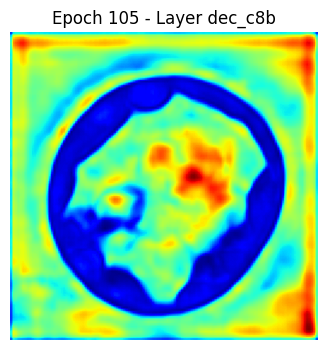

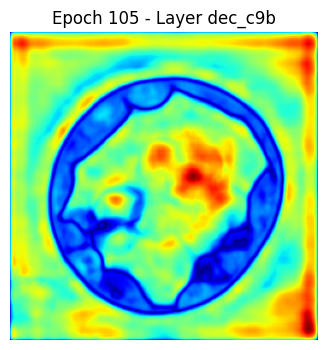

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8763 - dice_coefficient: 0.9774 - iou_metric: 0.9558 - loss: 0.0351 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8489 - val_iou_metric: 0.7435 - val_loss: 0.4558
Epoch 106/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accuracy: 0.8764 - dice_coefficient: 0.9775 - iou_metric: 0.9560 - loss: 0.0350 - val_accuracy: 0.8660 - val_dice_coefficient: 0.8493 - val_iou_metric: 0.7441 - val_loss: 0.4658
Epoch 107/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8764 - dice_coefficient: 0.9775 - iou_metric: 0.9561 - loss: 0.0349 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8484 - val_iou_metric: 0.7427 - val_loss: 0.4586
Epoch 108/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8766 - dice_coefficient: 0.9775 - iou_metric: 0.9560 - loss: 0.0350 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8473 - val_iou_metric: 0.7412 - val_loss: 0.4609
Epoch 109/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - ac

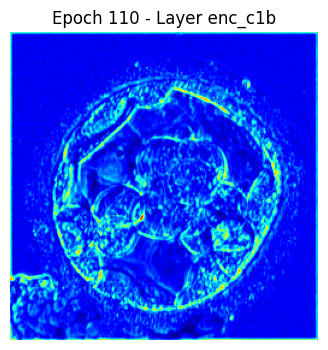

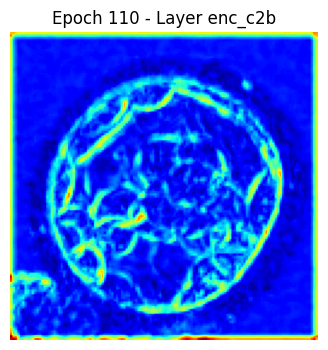

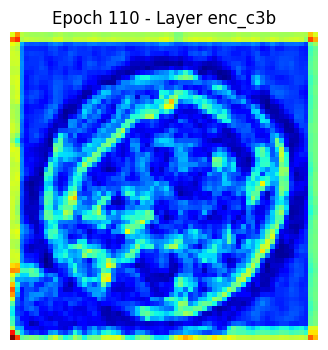

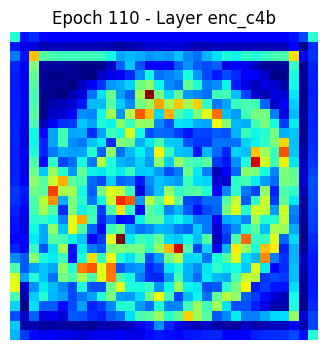

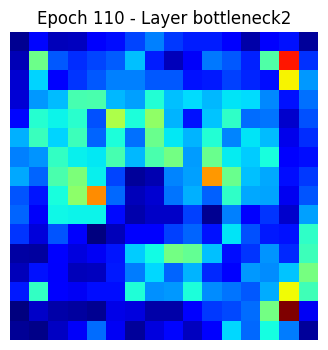

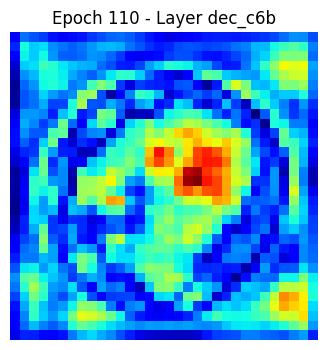

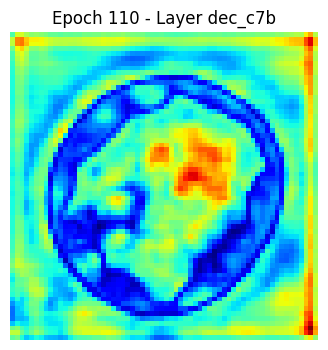

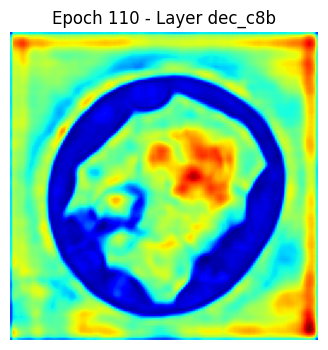

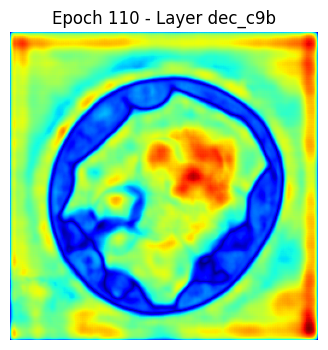

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8758 - dice_coefficient: 0.9777 - iou_metric: 0.9565 - loss: 0.0347 - val_accuracy: 0.8679 - val_dice_coefficient: 0.8463 - val_iou_metric: 0.7397 - val_loss: 0.4766
Epoch 111/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 240ms/step - accuracy: 0.8756 - dice_coefficient: 0.9778 - iou_metric: 0.9565 - loss: 0.0347 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8495 - val_iou_metric: 0.7444 - val_loss: 0.4584
Epoch 112/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8755 - dice_coefficient: 0.9778 - iou_metric: 0.9566 - loss: 0.0346 - val_accuracy: 0.8665 - val_dice_coefficient: 0.8491 - val_iou_metric: 0.7439 - val_loss: 0.4623
Epoch 113/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8769 - dice_coefficient: 0.9772 - iou_metric: 0.9555 - loss: 0.0354 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8493 - val_iou_metric: 0.7439 - val_loss: 0.4552
Epoch 114/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - ac

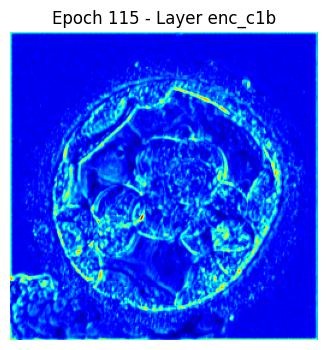

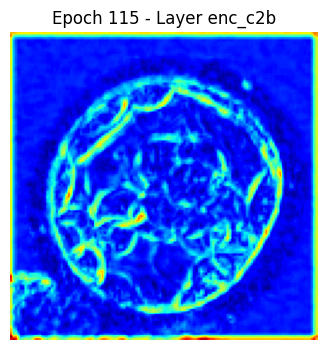

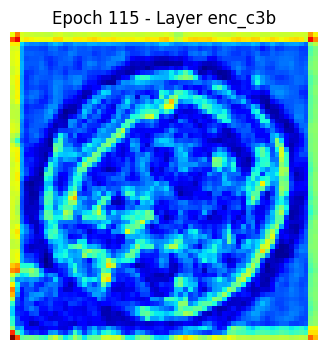

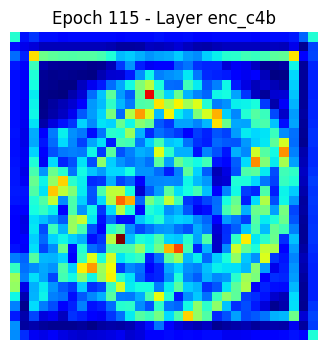

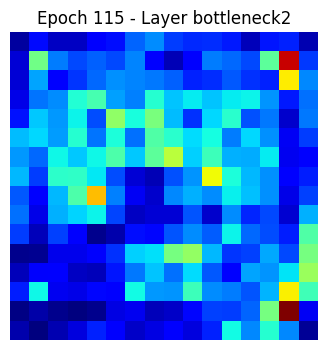

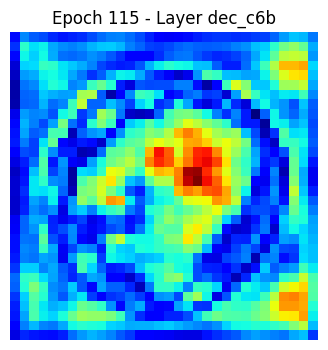

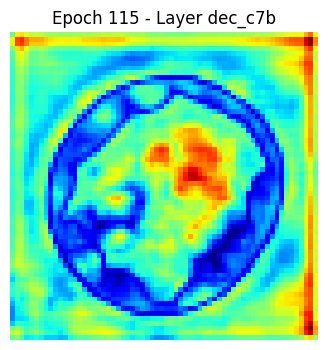

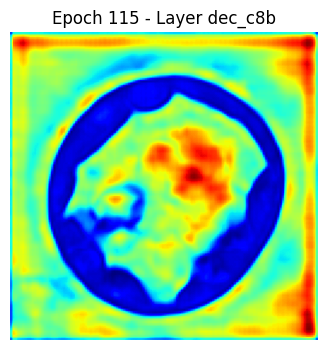

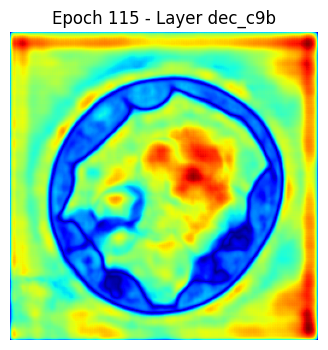

100/100 ━━━━━━━━━━━━━━━━━━━━ 25s 250ms/step - accuracy: 0.8764 - dice_coefficient: 0.9763 - iou_metric: 0.9538 - loss: 0.0367 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8495 - val_iou_metric: 0.7445 - val_loss: 0.4360
Epoch 116/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8757 - dice_coefficient: 0.9775 - iou_metric: 0.9560 - loss: 0.0349 - val_accuracy: 0.8669 - val_dice_coefficient: 0.8481 - val_iou_metric: 0.7425 - val_loss: 0.4624
Epoch 117/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8760 - dice_coefficient: 0.9777 - iou_metric: 0.9564 - loss: 0.0347 - val_accuracy: 0.8659 - val_dice_coefficient: 0.8491 - val_iou_metric: 0.7438 - val_loss: 0.4610
Epoch 118/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8762 - dice_coefficient: 0.9780 - iou_metric: 0.9570 - loss: 0.0343 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8494 - val_iou_metric: 0.7443 - val_loss: 0.4574
Epoch 119/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - ac

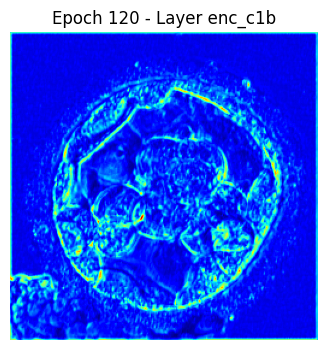

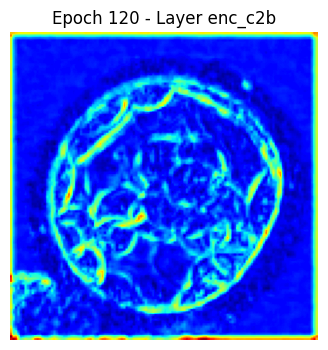

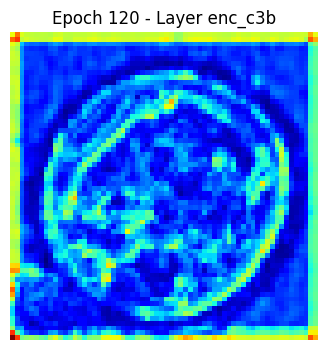

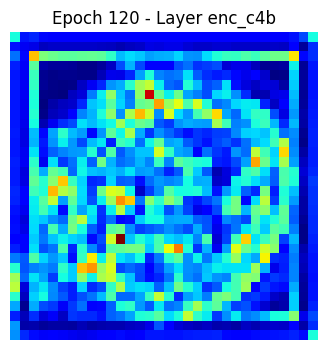

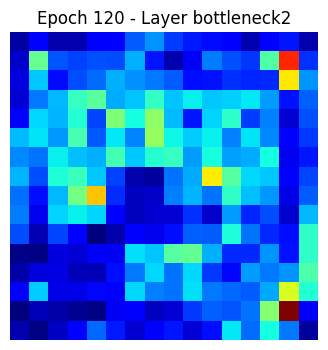

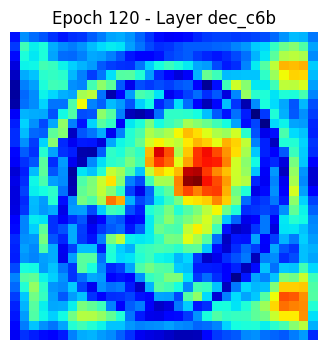

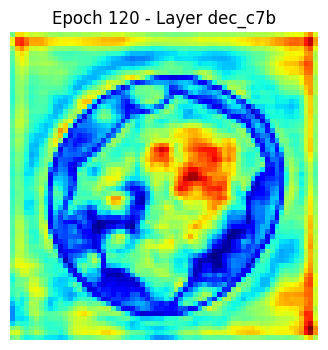

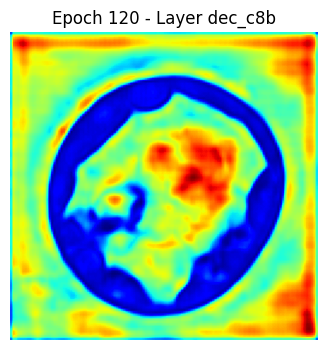

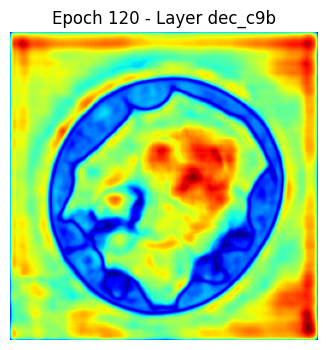

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8756 - dice_coefficient: 0.9788 - iou_metric: 0.9585 - loss: 0.0330 - val_accuracy: 0.8671 - val_dice_coefficient: 0.8490 - val_iou_metric: 0.7439 - val_loss: 0.4761
Epoch 121/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 241ms/step - accuracy: 0.8758 - dice_coefficient: 0.9786 - iou_metric: 0.9581 - loss: 0.0334 - val_accuracy: 0.8655 - val_dice_coefficient: 0.8505 - val_iou_metric: 0.7460 - val_loss: 0.4632
Epoch 122/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8755 - dice_coefficient: 0.9789 - iou_metric: 0.9587 - loss: 0.0329 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8492 - val_iou_metric: 0.7440 - val_loss: 0.4607
Epoch 123/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8757 - dice_coefficient: 0.9789 - iou_metric: 0.9588 - loss: 0.0328 - val_accuracy: 0.8673 - val_dice_coefficient: 0.8476 - val_iou_metric: 0.7416 - val_loss: 0.4753
Epoch 124/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - ac

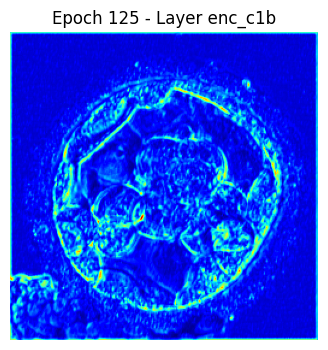

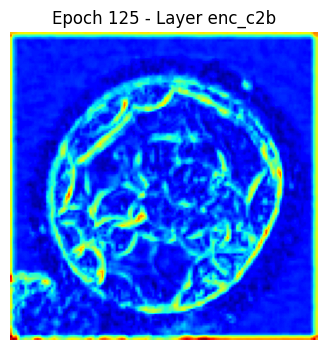

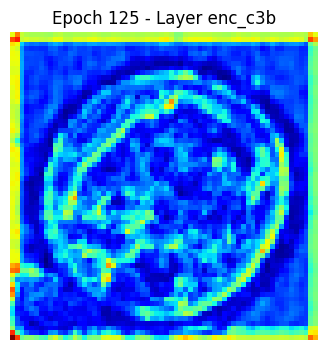

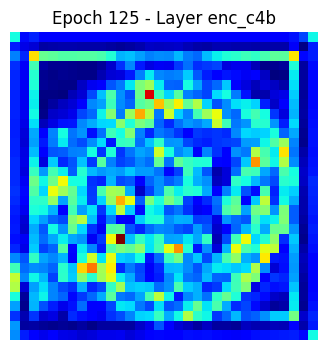

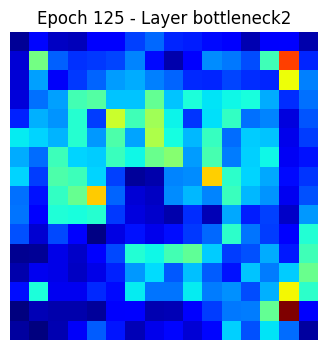

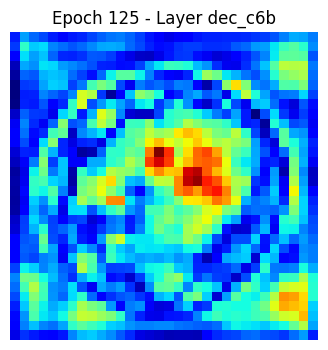

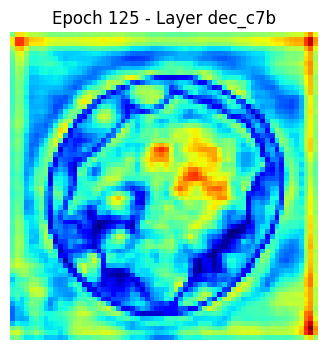

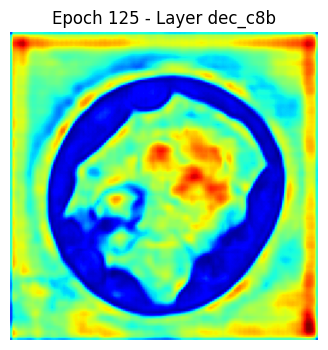

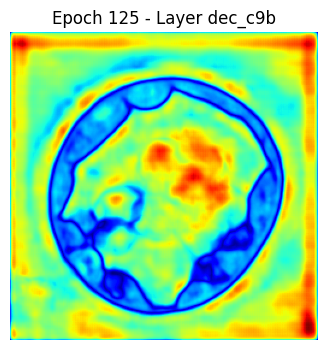

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8769 - dice_coefficient: 0.9781 - iou_metric: 0.9572 - loss: 0.0340 - val_accuracy: 0.8655 - val_dice_coefficient: 0.8498 - val_iou_metric: 0.7448 - val_loss: 0.4414
Epoch 126/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8756 - dice_coefficient: 0.9781 - iou_metric: 0.9571 - loss: 0.0342 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8487 - val_iou_metric: 0.7435 - val_loss: 0.4494
Epoch 127/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8757 - dice_coefficient: 0.9781 - iou_metric: 0.9571 - loss: 0.0342 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8493 - val_iou_metric: 0.7442 - val_loss: 0.4600
Epoch 128/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8755 - dice_coefficient: 0.9781 - iou_metric: 0.9571 - loss: 0.0342 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8488 - val_iou_metric: 0.7435 - val_loss: 0.4543
Epoch 129/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - ac

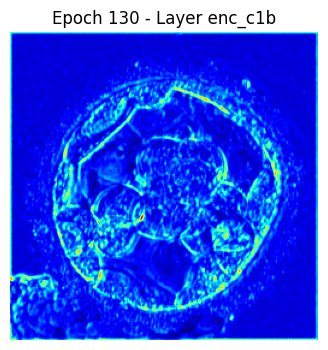

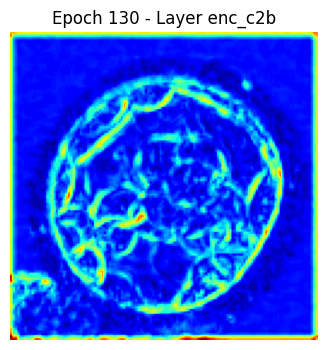

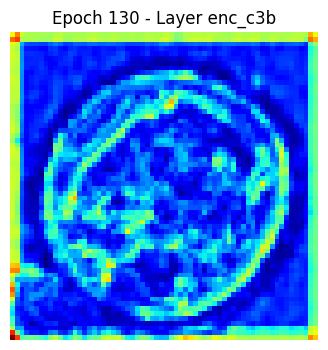

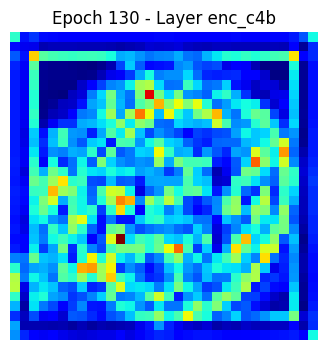

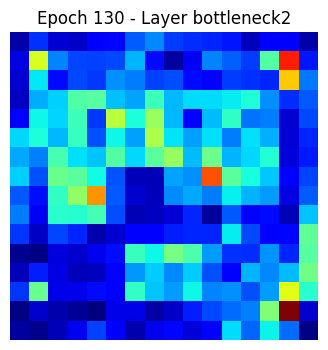

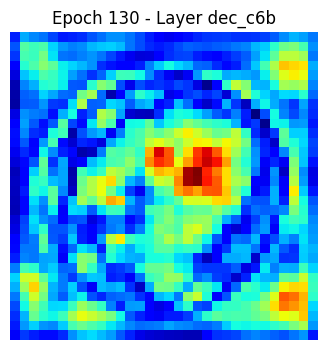

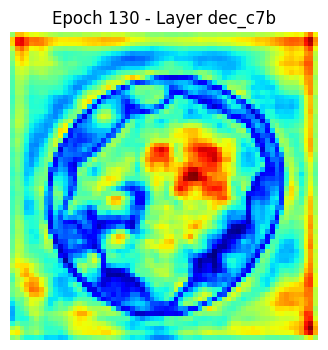

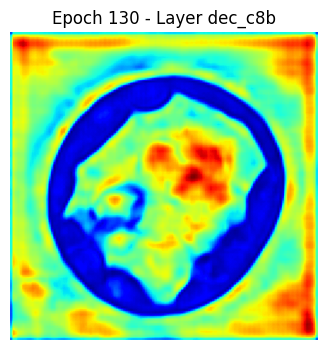

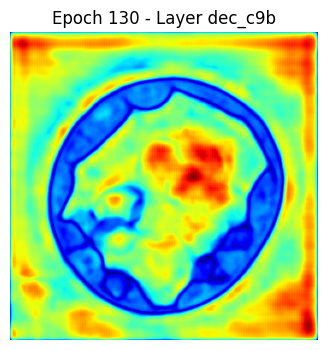

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8755 - dice_coefficient: 0.9788 - iou_metric: 0.9585 - loss: 0.0330 - val_accuracy: 0.8667 - val_dice_coefficient: 0.8486 - val_iou_metric: 0.7432 - val_loss: 0.4685
Epoch 131/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8758 - dice_coefficient: 0.9786 - iou_metric: 0.9581 - loss: 0.0333 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8492 - val_iou_metric: 0.7440 - val_loss: 0.4638


Model: "UNet_with_SCAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ SCAB                │ [(None, 256, 256, │     10,415 │ enc_c1b[0][0],    │
│ (SCAttentionBridge) │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,123,026 (355.24 MB)

 Trainable params: 31,041,008 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,082,018 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 2: 3087.70s

--- Fold 3 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 54s 341ms/step - accuracy: 0.8725 - dice_coefficient: 0.1917 - iou_metric: 0.1074 - loss: 1.2557 - val_accuracy: 0.7975 - val_dice_coefficient: 0.5691 - val_iou_metric: 0.3990 - val_loss: 0.6455
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8202 - dice_coefficient: 0.6100 - iou_metric: 0.4400 - loss: 0.6056 - val_accuracy: 0.8369 - val_dice_coefficient: 0.6383 - val_iou_metric: 0.4705 - val_loss: 0.5322
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8364 - dice_coefficient: 0.6774 - iou_metric: 0.5129 - loss: 0.5035 - val_accuracy: 0.8436 - val_dice_coefficient: 0.6972 - val_iou_metric: 0.5374 - val_loss: 0.4856
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8407 - dice_coefficient: 0.7158 - iou_metric: 0.5583 - loss: 0.4507 - val_accuracy: 0.8542

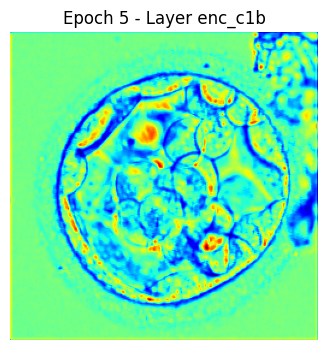

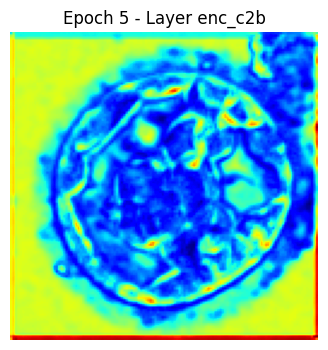

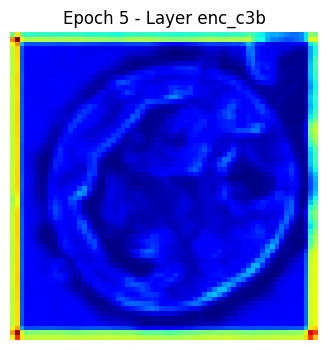

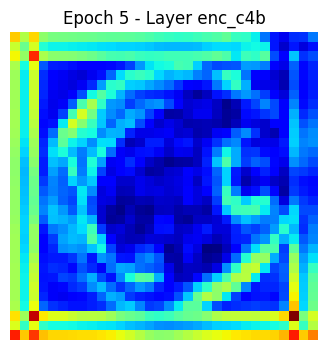

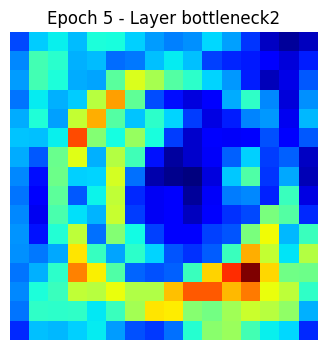

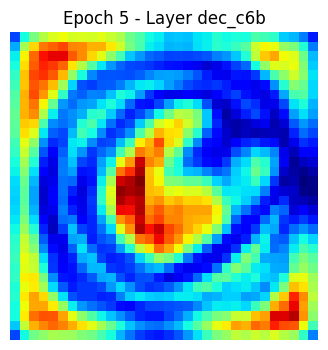

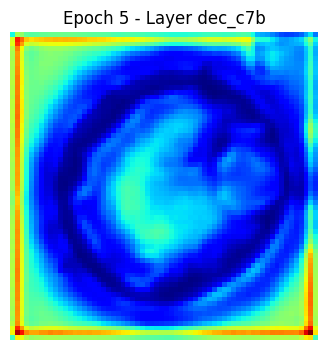

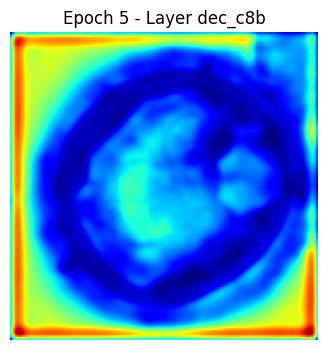

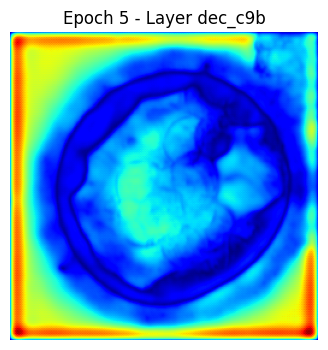

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8456 - dice_coefficient: 0.7468 - iou_metric: 0.5968 - loss: 0.3991 - val_accuracy: 0.8570 - val_dice_coefficient: 0.7391 - val_iou_metric: 0.5894 - val_loss: 0.3913
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8505 - dice_coefficient: 0.7697 - iou_metric: 0.6266 - loss: 0.3632 - val_accuracy: 0.8526 - val_dice_coefficient: 0.7434 - val_iou_metric: 0.5946 - val_loss: 0.3879
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 230ms/step - accuracy: 0.8511 - dice_coefficient: 0.7822 - iou_metric: 0.6431 - loss: 0.3448 - val_accuracy: 0.8574 - val_dice_coefficient: 0.7614 - val_iou_metric: 0.6181 - val_loss: 0.3623
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8514 - dice_coefficient: 0.7881 - iou_metric: 0.6515 - loss: 0.3390 - val_accuracy: 0.8604 - val_dice_coefficient: 0.7359 - val_iou_metric: 0.5852 - val_loss: 0.3947
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 

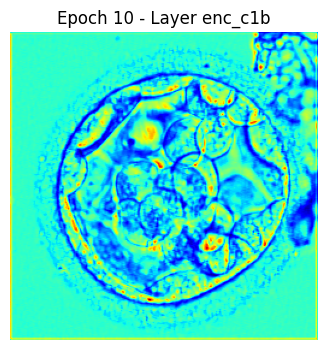

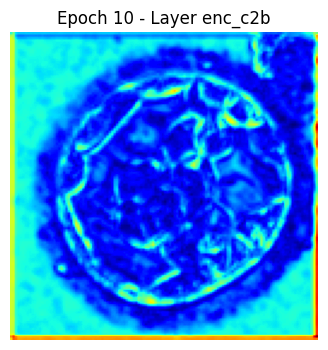

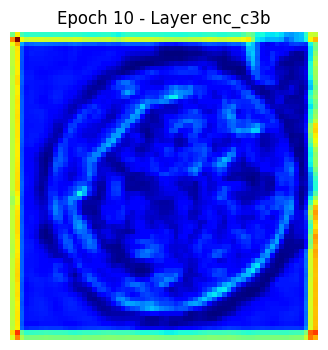

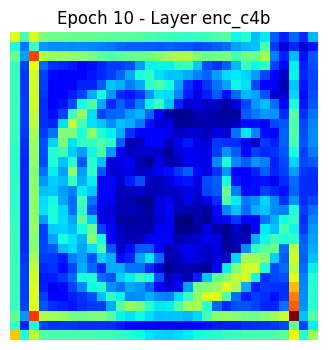

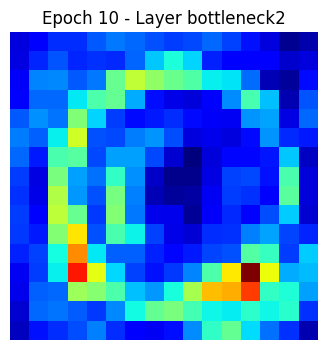

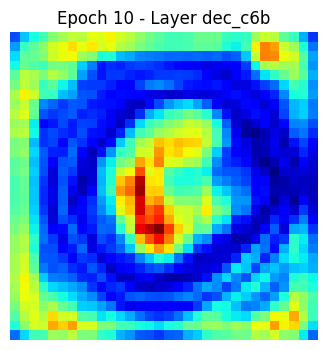

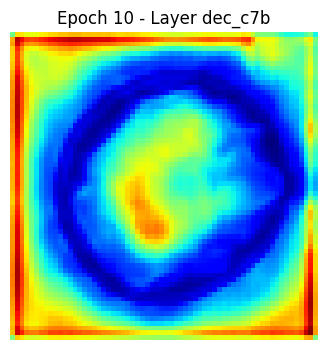

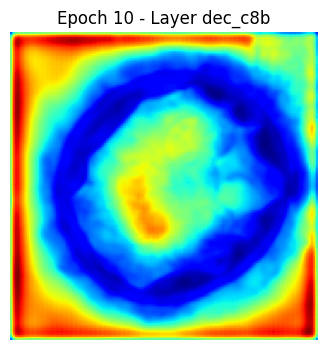

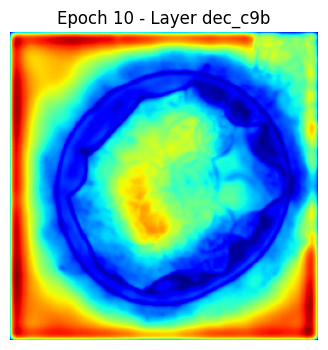

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 237ms/step - accuracy: 0.8543 - dice_coefficient: 0.8071 - iou_metric: 0.6776 - loss: 0.3058 - val_accuracy: 0.8666 - val_dice_coefficient: 0.7739 - val_iou_metric: 0.6351 - val_loss: 0.3486
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8554 - dice_coefficient: 0.8153 - iou_metric: 0.6892 - loss: 0.2941 - val_accuracy: 0.8615 - val_dice_coefficient: 0.7711 - val_iou_metric: 0.6309 - val_loss: 0.3391
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8557 - dice_coefficient: 0.8203 - iou_metric: 0.6962 - loss: 0.2866 - val_accuracy: 0.8707 - val_dice_coefficient: 0.7694 - val_iou_metric: 0.6293 - val_loss: 0.3529
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8569 - dice_coefficient: 0.8272 - iou_metric: 0.7063 - loss: 0.2770 - val_accuracy: 0.8590 - val_dice_coefficient: 0.8025 - val_iou_metric: 0.6741 - val_loss: 0.3180
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

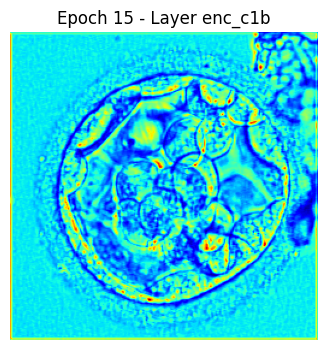

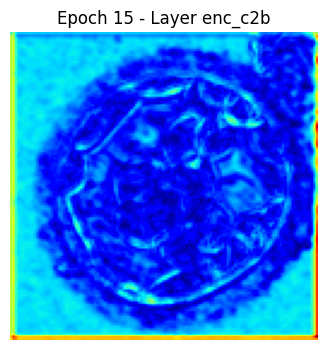

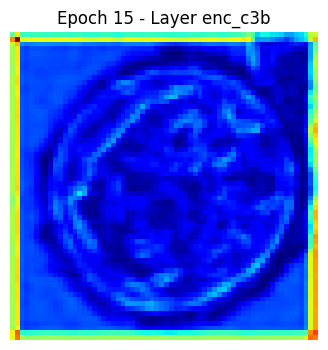

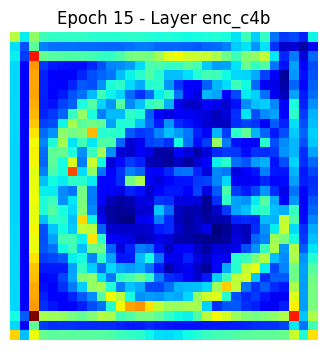

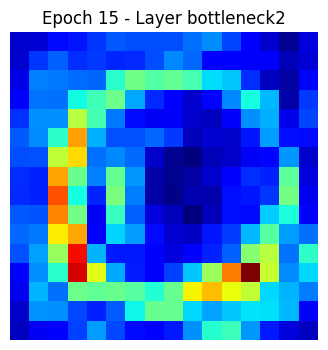

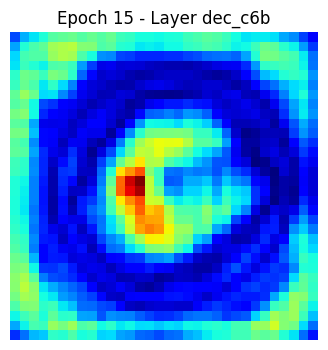

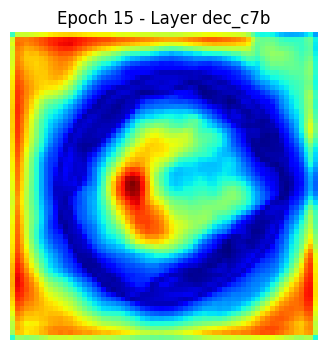

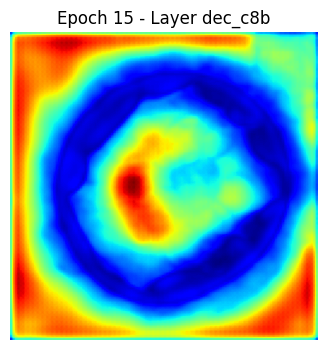

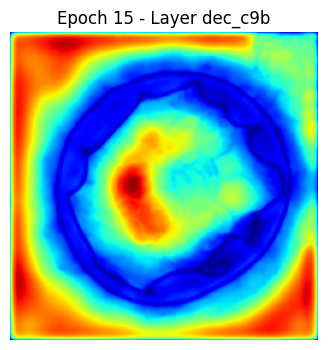

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 237ms/step - accuracy: 0.8588 - dice_coefficient: 0.8466 - iou_metric: 0.7348 - loss: 0.2473 - val_accuracy: 0.8661 - val_dice_coefficient: 0.8104 - val_iou_metric: 0.6856 - val_loss: 0.3082
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8601 - dice_coefficient: 0.8486 - iou_metric: 0.7378 - loss: 0.2425 - val_accuracy: 0.8660 - val_dice_coefficient: 0.7990 - val_iou_metric: 0.6692 - val_loss: 0.3069
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8602 - dice_coefficient: 0.8528 - iou_metric: 0.7443 - loss: 0.2341 - val_accuracy: 0.8691 - val_dice_coefficient: 0.8098 - val_iou_metric: 0.6852 - val_loss: 0.3127
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8623 - dice_coefficient: 0.8618 - iou_metric: 0.7578 - loss: 0.2232 - val_accuracy: 0.8682 - val_dice_coefficient: 0.7787 - val_iou_metric: 0.6417 - val_loss: 0.3444
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

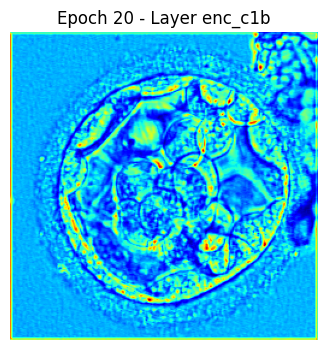

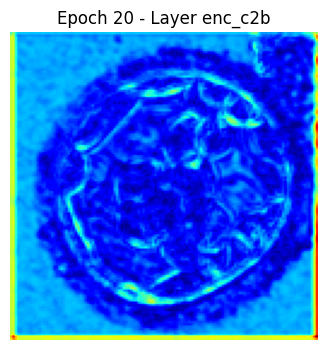

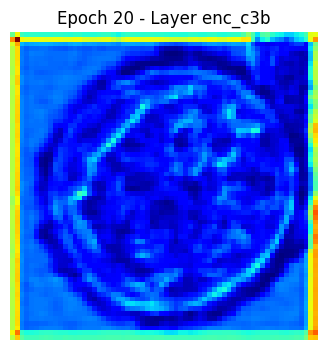

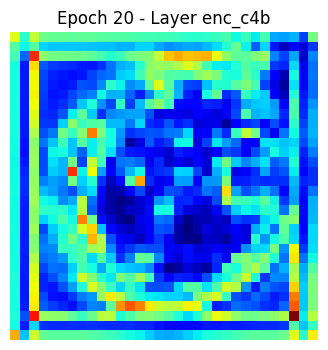

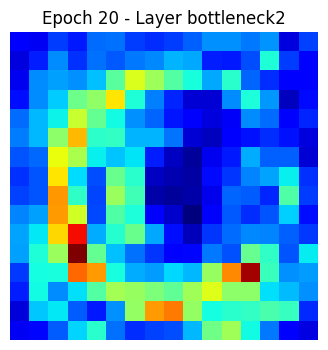

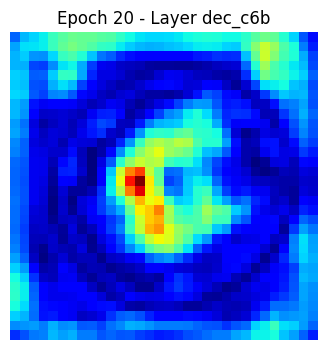

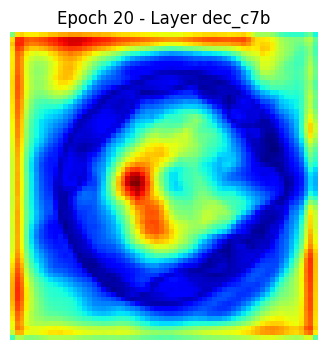

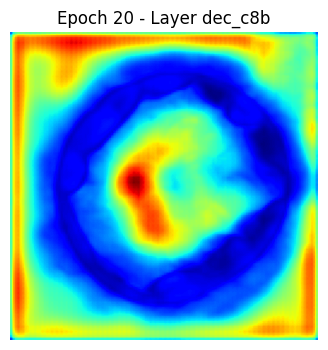

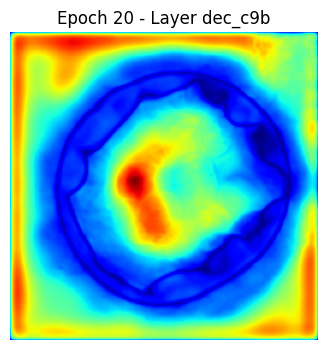

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8636 - dice_coefficient: 0.8690 - iou_metric: 0.7695 - loss: 0.2104 - val_accuracy: 0.8681 - val_dice_coefficient: 0.8132 - val_iou_metric: 0.6894 - val_loss: 0.3096
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8638 - dice_coefficient: 0.8745 - iou_metric: 0.7779 - loss: 0.2010 - val_accuracy: 0.8672 - val_dice_coefficient: 0.8148 - val_iou_metric: 0.6913 - val_loss: 0.3032
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8652 - dice_coefficient: 0.8856 - iou_metric: 0.7954 - loss: 0.1849 - val_accuracy: 0.8639 - val_dice_coefficient: 0.8217 - val_iou_metric: 0.7017 - val_loss: 0.3080
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8659 - dice_coefficient: 0.8883 - iou_metric: 0.7999 - loss: 0.1813 - val_accuracy: 0.8652 - val_dice_coefficient: 0.7860 - val_iou_metric: 0.6508 - val_loss: 0.3349
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

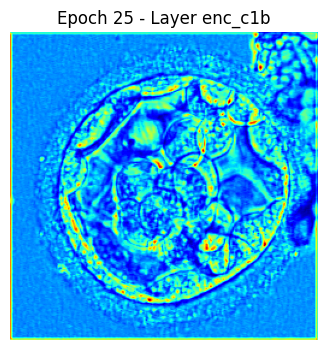

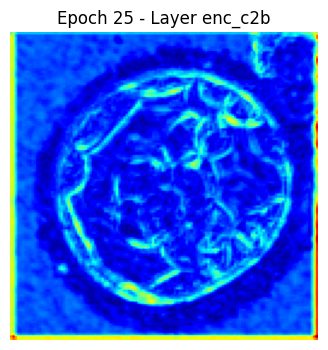

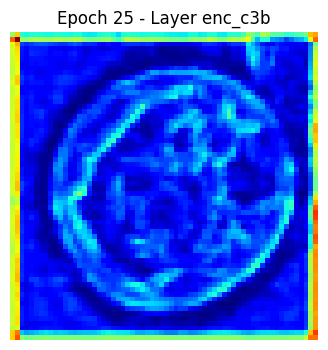

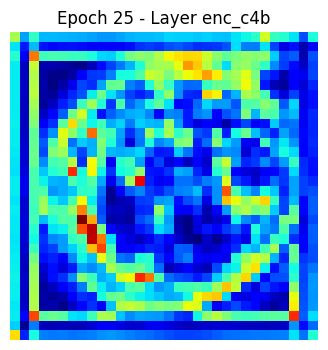

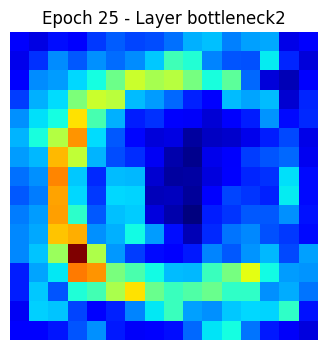

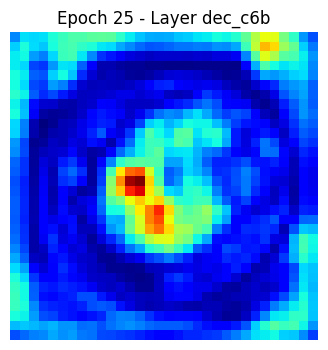

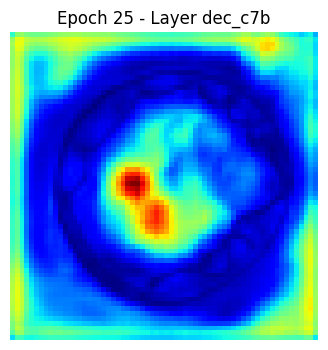

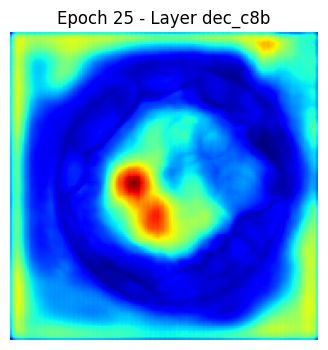

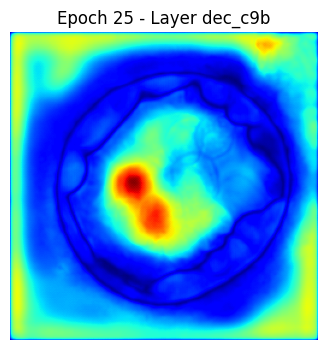

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8676 - dice_coefficient: 0.8938 - iou_metric: 0.8085 - loss: 0.1687 - val_accuracy: 0.8574 - val_dice_coefficient: 0.7872 - val_iou_metric: 0.6521 - val_loss: 0.3457
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8669 - dice_coefficient: 0.8967 - iou_metric: 0.8134 - loss: 0.1643 - val_accuracy: 0.8668 - val_dice_coefficient: 0.8141 - val_iou_metric: 0.6906 - val_loss: 0.3199
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8672 - dice_coefficient: 0.9041 - iou_metric: 0.8255 - loss: 0.1530 - val_accuracy: 0.8687 - val_dice_coefficient: 0.8094 - val_iou_metric: 0.6840 - val_loss: 0.3146
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8680 - dice_coefficient: 0.9076 - iou_metric: 0.8313 - loss: 0.1470 - val_accuracy: 0.8672 - val_dice_coefficient: 0.7977 - val_iou_metric: 0.6668 - val_loss: 0.3384
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

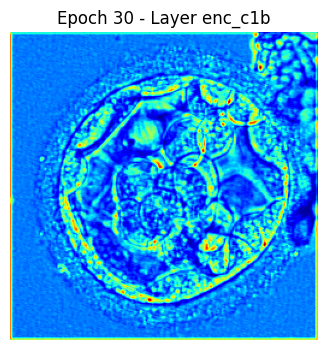

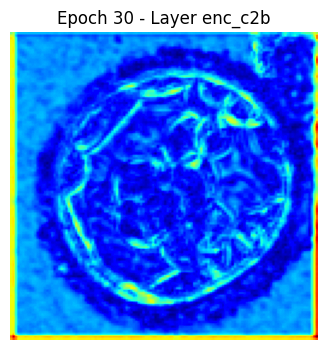

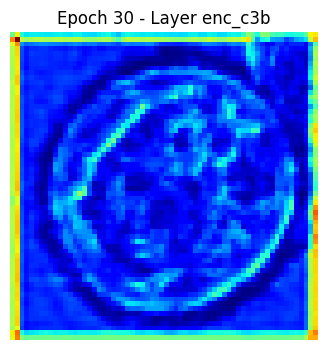

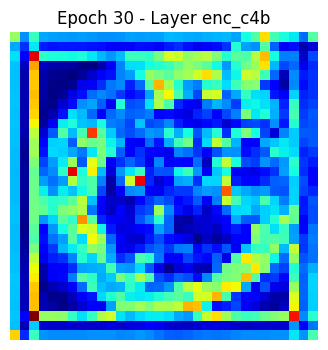

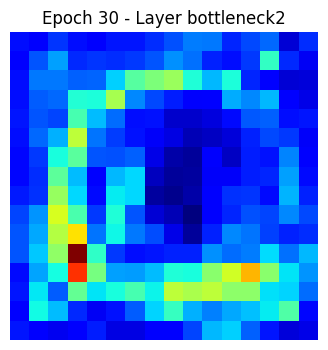

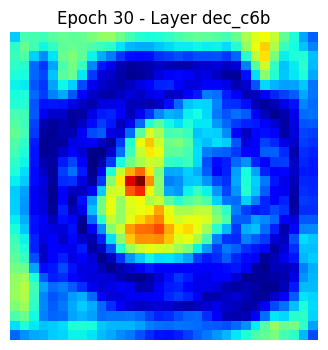

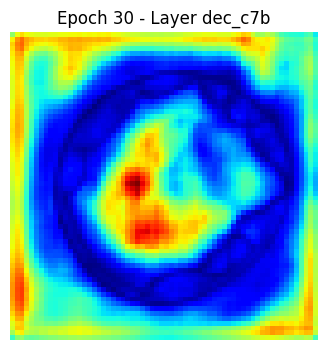

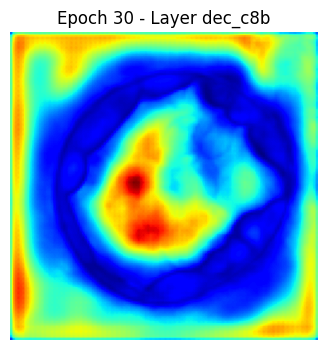

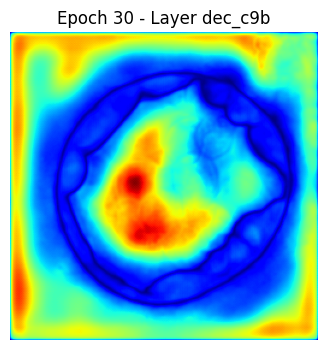

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8685 - dice_coefficient: 0.9136 - iou_metric: 0.8413 - loss: 0.1375 - val_accuracy: 0.8674 - val_dice_coefficient: 0.8067 - val_iou_metric: 0.6797 - val_loss: 0.3347
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8694 - dice_coefficient: 0.9177 - iou_metric: 0.8483 - loss: 0.1309 - val_accuracy: 0.8652 - val_dice_coefficient: 0.8203 - val_iou_metric: 0.6990 - val_loss: 0.3218
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8695 - dice_coefficient: 0.9195 - iou_metric: 0.8513 - loss: 0.1277 - val_accuracy: 0.8697 - val_dice_coefficient: 0.8170 - val_iou_metric: 0.6950 - val_loss: 0.3434


Model: "UNet_with_SCAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ SCAB                │ [(None, 256, 256, │     10,415 │ enc_c1b[0][0],    │
│ (SCAttentionBridge) │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,123,026 (355.24 MB)

 Trainable params: 31,041,008 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,082,018 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 3: 769.67s

--- Fold 4 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 55s 336ms/step - accuracy: 0.8713 - dice_coefficient: 0.1924 - iou_metric: 0.1069 - loss: 1.2556 - val_accuracy: 0.8198 - val_dice_coefficient: 0.4503 - val_iou_metric: 0.2921 - val_loss: 0.7894
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8073 - dice_coefficient: 0.5599 - iou_metric: 0.3903 - loss: 0.6786 - val_accuracy: 0.8580 - val_dice_coefficient: 0.5641 - val_iou_metric: 0.3953 - val_loss: 0.6104
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8285 - dice_coefficient: 0.6383 - iou_metric: 0.4704 - loss: 0.5611 - val_accuracy: 0.8402 - val_dice_coefficient: 0.6617 - val_iou_metric: 0.4980 - val_loss: 0.5186
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8389 - dice_coefficient: 0.6977 - iou_metric: 0.5363 - loss: 0.4791 - val_accuracy: 0.8515 

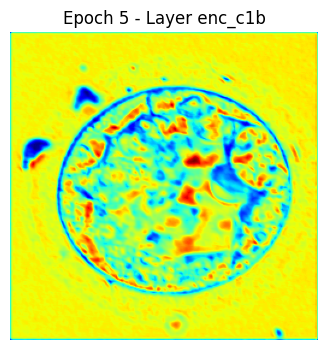

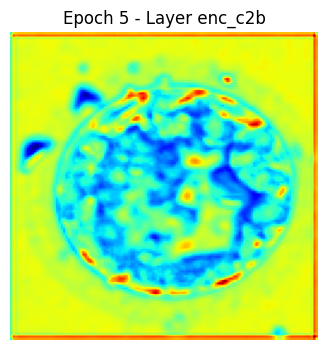

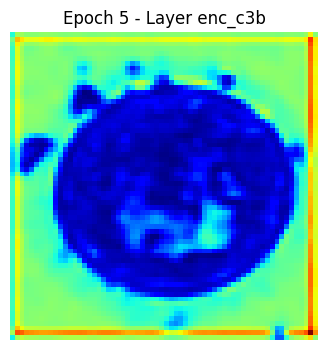

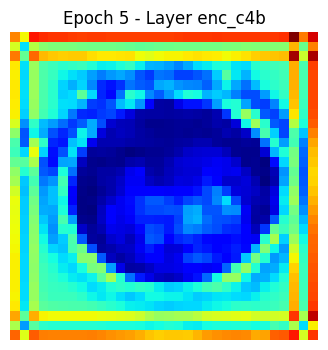

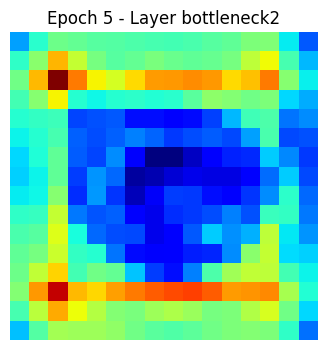

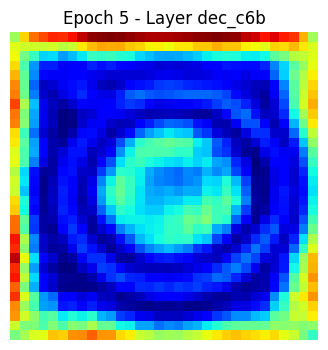

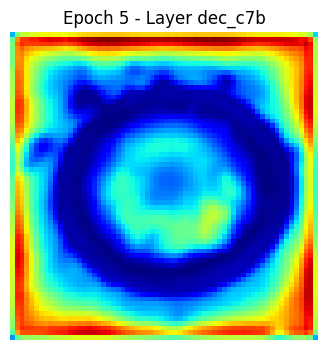

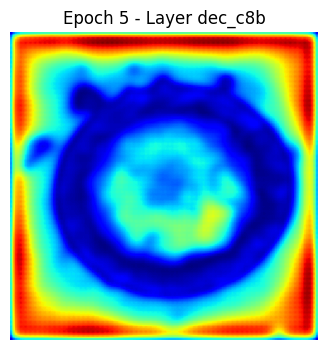

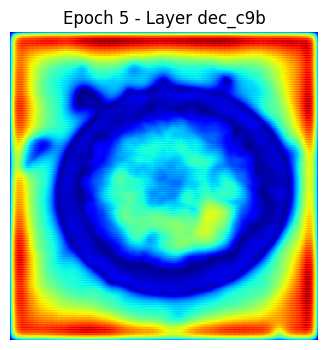

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8413 - dice_coefficient: 0.7084 - iou_metric: 0.5493 - loss: 0.4600 - val_accuracy: 0.8507 - val_dice_coefficient: 0.7270 - val_iou_metric: 0.5764 - val_loss: 0.4387
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8438 - dice_coefficient: 0.7415 - iou_metric: 0.5900 - loss: 0.4100 - val_accuracy: 0.8637 - val_dice_coefficient: 0.7143 - val_iou_metric: 0.5620 - val_loss: 0.4403
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8503 - dice_coefficient: 0.7626 - iou_metric: 0.6173 - loss: 0.3756 - val_accuracy: 0.8565 - val_dice_coefficient: 0.7403 - val_iou_metric: 0.5940 - val_loss: 0.3976
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8516 - dice_coefficient: 0.7743 - iou_metric: 0.6323 - loss: 0.3570 - val_accuracy: 0.8575 - val_dice_coefficient: 0.7508 - val_iou_metric: 0.6076 - val_loss: 0.3842
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 

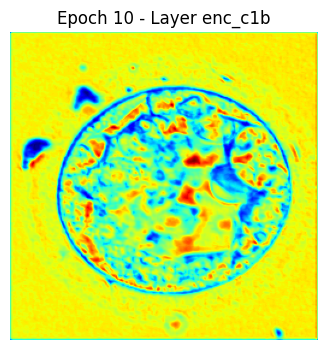

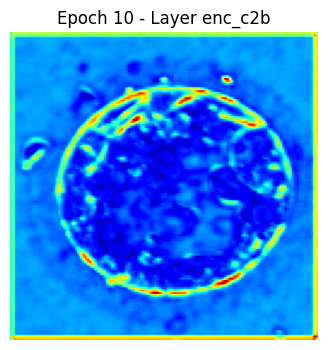

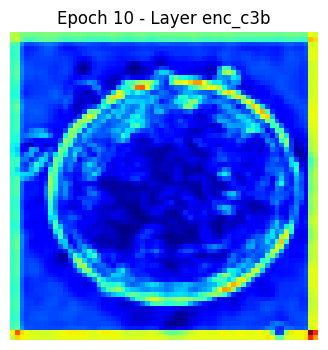

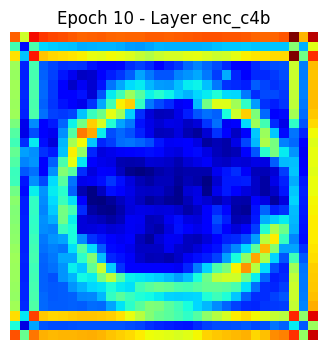

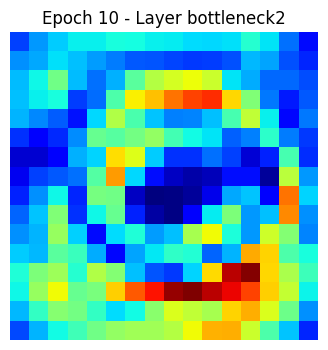

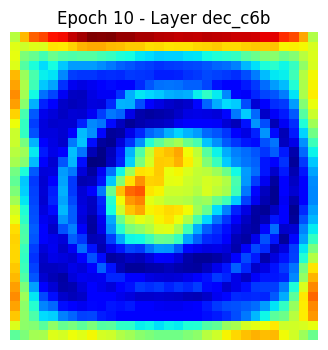

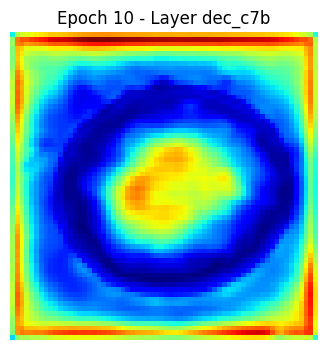

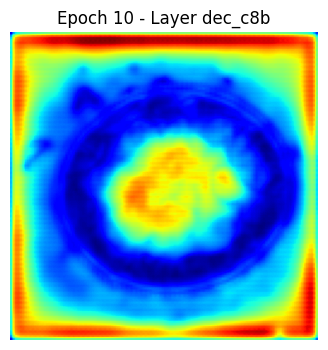

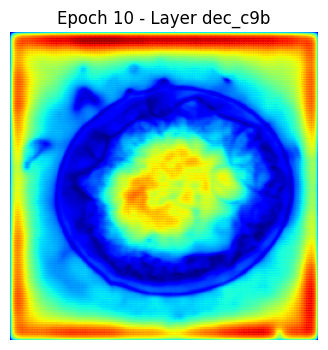

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8522 - dice_coefficient: 0.7892 - iou_metric: 0.6526 - loss: 0.3340 - val_accuracy: 0.8633 - val_dice_coefficient: 0.7329 - val_iou_metric: 0.5847 - val_loss: 0.3860
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8554 - dice_coefficient: 0.8008 - iou_metric: 0.6688 - loss: 0.3155 - val_accuracy: 0.8625 - val_dice_coefficient: 0.7668 - val_iou_metric: 0.6291 - val_loss: 0.3667
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8558 - dice_coefficient: 0.8112 - iou_metric: 0.6830 - loss: 0.3031 - val_accuracy: 0.8679 - val_dice_coefficient: 0.7679 - val_iou_metric: 0.6312 - val_loss: 0.3588
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8570 - dice_coefficient: 0.8164 - iou_metric: 0.6907 - loss: 0.2913 - val_accuracy: 0.8608 - val_dice_coefficient: 0.7717 - val_iou_metric: 0.6351 - val_loss: 0.3443
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

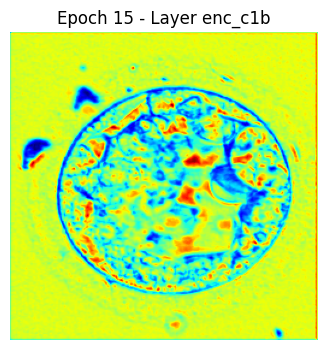

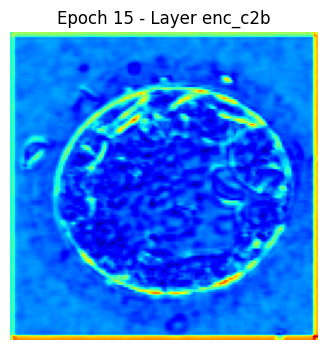

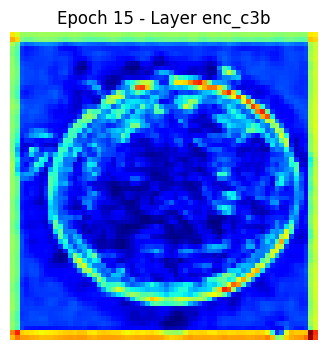

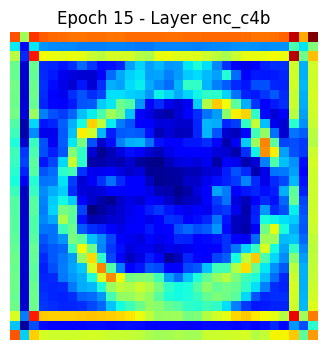

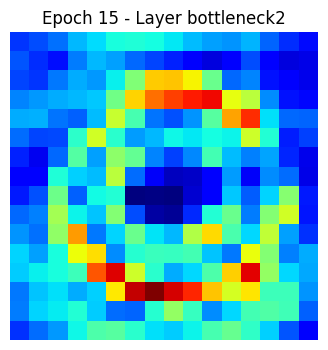

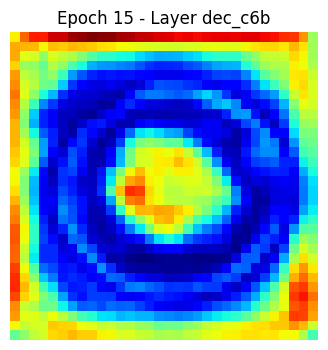

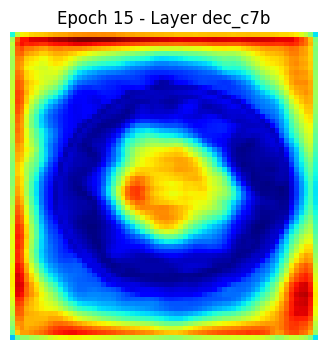

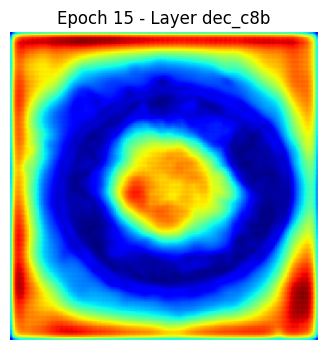

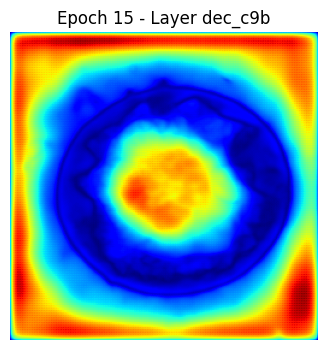

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 237ms/step - accuracy: 0.8582 - dice_coefficient: 0.8351 - iou_metric: 0.7180 - loss: 0.2675 - val_accuracy: 0.8647 - val_dice_coefficient: 0.8016 - val_iou_metric: 0.6778 - val_loss: 0.3414
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8589 - dice_coefficient: 0.8381 - iou_metric: 0.7222 - loss: 0.2623 - val_accuracy: 0.8698 - val_dice_coefficient: 0.7902 - val_iou_metric: 0.6617 - val_loss: 0.3285
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8602 - dice_coefficient: 0.8461 - iou_metric: 0.7340 - loss: 0.2478 - val_accuracy: 0.8662 - val_dice_coefficient: 0.7964 - val_iou_metric: 0.6695 - val_loss: 0.3172
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8613 - dice_coefficient: 0.8462 - iou_metric: 0.7343 - loss: 0.2444 - val_accuracy: 0.8644 - val_dice_coefficient: 0.7913 - val_iou_metric: 0.6628 - val_loss: 0.3257
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accura

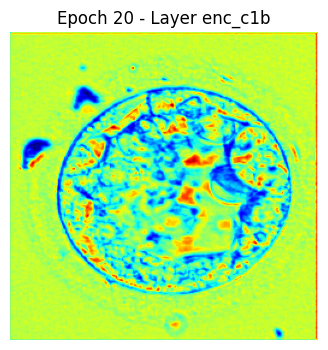

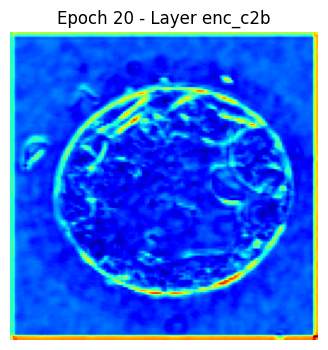

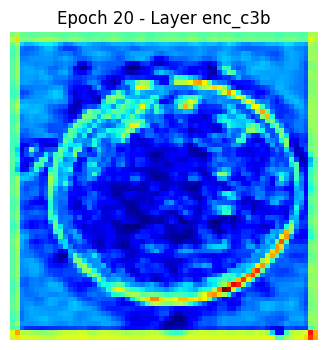

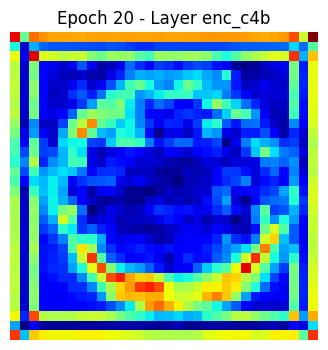

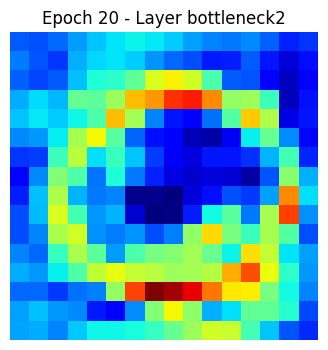

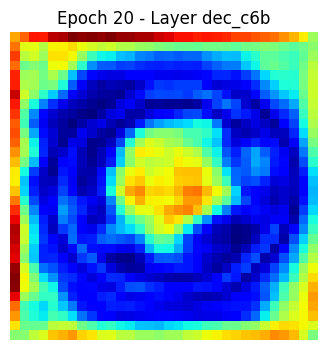

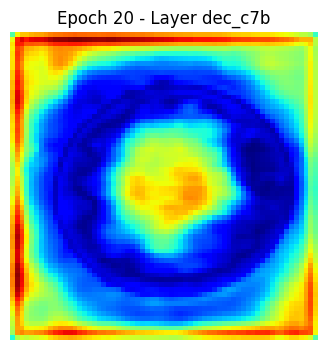

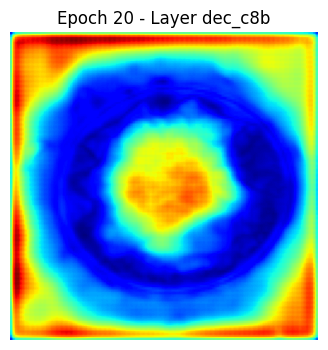

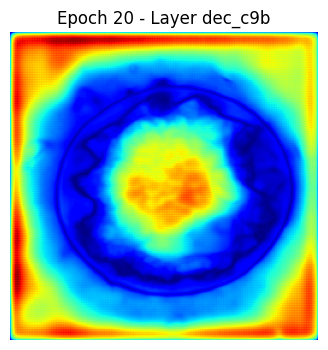

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8633 - dice_coefficient: 0.8648 - iou_metric: 0.7628 - loss: 0.2182 - val_accuracy: 0.8675 - val_dice_coefficient: 0.7903 - val_iou_metric: 0.6610 - val_loss: 0.3217
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8638 - dice_coefficient: 0.8635 - iou_metric: 0.7608 - loss: 0.2168 - val_accuracy: 0.8660 - val_dice_coefficient: 0.7974 - val_iou_metric: 0.6711 - val_loss: 0.3228
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8639 - dice_coefficient: 0.8674 - iou_metric: 0.7665 - loss: 0.2109 - val_accuracy: 0.8651 - val_dice_coefficient: 0.7951 - val_iou_metric: 0.6680 - val_loss: 0.3244
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8653 - dice_coefficient: 0.8789 - iou_metric: 0.7846 - loss: 0.1933 - val_accuracy: 0.8643 - val_dice_coefficient: 0.7994 - val_iou_metric: 0.6738 - val_loss: 0.3478
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

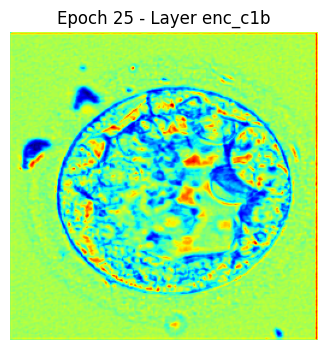

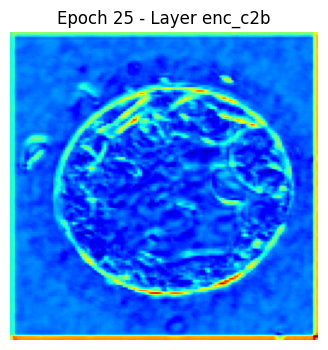

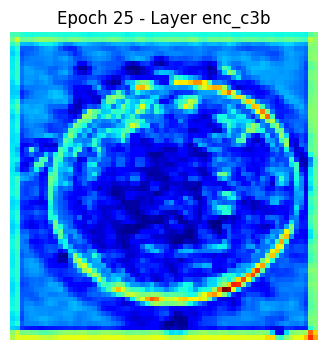

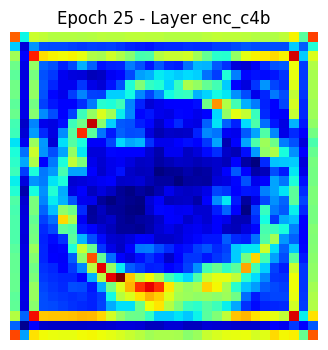

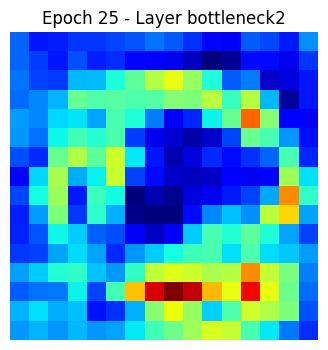

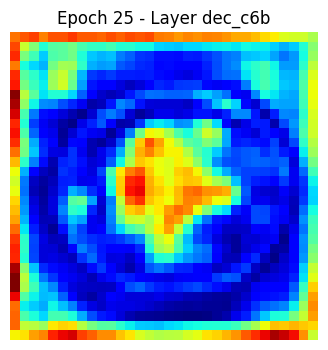

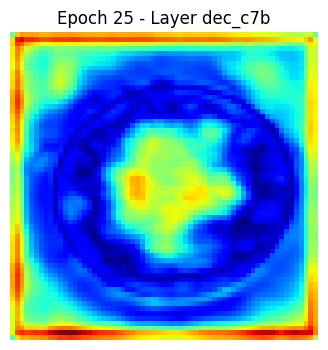

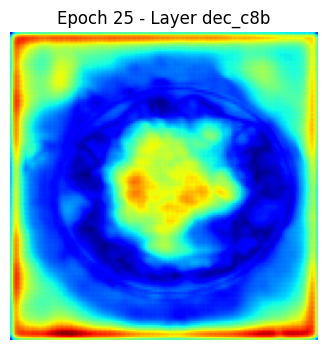

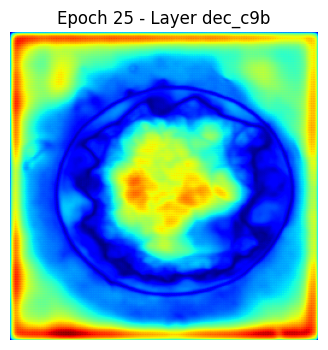

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8660 - dice_coefficient: 0.8892 - iou_metric: 0.8011 - loss: 0.1778 - val_accuracy: 0.8634 - val_dice_coefficient: 0.7968 - val_iou_metric: 0.6691 - val_loss: 0.3288
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8661 - dice_coefficient: 0.8872 - iou_metric: 0.7978 - loss: 0.1800 - val_accuracy: 0.8681 - val_dice_coefficient: 0.8031 - val_iou_metric: 0.6781 - val_loss: 0.3380
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8670 - dice_coefficient: 0.8975 - iou_metric: 0.8146 - loss: 0.1654 - val_accuracy: 0.8624 - val_dice_coefficient: 0.8026 - val_iou_metric: 0.6771 - val_loss: 0.3282
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8669 - dice_coefficient: 0.9010 - iou_metric: 0.8202 - loss: 0.1582 - val_accuracy: 0.8562 - val_dice_coefficient: 0.7929 - val_iou_metric: 0.6633 - val_loss: 0.3578
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accura

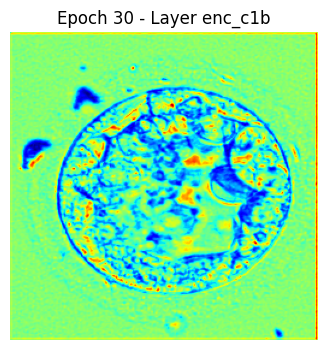

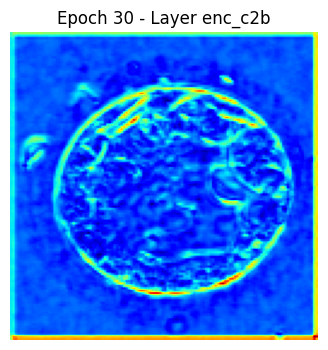

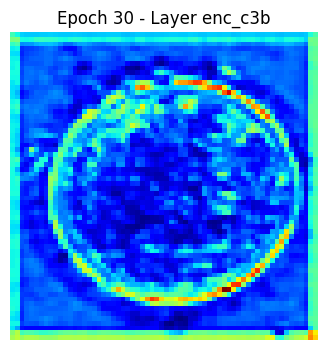

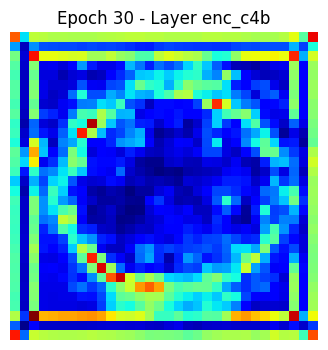

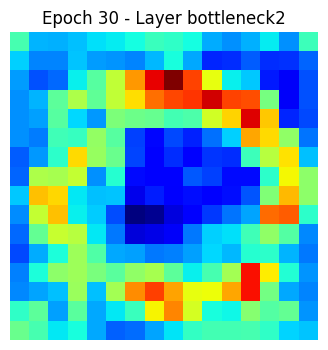

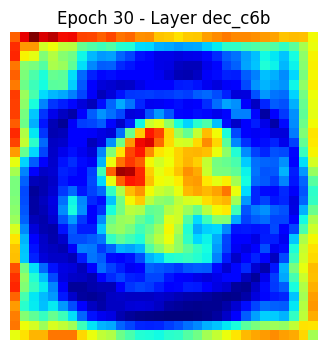

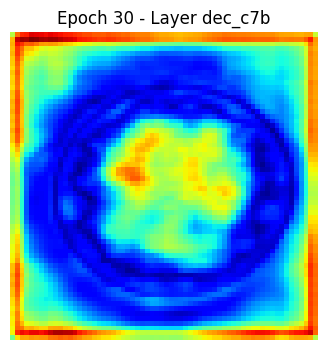

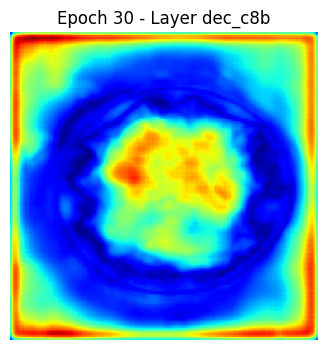

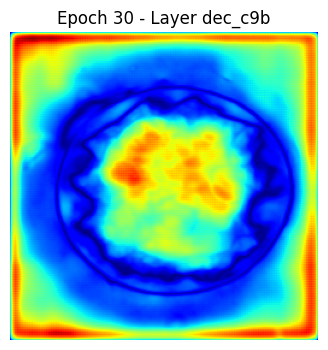

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8682 - dice_coefficient: 0.9084 - iou_metric: 0.8326 - loss: 0.1498 - val_accuracy: 0.8674 - val_dice_coefficient: 0.7919 - val_iou_metric: 0.6626 - val_loss: 0.3457
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8694 - dice_coefficient: 0.9056 - iou_metric: 0.8281 - loss: 0.1489 - val_accuracy: 0.8679 - val_dice_coefficient: 0.8164 - val_iou_metric: 0.6979 - val_loss: 0.3418
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8695 - dice_coefficient: 0.9150 - iou_metric: 0.8436 - loss: 0.1375 - val_accuracy: 0.8646 - val_dice_coefficient: 0.8134 - val_iou_metric: 0.6929 - val_loss: 0.3269
Epoch 33/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8698 - dice_coefficient: 0.9176 - iou_metric: 0.8481 - loss: 0.1320 - val_accuracy: 0.8663 - val_dice_coefficient: 0.8104 - val_iou_metric: 0.6890 - val_loss: 0.3366
Epoch 34/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

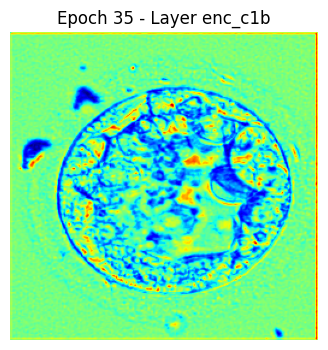

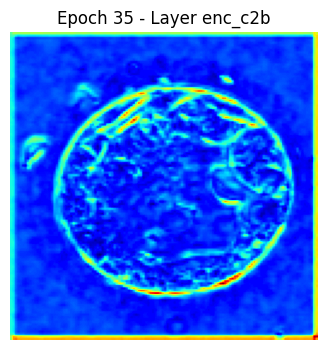

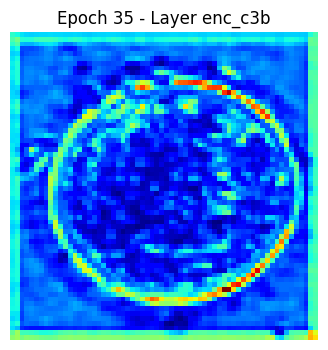

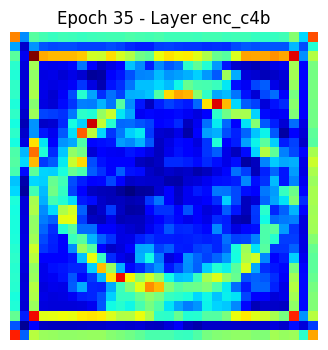

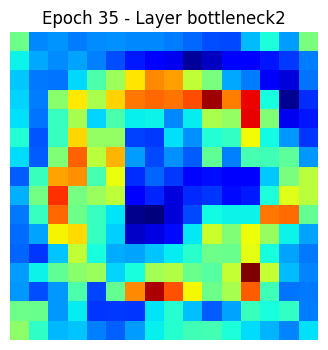

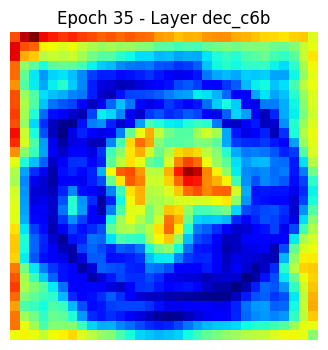

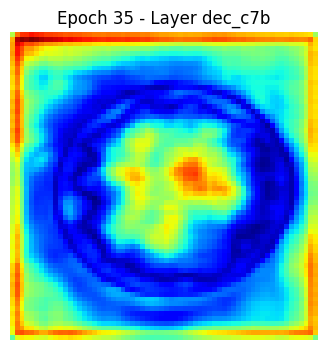

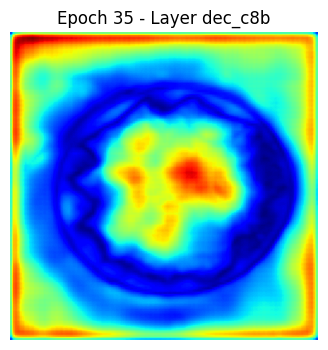

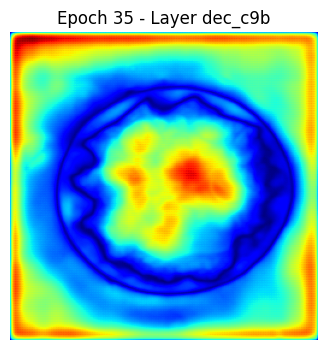

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8688 - dice_coefficient: 0.9212 - iou_metric: 0.8542 - loss: 0.1250 - val_accuracy: 0.8693 - val_dice_coefficient: 0.8125 - val_iou_metric: 0.6934 - val_loss: 0.3433
Epoch 36/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8706 - dice_coefficient: 0.9239 - iou_metric: 0.8588 - loss: 0.1204 - val_accuracy: 0.8683 - val_dice_coefficient: 0.8064 - val_iou_metric: 0.6837 - val_loss: 0.3503
Epoch 37/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8707 - dice_coefficient: 0.9256 - iou_metric: 0.8617 - loss: 0.1178 - val_accuracy: 0.8672 - val_dice_coefficient: 0.8077 - val_iou_metric: 0.6855 - val_loss: 0.3450
Epoch 38/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8709 - dice_coefficient: 0.9270 - iou_metric: 0.8642 - loss: 0.1148 - val_accuracy: 0.8695 - val_dice_coefficient: 0.8056 - val_iou_metric: 0.6825 - val_loss: 0.3667
Epoch 39/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

Model: "UNet_with_SCAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ SCAB                │ [(None, 256, 256, │     10,415 │ enc_c1b[0][0],    │
│ (SCAttentionBridge) │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,123,026 (355.24 MB)

 Trainable params: 31,041,008 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,082,018 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 4: 931.17s

--- Fold 5 ---
Epoch 1/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 55s 338ms/step - accuracy: 0.7901 - dice_coefficient: 0.2125 - iou_metric: 0.1227 - loss: 1.2575 - val_accuracy: 0.8450 - val_dice_coefficient: 0.5705 - val_iou_metric: 0.4001 - val_loss: 0.6272
Epoch 2/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8296 - dice_coefficient: 0.6301 - iou_metric: 0.4609 - loss: 0.5727 - val_accuracy: 0.8465 - val_dice_coefficient: 0.6365 - val_iou_metric: 0.4678 - val_loss: 0.5331
Epoch 3/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8387 - dice_coefficient: 0.6889 - iou_metric: 0.5266 - loss: 0.4883 - val_accuracy: 0.8619 - val_dice_coefficient: 0.6648 - val_iou_metric: 0.4991 - val_loss: 0.4835
Epoch 4/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8443 - dice_coefficient: 0.7206 - iou_metric: 0.5643 - loss: 0.4390 - val_accuracy: 0.8478 

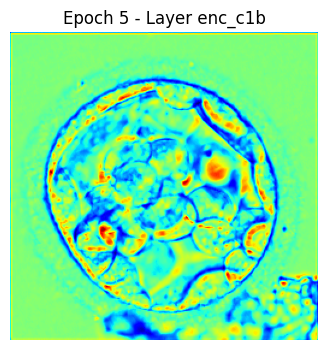

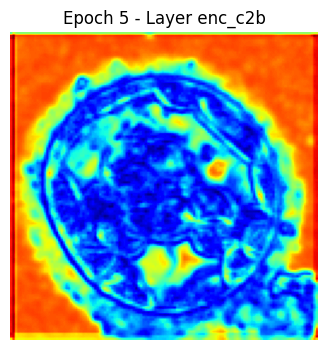

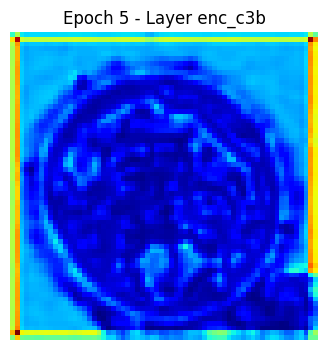

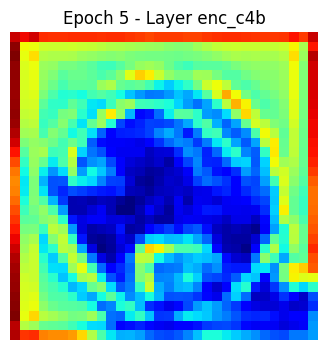

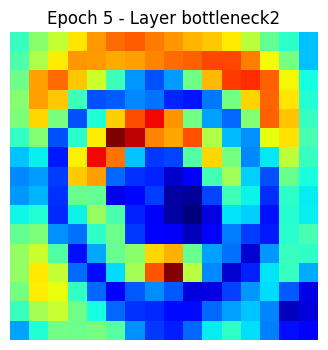

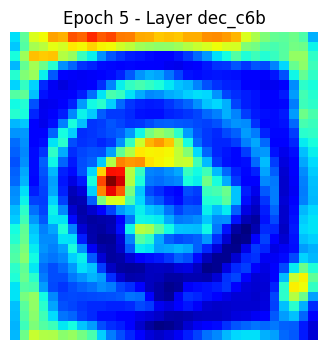

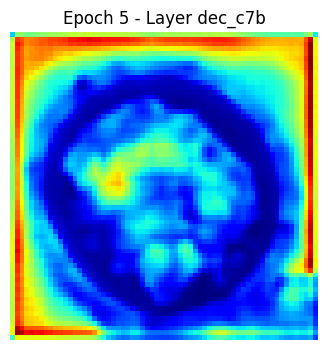

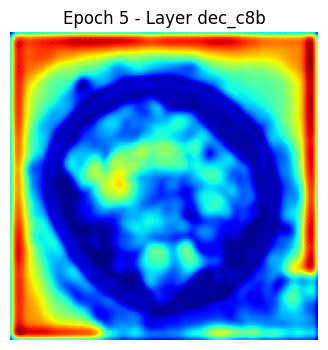

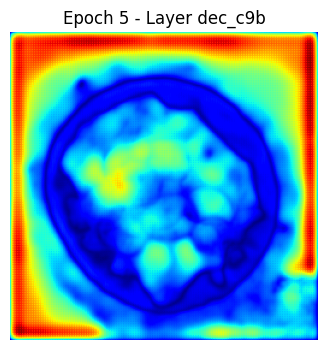

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8465 - dice_coefficient: 0.7401 - iou_metric: 0.5887 - loss: 0.4097 - val_accuracy: 0.8572 - val_dice_coefficient: 0.7449 - val_iou_metric: 0.5952 - val_loss: 0.3852
Epoch 6/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8493 - dice_coefficient: 0.7698 - iou_metric: 0.6264 - loss: 0.3670 - val_accuracy: 0.8643 - val_dice_coefficient: 0.7419 - val_iou_metric: 0.5917 - val_loss: 0.3881
Epoch 7/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8515 - dice_coefficient: 0.7799 - iou_metric: 0.6402 - loss: 0.3510 - val_accuracy: 0.8614 - val_dice_coefficient: 0.7173 - val_iou_metric: 0.5609 - val_loss: 0.4009
Epoch 8/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8524 - dice_coefficient: 0.7859 - iou_metric: 0.6484 - loss: 0.3403 - val_accuracy: 0.8597 - val_dice_coefficient: 0.7444 - val_iou_metric: 0.5947 - val_loss: 0.3789
Epoch 9/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 

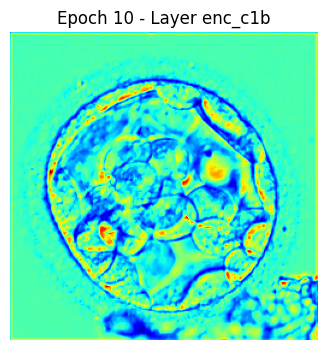

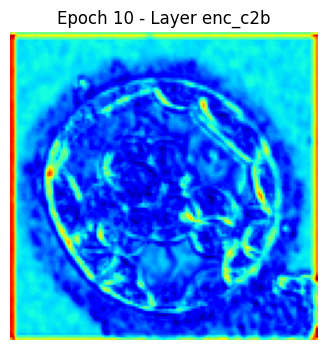

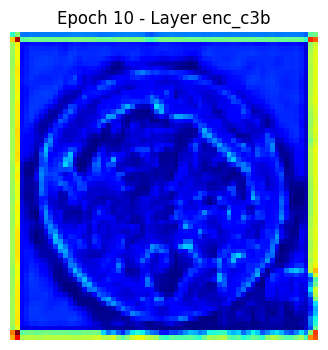

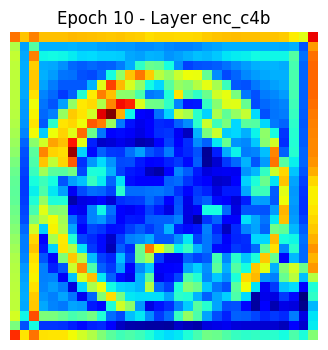

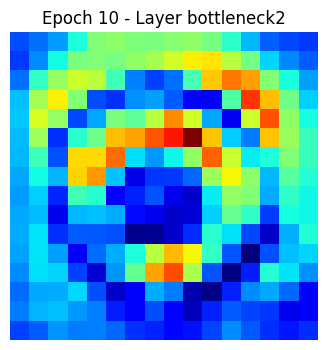

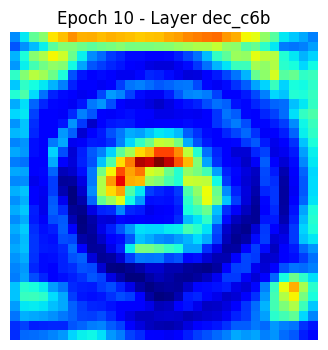

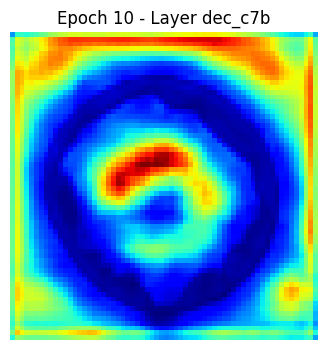

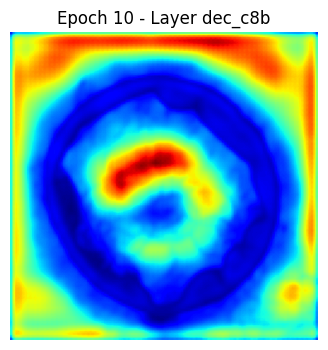

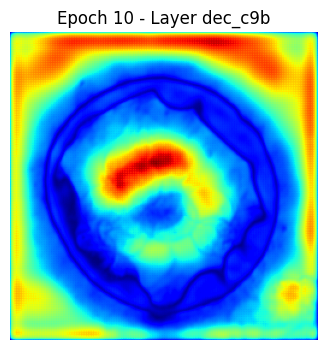

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8540 - dice_coefficient: 0.8080 - iou_metric: 0.6792 - loss: 0.3087 - val_accuracy: 0.8597 - val_dice_coefficient: 0.7947 - val_iou_metric: 0.6616 - val_loss: 0.3302
Epoch 11/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8556 - dice_coefficient: 0.8219 - iou_metric: 0.6983 - loss: 0.2869 - val_accuracy: 0.8625 - val_dice_coefficient: 0.7868 - val_iou_metric: 0.6507 - val_loss: 0.3313
Epoch 12/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8577 - dice_coefficient: 0.8282 - iou_metric: 0.7078 - loss: 0.2734 - val_accuracy: 0.8627 - val_dice_coefficient: 0.7919 - val_iou_metric: 0.6580 - val_loss: 0.3261
Epoch 13/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8587 - dice_coefficient: 0.8333 - iou_metric: 0.7153 - loss: 0.2661 - val_accuracy: 0.8571 - val_dice_coefficient: 0.8123 - val_iou_metric: 0.6866 - val_loss: 0.3242
Epoch 14/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

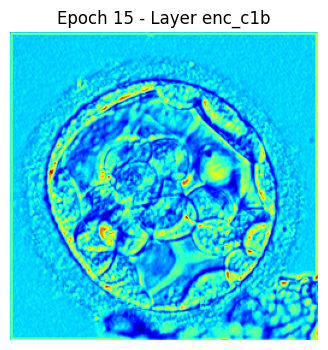

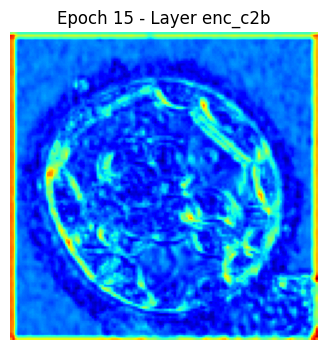

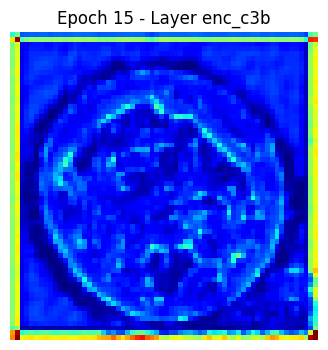

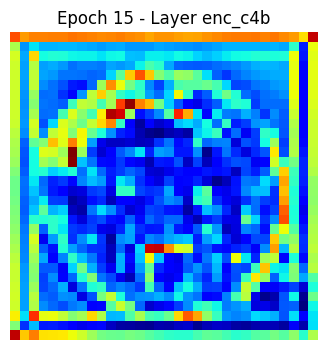

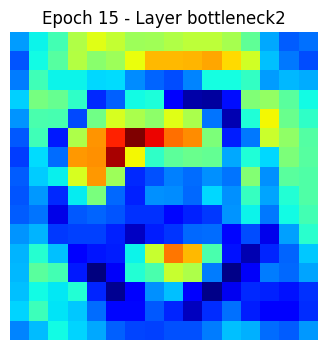

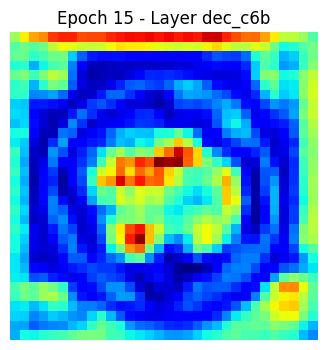

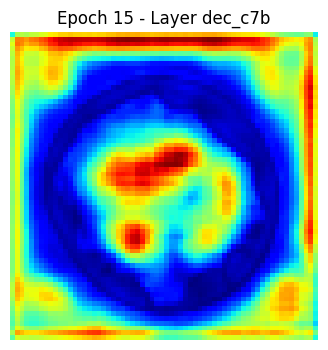

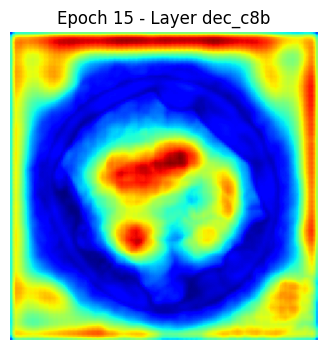

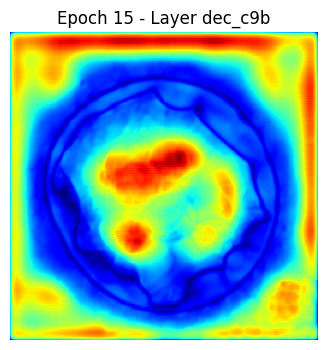

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8601 - dice_coefficient: 0.8447 - iou_metric: 0.7321 - loss: 0.2476 - val_accuracy: 0.8613 - val_dice_coefficient: 0.7924 - val_iou_metric: 0.6585 - val_loss: 0.3263
Epoch 16/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accuracy: 0.8605 - dice_coefficient: 0.8520 - iou_metric: 0.7430 - loss: 0.2372 - val_accuracy: 0.8578 - val_dice_coefficient: 0.7986 - val_iou_metric: 0.6670 - val_loss: 0.3246
Epoch 17/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8616 - dice_coefficient: 0.8599 - iou_metric: 0.7550 - loss: 0.2248 - val_accuracy: 0.8621 - val_dice_coefficient: 0.7863 - val_iou_metric: 0.6503 - val_loss: 0.3377
Epoch 18/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8616 - dice_coefficient: 0.8544 - iou_metric: 0.7468 - loss: 0.2321 - val_accuracy: 0.8646 - val_dice_coefficient: 0.7663 - val_iou_metric: 0.6235 - val_loss: 0.3548
Epoch 19/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 229ms/step - accura

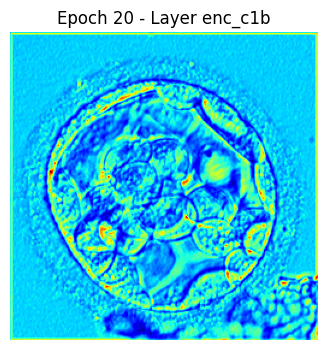

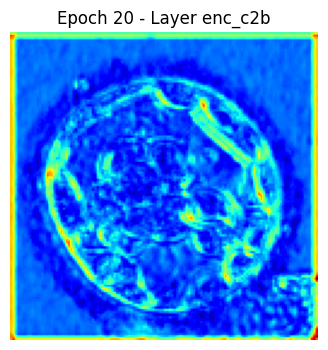

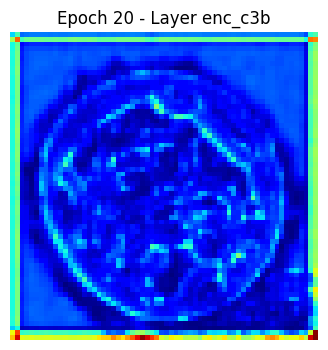

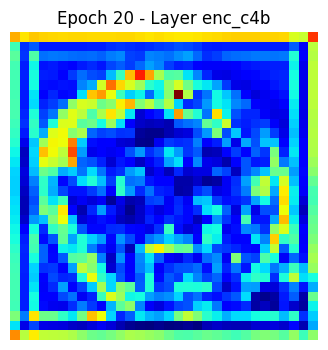

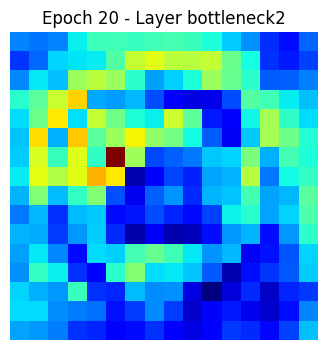

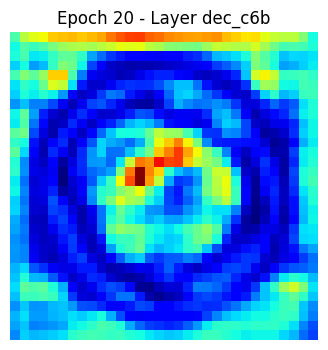

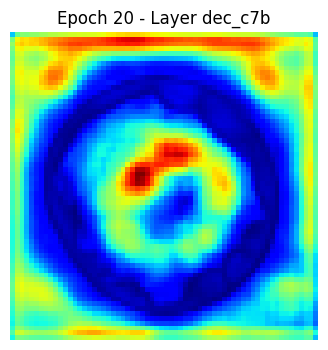

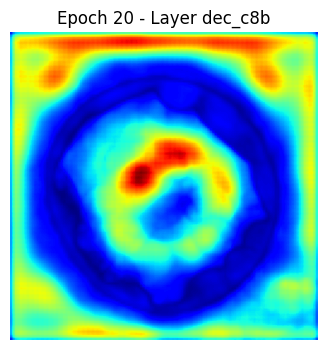

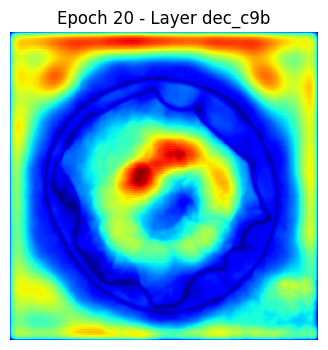

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8636 - dice_coefficient: 0.8764 - iou_metric: 0.7807 - loss: 0.2001 - val_accuracy: 0.8643 - val_dice_coefficient: 0.8140 - val_iou_metric: 0.6891 - val_loss: 0.3146
Epoch 21/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8645 - dice_coefficient: 0.8834 - iou_metric: 0.7918 - loss: 0.1882 - val_accuracy: 0.8628 - val_dice_coefficient: 0.7954 - val_iou_metric: 0.6628 - val_loss: 0.3244
Epoch 22/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8652 - dice_coefficient: 0.8827 - iou_metric: 0.7909 - loss: 0.1875 - val_accuracy: 0.8664 - val_dice_coefficient: 0.8215 - val_iou_metric: 0.7001 - val_loss: 0.3084
Epoch 23/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8655 - dice_coefficient: 0.8939 - iou_metric: 0.8088 - loss: 0.1709 - val_accuracy: 0.8691 - val_dice_coefficient: 0.7765 - val_iou_metric: 0.6376 - val_loss: 0.3482
Epoch 24/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

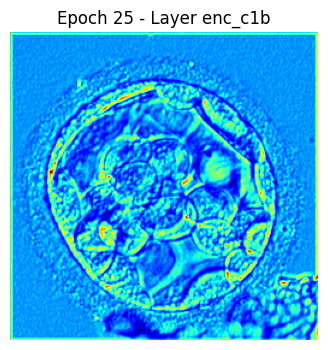

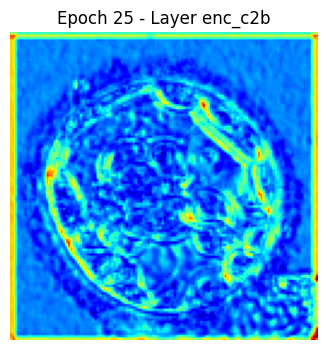

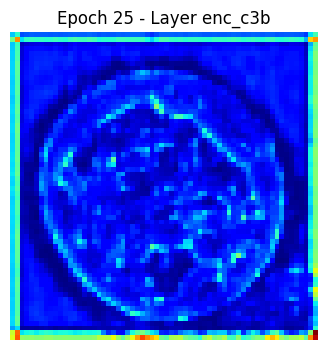

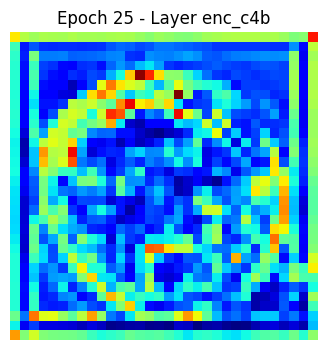

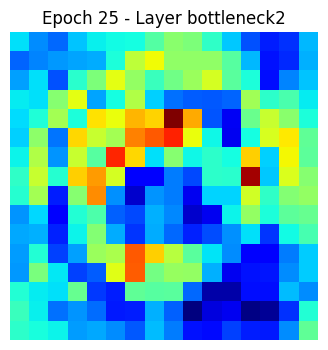

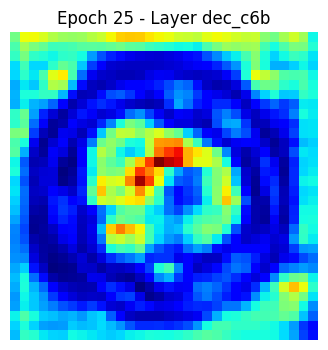

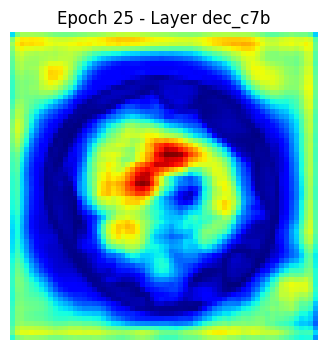

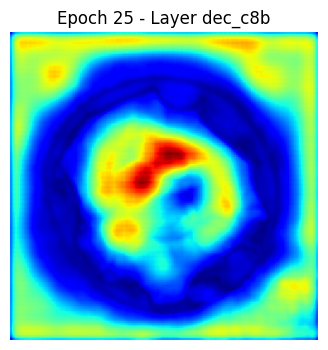

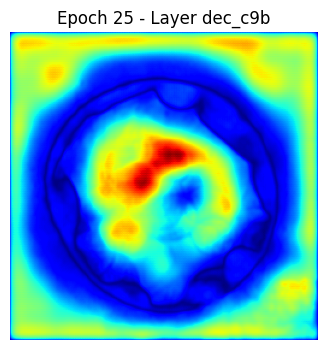

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 236ms/step - accuracy: 0.8671 - dice_coefficient: 0.8991 - iou_metric: 0.8173 - loss: 0.1626 - val_accuracy: 0.8670 - val_dice_coefficient: 0.8064 - val_iou_metric: 0.6785 - val_loss: 0.3314
Epoch 26/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 228ms/step - accuracy: 0.8673 - dice_coefficient: 0.9040 - iou_metric: 0.8253 - loss: 0.1540 - val_accuracy: 0.8658 - val_dice_coefficient: 0.8055 - val_iou_metric: 0.6776 - val_loss: 0.3447
Epoch 27/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8685 - dice_coefficient: 0.9061 - iou_metric: 0.8288 - loss: 0.1497 - val_accuracy: 0.8692 - val_dice_coefficient: 0.8012 - val_iou_metric: 0.6712 - val_loss: 0.3364
Epoch 28/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8673 - dice_coefficient: 0.9035 - iou_metric: 0.8245 - loss: 0.1535 - val_accuracy: 0.8657 - val_dice_coefficient: 0.8160 - val_iou_metric: 0.6924 - val_loss: 0.3346
Epoch 29/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accura

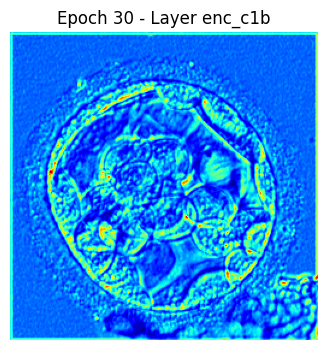

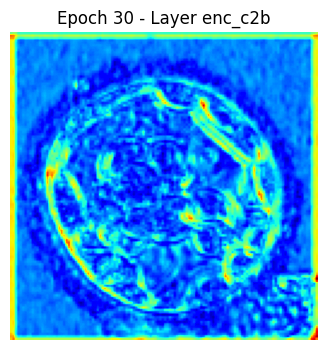

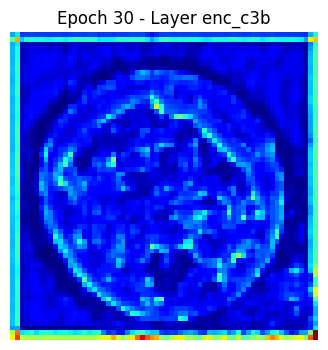

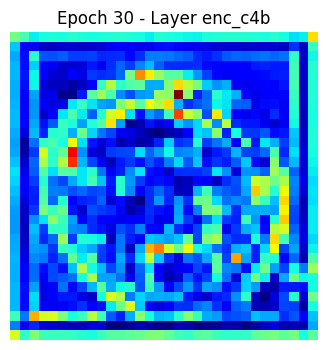

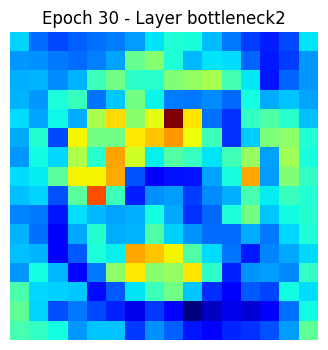

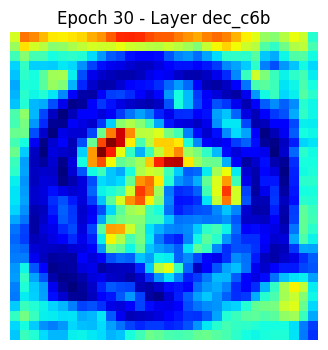

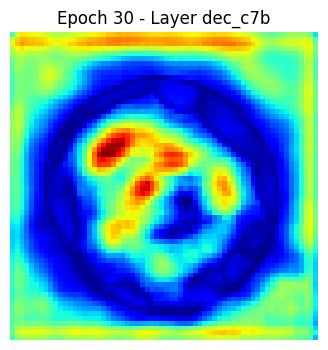

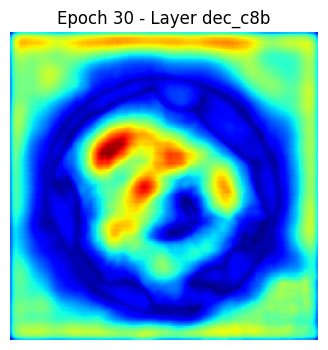

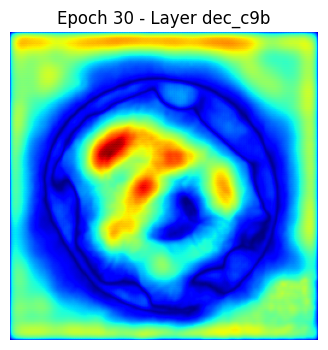

100/100 ━━━━━━━━━━━━━━━━━━━━ 24s 235ms/step - accuracy: 0.8676 - dice_coefficient: 0.9067 - iou_metric: 0.8299 - loss: 0.1493 - val_accuracy: 0.8607 - val_dice_coefficient: 0.8004 - val_iou_metric: 0.6704 - val_loss: 0.3659
Epoch 31/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8687 - dice_coefficient: 0.9155 - iou_metric: 0.8445 - loss: 0.1348 - val_accuracy: 0.8648 - val_dice_coefficient: 0.8087 - val_iou_metric: 0.6820 - val_loss: 0.3504
Epoch 32/300
100/100 ━━━━━━━━━━━━━━━━━━━━ 23s 227ms/step - accuracy: 0.8697 - dice_coefficient: 0.9211 - iou_metric: 0.8540 - loss: 0.1243 - val_accuracy: 0.8632 - val_dice_coefficient: 0.8173 - val_iou_metric: 0.6942 - val_loss: 0.3491


Model: "UNet_with_SCAB"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1a (Conv2D)    │ (None, 256, 256,  │        640 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c1b (Conv2D)    │ (None, 256, 256,  │     36,928 │ enc_c1a[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, 128, 128,  │          0 │ enc_c1b[0][0]     │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2a (Conv2D)    │ (None, 128, 128,  │     73,856 │ pool1[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c2b (Conv2D)    │ (None, 128, 128,  │    147,584 │ enc_c2a[0][0]     │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool2               │ (None, 64, 64,    │          0 │ enc_c2b[0][0]     │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3a (Conv2D)    │ (None, 64, 64,    │    295,168 │ pool2[0][0]       │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c3b (Conv2D)    │ (None, 64, 64,    │    590,080 │ enc_c3a[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool3               │ (None, 32, 32,    │          0 │ enc_c3b[0][0]     │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4a (Conv2D)    │ (None, 32, 32,    │  1,180,160 │ pool3[0][0]       │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ enc_c4b (Conv2D)    │ (None, 32, 32,    │  2,359,808 │ enc_c4a[0][0]     │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool4               │ (None, 16, 16,    │          0 │ enc_c4b[0][0]     │
│ (MaxPooling2D)      │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck1         │ (None, 16, 16,    │  4,719,616 │ pool4[0][0]       │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bottleneck2         │ (None, 16, 16,    │  9,438,208 │ bottleneck1[0][0] │
│ (Conv2D)            │ 1024)             │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ SCAB                │ [(None, 256, 256, │     10,415 │ enc_c1b[0][0],    │
│ (SCAttentionBridge) │ 64), (None, 128,  │            │ enc_c2b[0][0],    │
│                     │ 128, 128), (None, │            │ enc_c3b[0][0],    │
│                     │ 64, 64, 256),     │            │ enc_c4b[0][0],  

 Total params: 93,123,026 (355.24 MB)

 Trainable params: 31,041,008 (118.41 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 62,082,018 (236.82 MB)

GFLOPs calculation not available, use tensorflow profiler for exact computation.
Training time for fold 5: 769.87s


In [23]:
# -------------------------
# Training loop with K-Fold
# -------------------------
EPOCHS = 300
BATCH_SIZE = 8

early_stopping = EarlyStopping(
    monitor='val_dice_coefficient',
    patience=10,
    mode='max',
    restore_best_weights=True
)

checkpoint = ModelCheckpoint(
    "best_model.h5",
    monitor='val_dice_coefficient',
    save_best_only=True,
    mode='max'
)

image_paths = np.array(sorted(glob.glob(os.path.join(TRAIN_IMAGES_DIR, "*.bmp"))))
mask_paths  = np.array(sorted(glob.glob(os.path.join(TRAIN_MASKS_DIR, "*.bmp"))))

kfold = KFold(n_splits=5, shuffle=True, random_state=42)
fold_num = 1

for train_idx, val_idx in kfold.split(image_paths):
    print(f"\n--- Fold {fold_num} ---")

    train_images, train_masks = image_paths[train_idx], mask_paths[train_idx]
    val_images, val_masks = image_paths[val_idx], mask_paths[val_idx]

    # -------------------------
    # Dataset creation
    # -------------------------
    def dataset_from_paths(images, masks, shuffle=True):
        dataset = tf.data.Dataset.from_tensor_slices((images, masks))
        dataset = dataset.map(load_image, num_parallel_calls=tf.data.AUTOTUNE)
        if shuffle:
            dataset = dataset.shuffle(100)
        return dataset.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

    train_dataset = dataset_from_paths(train_images, train_masks)
    val_dataset = dataset_from_paths(val_images, val_masks, shuffle=False)
        # -------------------------
    # Build model
    # -------------------------
    model = unet_with_sc_attention(input_shape=(256,256,1))
    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
        loss=bce_dice_loss,
        metrics=['accuracy', dice_coefficient, iou_metric]
    )
        # -------------------------
    # Feature extractor for attention visualization
    # -------------------------
    layer_names = [
       'enc_c1b', 'enc_c2b', 'enc_c3b', 'enc_c4b', 'bottleneck2',
       'dec_c6b', 'dec_c7b', 'dec_c8b', 'dec_c9b'
    ]
    intermediate_outputs = [model.get_layer(name).output for name in layer_names]
    feature_model = tf.keras.Model(inputs=model.input, outputs=intermediate_outputs)

    # Sample image for attention visualization
    sample_image = load_only_image(val_images[0])
    sample_image = tf.expand_dims(sample_image, axis=0)  # Add batch dimension
        # -------------------------
    # Custom callback for attention maps
    # -------------------------
    class AttentionMapLogger(tf.keras.callbacks.Callback):
        def __init__(self, sample_image, every_n_epochs=5):
            super().__init__()
            self.sample_image = sample_image
            self.every_n_epochs = every_n_epochs

        def on_epoch_end(self, epoch, logs=None):
            if (epoch + 1) % self.every_n_epochs == 0:
                attention_features = feature_model(self.sample_image, training=False)
                for i, fmap in enumerate(attention_features):
                    fmap_mean = tf.reduce_mean(fmap, axis=-1)  # average over channels
                    fmap_img = tf.squeeze(fmap_mean).numpy()
                    plt.figure(figsize=(4,4))
                    plt.imshow(fmap_img, cmap='jet')
                    plt.title(f"Epoch {epoch+1} - Layer {layer_names[i]}")
                    plt.axis('off')
                    plt.show()

    attention_logger = AttentionMapLogger(sample_image, every_n_epochs=5)

    # -------------------------
    # Train
    # -------------------------
    start_time = time.time()
    history = model.fit(
        train_dataset,
        validation_data=val_dataset,
        epochs=EPOCHS,
        callbacks=[early_stopping, checkpoint, attention_logger]
    )
    end_time = time.time()
        # -------------------------
    # Model summary, GFLOPs, training time
    # -------------------------
    model.summary()
    try:
        from tensorflow.python.profiler import model_analyzer
        from tensorflow.python.profiler.option_builder import ProfileOptionBuilder
        profile = model_analyzer.profile(
            model, options=ProfileOptionBuilder.float_operation()
        )
        print(f"GFLOPs: {profile.total_float_ops / 1e9}")
    except:
        print("GFLOPs calculation not available, use tensorflow profiler for exact computation.")

    print(f"Training time for fold {fold_num}: {end_time - start_time:.2f}s")
    fold_num += 1




In [25]:
# -------------------------
# Load best model
# -------------------------
model = unet_with_sc_attention(input_shape=(256, 256, 1))
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
              loss=bce_dice_loss,
              metrics=['accuracy', dice_coefficient, iou_metric])

model.load_weights("best_model.h5")


# -------------------------
# Evaluate on test set
# -------------------------
results = model.evaluate(test_dataset)
print("\nTest Results:")
for name, value in zip(model.metrics_names, results):
    print(f"{name}: {value:.4f}")

25/25 ━━━━━━━━━━━━━━━━━━━━ 5s 15ms/step - accuracy: 0.9629 - dice_coefficient: 0.8468 - iou_metric: 0.7372 - loss: 0.4894

Test Results:
loss: 0.4105
compile_metrics: 0.9678


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


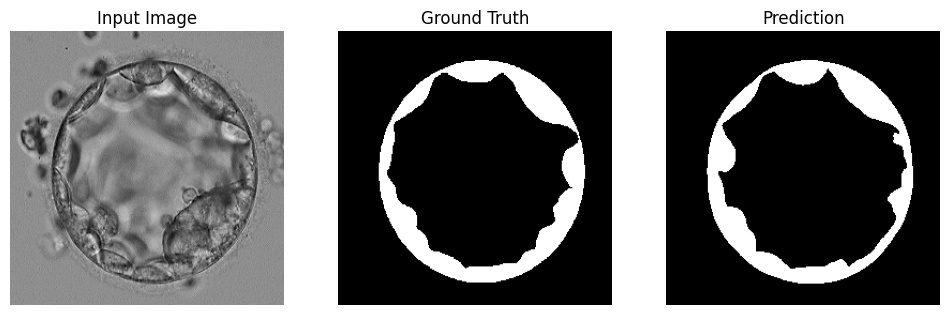

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


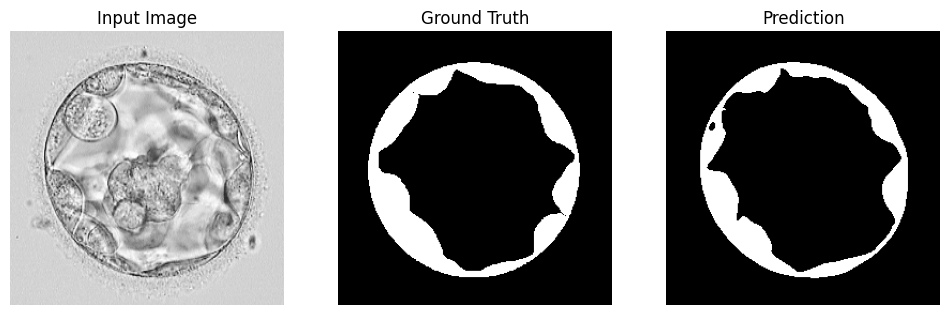

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


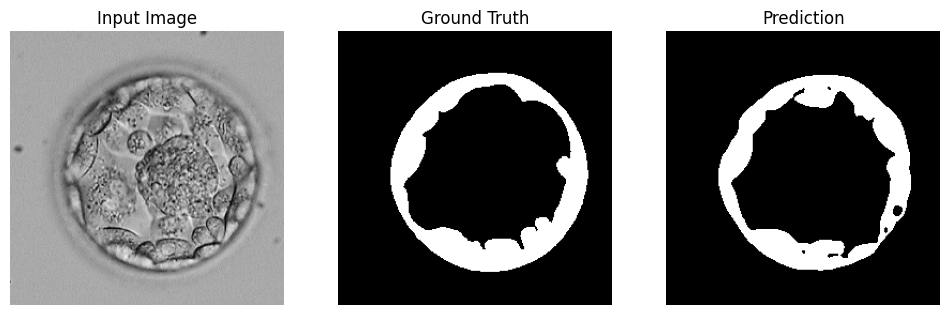

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


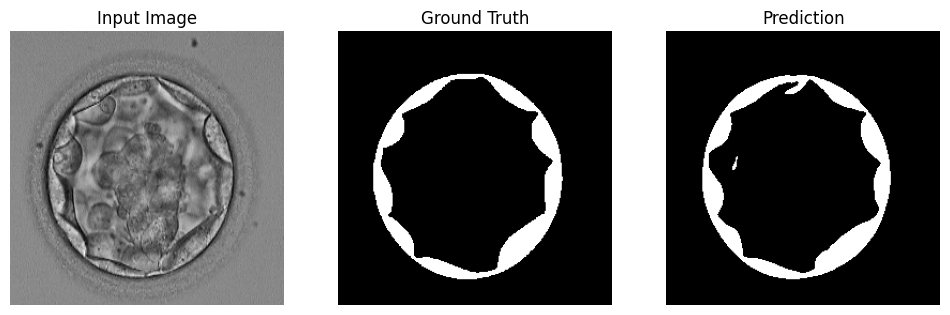

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


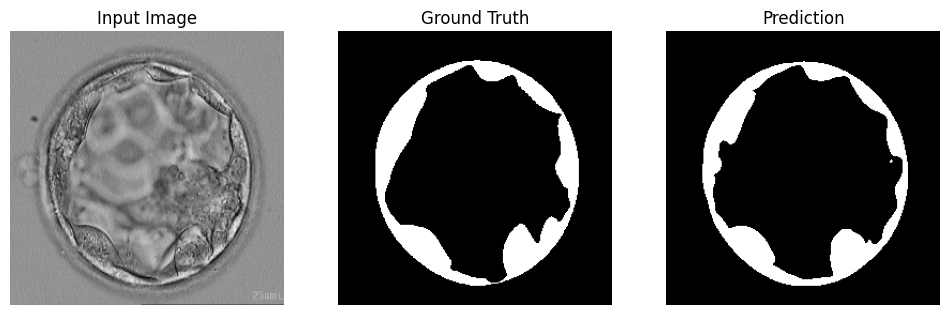

In [26]:
def display_predictions(model, dataset, num_samples=5):
    for batch_idx, (images, masks) in enumerate(dataset.take(num_samples)):
        preds = model.predict(images)
        preds = (preds > 0.5).astype("float32")  # Binarize predictions

        for i in range(len(images)):
            plt.figure(figsize=(12, 4))

            plt.subplot(1, 3, 1)
            plt.title("Input Image")
            plt.imshow(images[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 2)
            plt.title("Ground Truth")
            plt.imshow(masks[i].numpy().squeeze(), cmap="gray")
            plt.axis("off")

            plt.subplot(1, 3, 3)
            plt.title("Prediction")
            plt.imshow(preds[i].squeeze(), cmap="gray")
            plt.axis("off")

            plt.show()


display_predictions(model, test_dataset, num_samples=5)